# Import modules

In [ ]:
!pip install segmentation_models

In [12]:
import glob
import os
import random
from random import shuffle
import shutil
from pathlib import Path
import warnings

import albumentations as A
import cv2
import matplotlib.pyplot as plt
import numpy as np
from osgeo import gdal
import pandas as pd
import rasterio
import segmentation_models as sm
from sklearn.model_selection import *
from sklearn.metrics import jaccard_score
from sklearn.model_selection import StratifiedKFold
import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.models import *
from tensorflow.keras.preprocessing.image import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.applications.efficientnet import *
from tqdm import tqdm

tf.config.list_physical_devices('GPU')
sm.set_framework('tf.keras')
sm.framework()
warnings.filterwarnings('ignore')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [19]:
metadata = Path.cwd().parent / "training_data" / "flood-training-metadata.csv"
train_features = Path.cwd().parent / "training_data" / "train_features"
train_labels = Path.cwd().parent / "training_data" / "train_labels"

# Load data

In [20]:
meta = pd.read_csv(metadata)
meta = meta.drop_duplicates('chip_id').reset_index(drop=True)

In [21]:
filenames = [x.split('.')[0] for x in os.listdir(train_labels)]

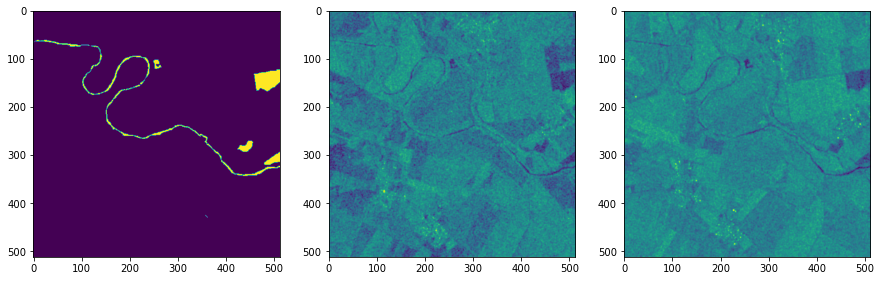

In [22]:
fn = filenames[4]

for fn in filenames[17:18]:
    
    with rasterio.open(train_features / '{}_vv.tif'.format(fn)) as fvv:
        vv = fvv.read(1)
    with rasterio.open(train_features / '{}_vh.tif'.format(fn)) as fvh:
        vh = fvh.read(1)
    with rasterio.open(train_labels / '{}.tif'.format(fn)) as fmask:
        mask = fmask.read(1)
        
    _, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(mask)
    ax[1].imshow(vh)
    ax[2].imshow(vv)
    plt.show()

# Data Generator

## Functions

The value 255 means empty zones in the photo. I convert them to zeros.

In [23]:
def process_mask(mask):
    mask_temp = mask.copy()
    mask_temp[mask == 255] = 0
    return mask_temp

I didn't use any complicated augmentations so as not to damage the image.

In [24]:
def augment_image(image, mask):

    aug = A.Compose([
        
        A.RandomResizedCrop(512, 512, scale=(0.75, 1.0), p=0.5),
        A.VerticalFlip(p=0.5),
        A.HorizontalFlip(p=0.5),
        A.RandomRotate90(p=0.5),
        A.Blur(p=0.5),
    
    ])

    augmented = aug(image=image, mask=mask)

    return augmented['image'], augmented['mask']

The DataGenerator implies the possibility of using several combinations of image channels. Scaling of each band is performed according to the formula 


(X - band_mean) / band_std


band_mean - mean value of band on all images


band_std - std value of band on all images

In [25]:
class CustomDataGen(tf.keras.utils.Sequence):
    
    def __init__(self, paths,
                 augment=True,
                 batch_size=16,
                 input_shape=512,
                 shuffle=True,
                 channels=2):
        
        self.channels = channels
        self.paths = paths
        self.augment = augment
        self.batch_size = batch_size
        self.input_shape = input_shape
        self.shuffle = shuffle
        self.n = len(self.paths)
        self.on_epoch_end()
        
    
    def on_epoch_end(self):
        
        self.indexes = np.arange(len(self.paths))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    
    def __load_data(self, paths):
    
        X_batch = []
        y_batch = []
        
        for path in paths:

            with rasterio.open(train_features / '{}_vv.tif'.format(path)) as fvv:
                vv = fvv.read(1)
            with rasterio.open(train_features / '{}_vh.tif'.format(path)) as fvh:
                vh = fvh.read(1)
            
            with rasterio.open(train_features / '{}_nasadem.tif'.format(path)) as nasadem_:
                nasadem = nasadem_.read(1)
            with rasterio.open(train_features / '{}_jrc-gsw-change.tif'.format(path)) as jrc_gsw_change_:
                jrc_gsw_change = jrc_gsw_change_.read(1)
            with rasterio.open(train_features / '{}_jrc-gsw-extent.tif'.format(path)) as jrc_gsw_extent_:
                jrc_gsw_extent = jrc_gsw_extent_.read(1)
            with rasterio.open(train_features / '{}_jrc-gsw-occurrence.tif'.format(path)) as jrc_gsw_occurrence_:
                jrc_gsw_occurrence = jrc_gsw_occurrence_.read(1)
            with rasterio.open(train_features / '{}_jrc-gsw-recurrence.tif'.format(path)) as jrc_gsw_recurrence_:
                jrc_gsw_recurrence = jrc_gsw_recurrence_.read(1)
            with rasterio.open(train_features / '{}_jrc-gsw-seasonality.tif'.format(path)) as jrc_gsw_seasonality_:
                jrc_gsw_seasonality = jrc_gsw_seasonality_.read(1)
            with rasterio.open(train_features / '{}_jrc-gsw-transitions.tif'.format(path)) as jrc_gsw_transitions_:
                jrc_gsw_transitions = jrc_gsw_transitions_.read(1)
            
            with rasterio.open(train_labels / '{}.tif'.format(path)) as fmask:
                mask = process_mask(fmask.read(1))
            
            if self.channels == 2:
                X = np.zeros((512, 512, 2))
                X[:, :, 0] = (vh - (-17.54)) / 5.15
                X[:, :, 1] = (vv - (-10.68)) / 4.62
                
            elif self.channels == 3:
                X = np.zeros((512, 512, 3))
                X[:, :, 0] = (vh - (-17.54)) / 5.15
                X[:, :, 1] = (vv - (-10.68)) / 4.62
                X[:, :, 2] = (nasadem - (166.47)) / 178.47
                
            elif self.channels == 9:
                X = np.zeros((512, 512, 9))
                X[:, :, 0] = (vh - (-17.54)) / 5.15
                X[:, :, 1] = (vv - (-10.68)) / 4.62
                X[:, :, 2] = (nasadem - (166.47)) / 178.47
                X[:, :, 3] = (jrc_gsw_change - 238.76) / 45.45
                X[:, :, 4] = (jrc_gsw_occurrence - 6.50) / 29.06
                X[:, :, 5] = (jrc_gsw_extent - 2.15) / 22.71
                X[:, :, 6] = (jrc_gsw_recurrence - 10.04) / 33.21
                X[:, :, 7] = (jrc_gsw_seasonality - 2.60) / 22.79
                X[:, :, 8] = (jrc_gsw_transitions - 0.55) / 1.94
            
            y = mask.copy()
            
            if self.augment:
                X, y = augment_image(X, mask)
                
            X_batch.append(X)
            y_batch.append(y)
            
        return np.array(X_batch, dtype=float), np.array(y_batch, dtype=float)
    
    
    def __getitem__(self, index):
        
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]
        X, y = self.__load_data([self.paths[i] for i in indexes])        
        
        return X, y
    
    
    def __len__(self):
        
        return int(np.floor(len(self.paths) / self.batch_size))

## Viewing data

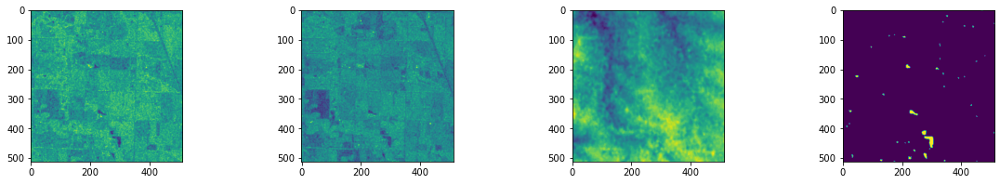

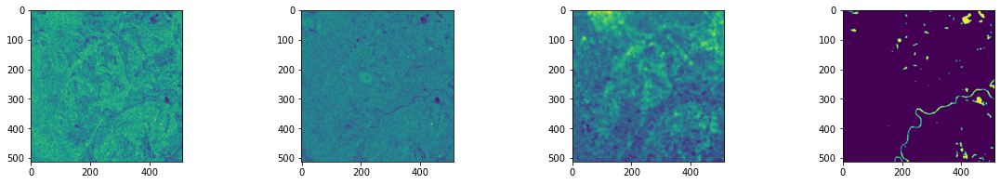

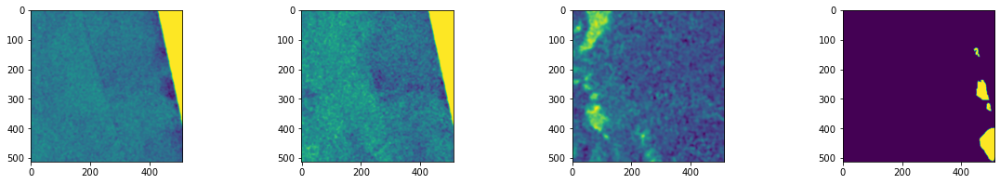

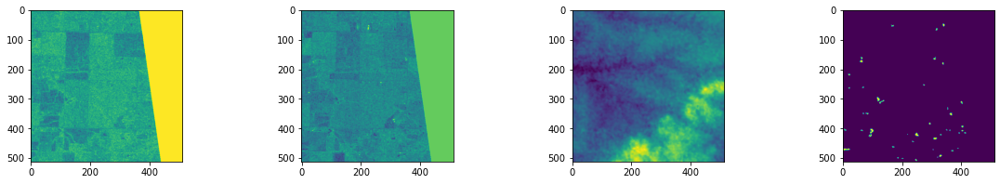

In [26]:
traingen = CustomDataGen(filenames, channels=3, input_shape=512, batch_size=4)

for x, y in traingen:
    break

i = 0
    
for xx, yy in zip(x, y):

    _, ax = plt.subplots(1, 4, figsize=(20, 3))
    for i in range(3):
        ax[i].imshow(xx[:, :, i])
    ax[3].imshow(yy)
    plt.show()

# Model

## Functions

In [38]:
def plot_preds(epoch, logs):
    
    path = val_filenames[0]
    
    with rasterio.open(train_features / '{}_vv.tif'.format(path)) as fvv:
        vv = fvv.read(1)
    with rasterio.open(train_features / '{}_vh.tif'.format(path)) as fvh:
        vh = fvh.read(1)
    
    with rasterio.open(train_features / '{}_nasadem.tif'.format(path)) as nasadem_:
        nasadem = nasadem_.read(1)
    with rasterio.open(train_features / '{}_jrc-gsw-change.tif'.format(path)) as jrc_gsw_change_:
        jrc_gsw_change = jrc_gsw_change_.read(1)
    with rasterio.open(train_features / '{}_jrc-gsw-extent.tif'.format(path)) as jrc_gsw_extent_:
        jrc_gsw_extent = jrc_gsw_extent_.read(1)
    with rasterio.open(train_features / '{}_jrc-gsw-occurrence.tif'.format(path)) as jrc_gsw_occurrence_:
        jrc_gsw_occurrence = jrc_gsw_occurrence_.read(1)
    with rasterio.open(train_features / '{}_jrc-gsw-recurrence.tif'.format(path)) as jrc_gsw_recurrence_:
        jrc_gsw_recurrence = jrc_gsw_recurrence_.read(1)
    with rasterio.open(train_features / '{}_jrc-gsw-seasonality.tif'.format(path)) as jrc_gsw_seasonality_:
        jrc_gsw_seasonality = jrc_gsw_seasonality_.read(1)
    with rasterio.open(train_features / '{}_jrc-gsw-transitions.tif'.format(path)) as jrc_gsw_transitions_:
        jrc_gsw_transitions = jrc_gsw_transitions_.read(1)
                
    mask = process_mask(gdal.Open(str(train_labels / '{}.tif'.format(path))).ReadAsArray())
    
    if N_CHANNELS == 2:
        X = np.zeros((INP_SHAPE, INP_SHAPE, 2))
        X[:, :, 0] = (vh - (-17.54)) / 5.15
        X[:, :, 1] = (vv - (-10.68)) / 4.62
        
    elif N_CHANNELS == 3:
        X = np.zeros((INP_SHAPE, INP_SHAPE, 3))
        X[:, :, 0] = (vh - (-17.54)) / 5.15
        X[:, :, 1] = (vv - (-10.68)) / 4.62
        X[:, :, 2] = (nasadem - (166.47)) / 178.47
        
    elif N_CHANNELS == 9:
        X = np.zeros((INP_SHAPE, INP_SHAPE, 9))
        X[:, :, 0] = (vh - (-17.54)) / 5.15
        X[:, :, 1] = (vv - (-10.68)) / 4.62
        X[:, :, 2] = (nasadem - (166.47)) / 178.47
        X[:, :, 3] = (jrc_gsw_change - 238.76) / 45.45
        X[:, :, 4] = (jrc_gsw_occurrence - 6.50) / 29.06
        X[:, :, 5] = (jrc_gsw_extent - 2.15) / 22.71
        X[:, :, 6] = (jrc_gsw_recurrence - 10.04) / 33.21
        X[:, :, 7] = (jrc_gsw_seasonality - 2.60) / 22.79
        X[:, :, 8] = (jrc_gsw_transitions - 0.55) / 1.94
    
    prediction = model.predict(X[np.newaxis, ...])[0, :, :, 0]
    
    pred_thresh = prediction.copy()
    pred_thresh[pred_thresh > 0.5] = 1
    pred_thresh[pred_thresh <= 0.5] = 0
    pred_thresh = pred_thresh.astype(int)
    
    _, ax = plt.subplots(1, 4, figsize=(16, 4))
    ax[0].imshow(X[:, :, 0])
    ax[0].set_title('vh')
    ax[1].imshow(mask)
    ax[1].set_title('gt')
    ax[2].imshow(prediction)
    ax[2].set_title('pred')
    ax[3].imshow(pred_thresh)
    ax[3].set_title('thresh_pred')
    plt.suptitle(jaccard_score(mask.flatten(), pred_thresh.flatten()))
    plt.show()

In [39]:
def bce_jaccard_loss(y_true, y_pred, smooth=1):

    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    sum_ = K.sum(K.abs(y_true) + K.abs(y_pred), axis=-1)
    jac = (intersection + smooth) / (sum_ - intersection + smooth)
    
    return (1 - jac) * smooth + tf.keras.losses.binary_crossentropy(y_true, y_pred)

#Keras
ALPHA = 0.8
GAMMA = 2

def focal_bce_jaccard_loss(targets, inputs, alpha=ALPHA, gamma=GAMMA):    
    
    inputs = K.flatten(inputs)
    targets = K.flatten(targets)
    
    BCE = K.binary_crossentropy(targets, inputs)
    BCE_EXP = K.exp(-BCE)
    focal_loss = K.mean(alpha * K.pow((1-BCE_EXP), gamma) * BCE)
    
    return bce_jaccard_loss(targets, inputs) + focal_loss

## EfficientB0Unet model on 3 bands

In [40]:
INP_SHAPE = 512
N_CHANNELS = 3
BATCH_SIZE = 4

In [41]:
K.clear_session()

model = sm.Unet('efficientnetb0', input_shape=(INP_SHAPE, INP_SHAPE, N_CHANNELS), 
                encoder_weights=None, weights=None)

metrics = [
    'mae',
    'accuracy'
]

model.compile(optimizer=Adam(), 
              loss=bce_jaccard_loss,
              metrics=metrics)

In [42]:
Path("unet_models").mkdir(parents=True, exist_ok=True)

In [43]:
checkpoint_path = 'unet_models/EffUnetB0_{}_{}.h5'.format(INP_SHAPE, N_CHANNELS)
# checkpoint_dir = os.path.dirname(checkpoint_path)
# if os.path.exists(checkpoint_dir):
#         shutil.rmtree(checkpoint_dir)
# os.makedirs(checkpoint_dir)

callbacks = [
    EarlyStopping(patience=12, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.000001, verbose=1),
    ModelCheckpoint(filepath=checkpoint_path, verbose=1, save_best_only=True, save_weights_only=False),
    LambdaCallback(on_epoch_end=plot_preds)
]

In [44]:
train_filenames, val_filenames = train_test_split(meta.chip_id.values, stratify=meta.location, test_size=0.15)

train_datagen = CustomDataGen(train_filenames, channels=N_CHANNELS, 
                              input_shape=INP_SHAPE, batch_size=BATCH_SIZE)

val_datagen = CustomDataGen(val_filenames, channels=N_CHANNELS, input_shape=INP_SHAPE, 
                            batch_size=BATCH_SIZE, augment=False)

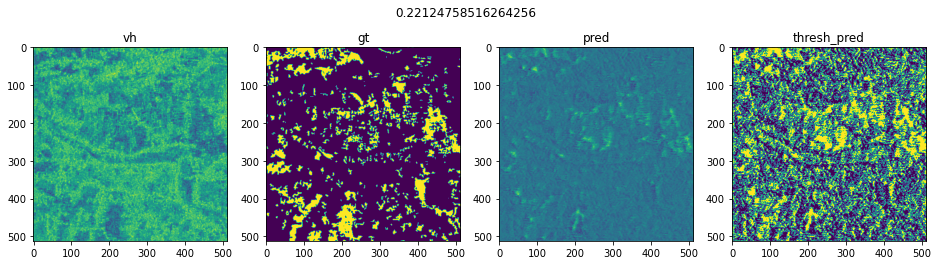

In [45]:
plot_preds(0, 0)

Epoch 1/100
115/115 [==============================] - 47s 354ms/step - loss: 1.3848 - mae: 0.3571 - accuracy: 0.7216 - val_loss: 1.6057 - val_mae: 0.1318 - val_accuracy: 0.8734

Epoch 00001: val_loss improved from inf to 1.60571, saving model to unet_models/EffUnetB0_512_3.h5


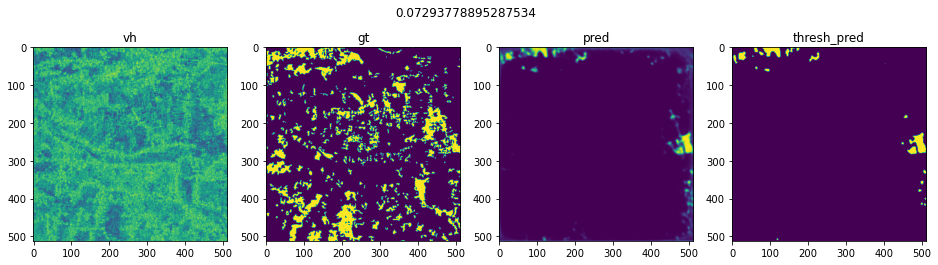

Epoch 2/100
115/115 [==============================] - 40s 348ms/step - loss: 0.9203 - mae: 0.1016 - accuracy: 0.9280 - val_loss: 0.7965 - val_mae: 0.0977 - val_accuracy: 0.9099

Epoch 00002: val_loss improved from 1.60571 to 0.79653, saving model to unet_models/EffUnetB0_512_3.h5


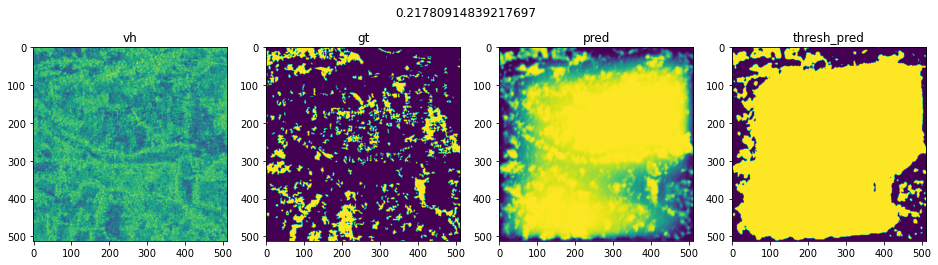

Epoch 3/100
115/115 [==============================] - 41s 352ms/step - loss: 0.7881 - mae: 0.0967 - accuracy: 0.9158 - val_loss: 0.5412 - val_mae: 0.0570 - val_accuracy: 0.9507

Epoch 00003: val_loss improved from 0.79653 to 0.54124, saving model to unet_models/EffUnetB0_512_3.h5


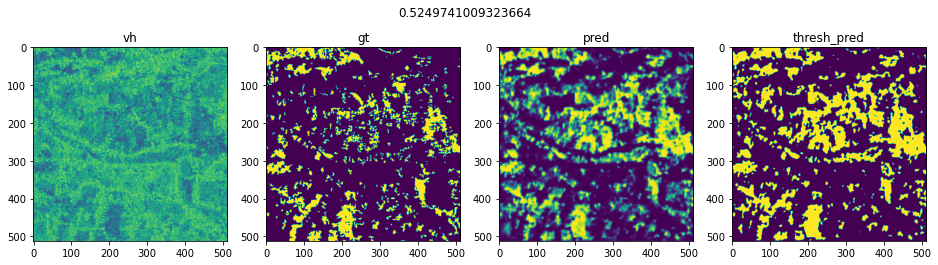

Epoch 4/100
115/115 [==============================] - 41s 355ms/step - loss: 0.7559 - mae: 0.0868 - accuracy: 0.9284 - val_loss: 0.7491 - val_mae: 0.1167 - val_accuracy: 0.8917

Epoch 00004: val_loss did not improve from 0.54124


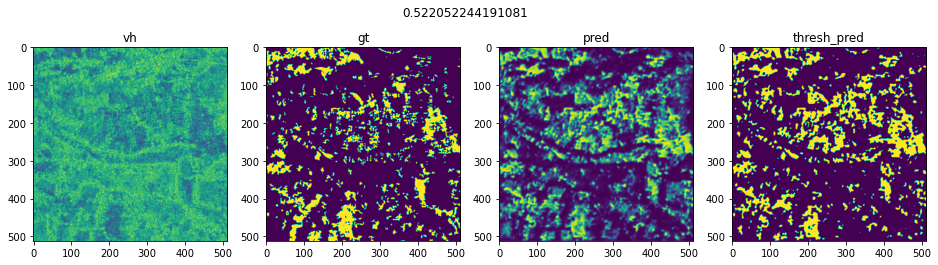

Epoch 5/100
115/115 [==============================] - 41s 357ms/step - loss: 0.7684 - mae: 0.0888 - accuracy: 0.9205 - val_loss: 1.2499 - val_mae: 0.1823 - val_accuracy: 0.8335

Epoch 00005: val_loss did not improve from 0.54124


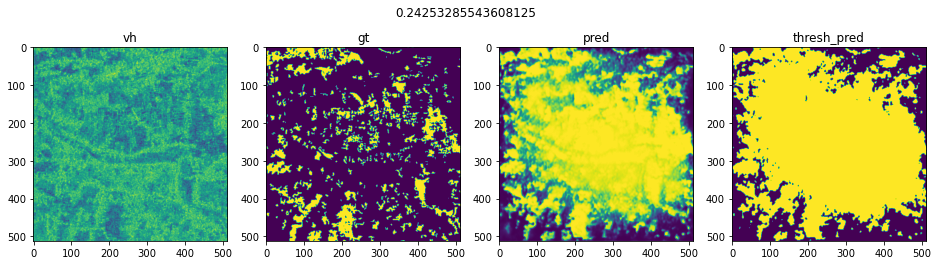

Epoch 6/100
115/115 [==============================] - 41s 360ms/step - loss: 0.6498 - mae: 0.0653 - accuracy: 0.9456 - val_loss: 1.2538 - val_mae: 0.1349 - val_accuracy: 0.8848

Epoch 00006: val_loss did not improve from 0.54124


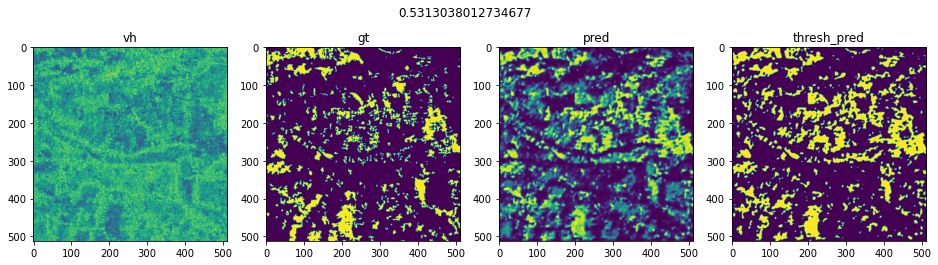

Epoch 7/100
115/115 [==============================] - 42s 360ms/step - loss: 0.7412 - mae: 0.0839 - accuracy: 0.9298 - val_loss: 0.7461 - val_mae: 0.0599 - val_accuracy: 0.9479

Epoch 00007: val_loss did not improve from 0.54124


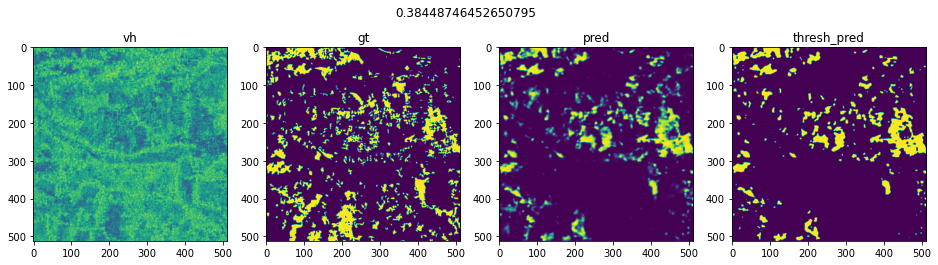

Epoch 8/100
115/115 [==============================] - 42s 361ms/step - loss: 0.7273 - mae: 0.0796 - accuracy: 0.9336 - val_loss: 0.5396 - val_mae: 0.0524 - val_accuracy: 0.9598

Epoch 00008: val_loss improved from 0.54124 to 0.53963, saving model to unet_models/EffUnetB0_512_3.h5


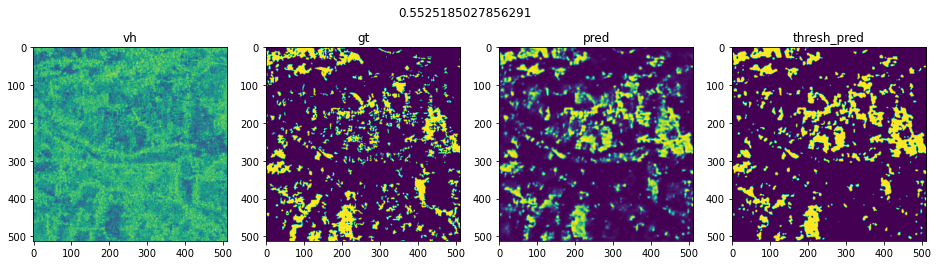

Epoch 9/100
115/115 [==============================] - 42s 361ms/step - loss: 0.7184 - mae: 0.0721 - accuracy: 0.9377 - val_loss: 0.5402 - val_mae: 0.0501 - val_accuracy: 0.9555

Epoch 00009: val_loss did not improve from 0.53963


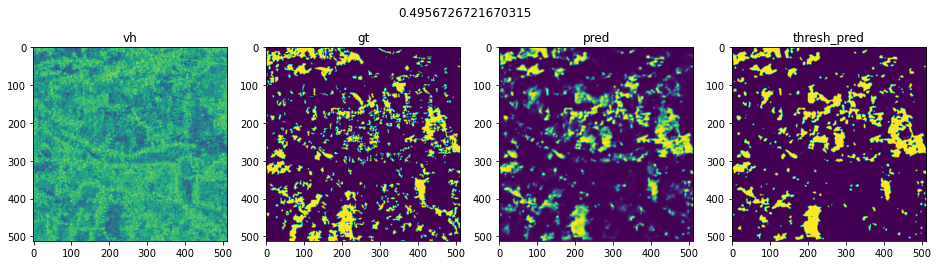

Epoch 10/100
115/115 [==============================] - 42s 360ms/step - loss: 0.6976 - mae: 0.0702 - accuracy: 0.9375 - val_loss: 0.6198 - val_mae: 0.0565 - val_accuracy: 0.9548

Epoch 00010: val_loss did not improve from 0.53963


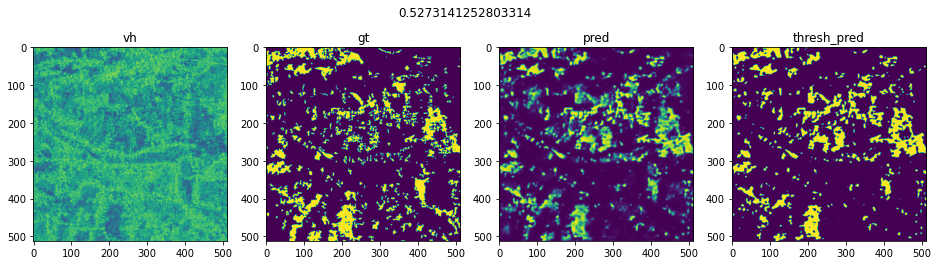

Epoch 11/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6703 - mae: 0.0714 - accuracy: 0.9388 - val_loss: 0.4716 - val_mae: 0.0373 - val_accuracy: 0.9656

Epoch 00011: val_loss improved from 0.53963 to 0.47161, saving model to unet_models/EffUnetB0_512_3.h5


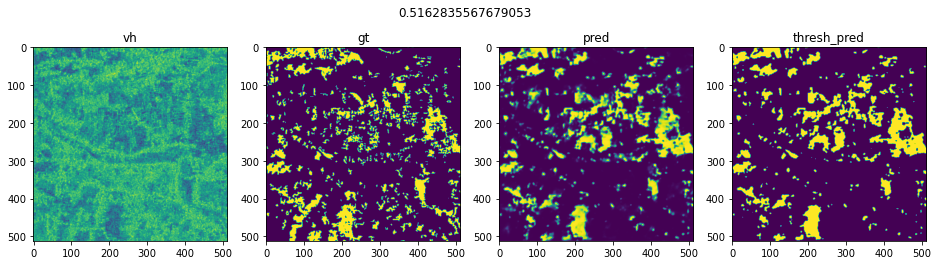

Epoch 12/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6255 - mae: 0.0602 - accuracy: 0.9477 - val_loss: 0.5201 - val_mae: 0.0596 - val_accuracy: 0.9593

Epoch 00012: val_loss did not improve from 0.47161


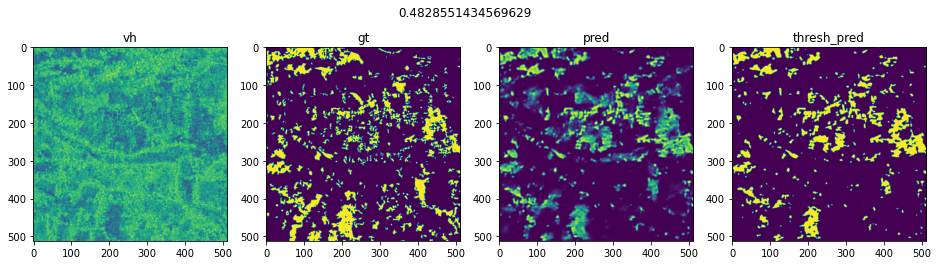

Epoch 13/100
115/115 [==============================] - 42s 361ms/step - loss: 0.7057 - mae: 0.0781 - accuracy: 0.9300 - val_loss: 0.5489 - val_mae: 0.0573 - val_accuracy: 0.9527

Epoch 00013: val_loss did not improve from 0.47161


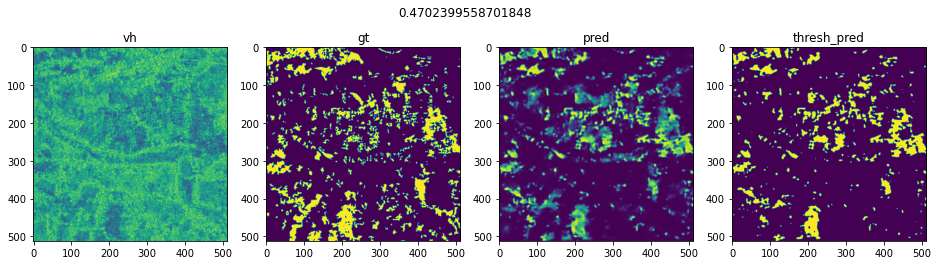

Epoch 14/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6587 - mae: 0.0700 - accuracy: 0.9369 - val_loss: 1.1606 - val_mae: 0.1429 - val_accuracy: 0.8601

Epoch 00014: val_loss did not improve from 0.47161


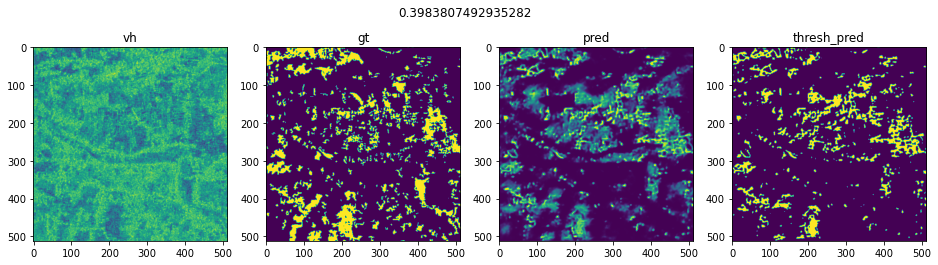

Epoch 15/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6103 - mae: 0.0597 - accuracy: 0.9492 - val_loss: 0.6507 - val_mae: 0.0820 - val_accuracy: 0.9321

Epoch 00015: val_loss did not improve from 0.47161


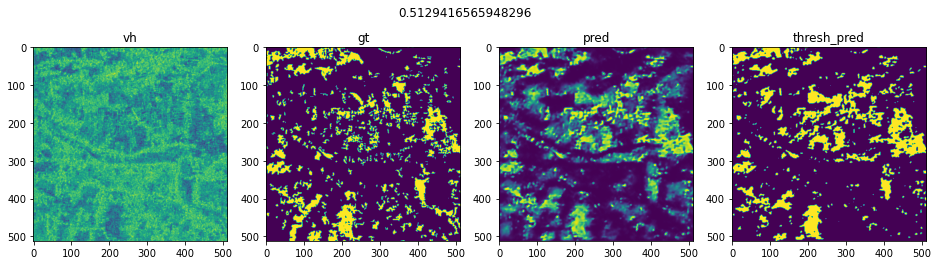

Epoch 16/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6283 - mae: 0.0582 - accuracy: 0.9491 - val_loss: 0.5125 - val_mae: 0.0539 - val_accuracy: 0.9540

Epoch 00016: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00016: val_loss did not improve from 0.47161


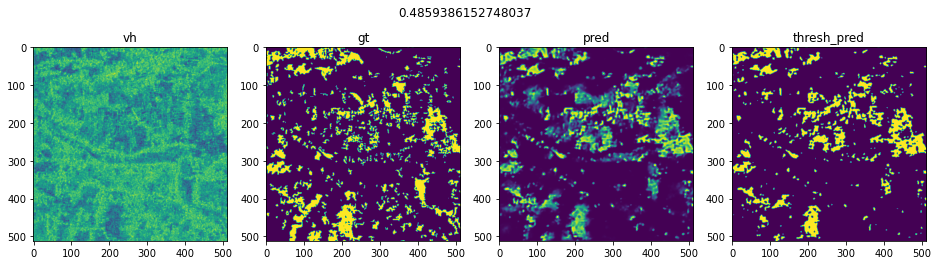

Epoch 17/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6557 - mae: 0.0656 - accuracy: 0.9420 - val_loss: 0.5472 - val_mae: 0.0617 - val_accuracy: 0.9434

Epoch 00017: val_loss did not improve from 0.47161


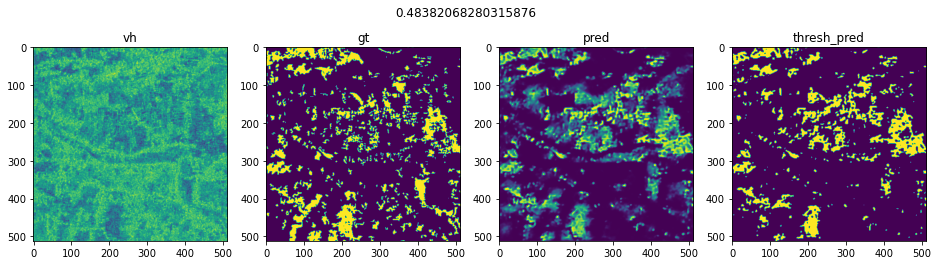

Epoch 18/100
115/115 [==============================] - 42s 361ms/step - loss: 0.5798 - mae: 0.0580 - accuracy: 0.9490 - val_loss: 0.5290 - val_mae: 0.0557 - val_accuracy: 0.9495

Epoch 00018: val_loss did not improve from 0.47161


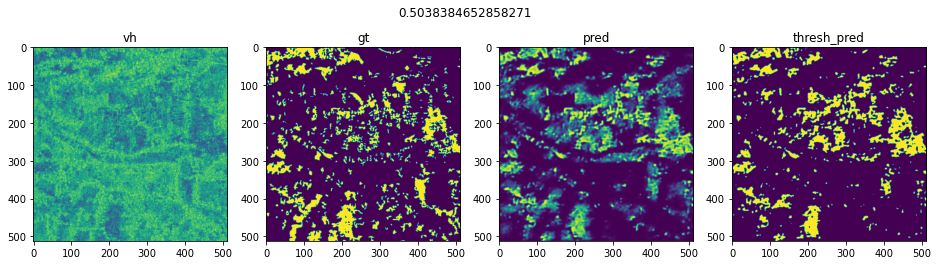

Epoch 19/100
115/115 [==============================] - 42s 362ms/step - loss: 0.5415 - mae: 0.0573 - accuracy: 0.9514 - val_loss: 0.5358 - val_mae: 0.0608 - val_accuracy: 0.9458

Epoch 00019: val_loss did not improve from 0.47161


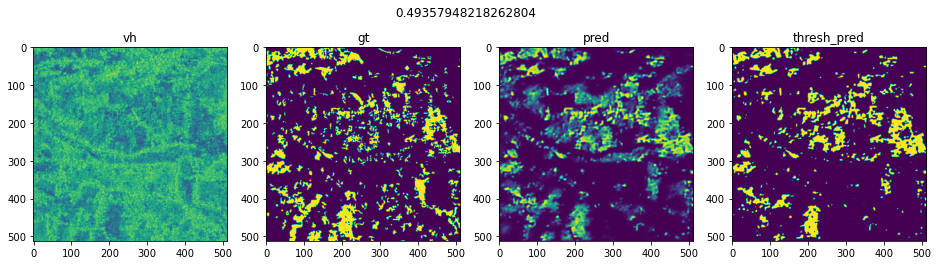

Epoch 20/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6075 - mae: 0.0586 - accuracy: 0.9477 - val_loss: 0.4726 - val_mae: 0.0474 - val_accuracy: 0.9596

Epoch 00020: val_loss did not improve from 0.47161


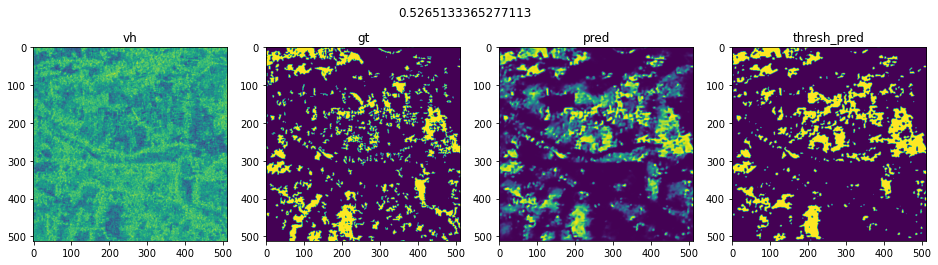

Epoch 21/100
115/115 [==============================] - 42s 361ms/step - loss: 0.6513 - mae: 0.0673 - accuracy: 0.9395 - val_loss: 0.4985 - val_mae: 0.0526 - val_accuracy: 0.9562

Epoch 00021: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00021: val_loss did not improve from 0.47161


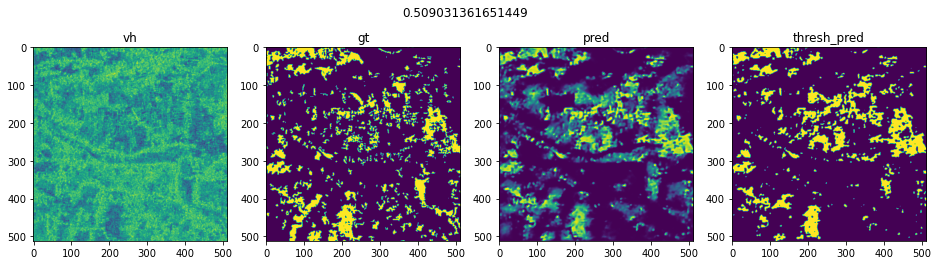

Epoch 22/100
115/115 [==============================] - 42s 362ms/step - loss: 0.6104 - mae: 0.0601 - accuracy: 0.9489 - val_loss: 0.4927 - val_mae: 0.0527 - val_accuracy: 0.9554

Epoch 00022: val_loss did not improve from 0.47161


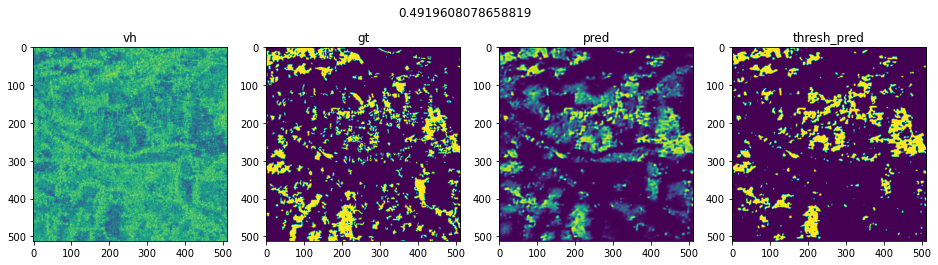

Epoch 23/100
115/115 [==============================] - 42s 361ms/step - loss: 0.5521 - mae: 0.0566 - accuracy: 0.9496 - val_loss: 0.4971 - val_mae: 0.0517 - val_accuracy: 0.9559

Epoch 00023: val_loss did not improve from 0.47161


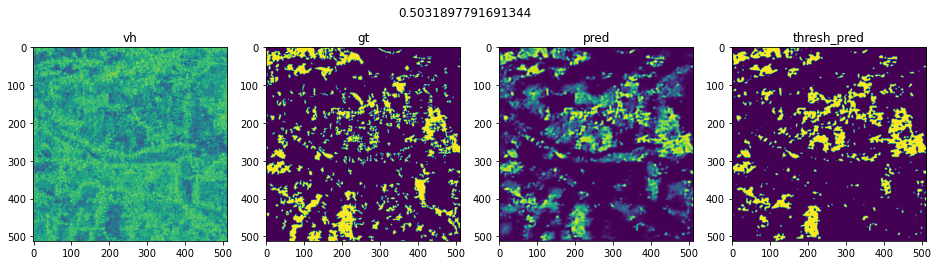

Epoch 00023: early stopping


In [46]:
results = model.fit(train_datagen, validation_data=val_datagen,
                    epochs=100, callbacks=callbacks)

## Similar model, but on weaker data

The idea – to select the most poorly segmented images and train a new model on them.

### Data selection

In [47]:
model = load_model('unet_models/EffUnetB0_512_3.h5', 
                   custom_objects={'FixedDropout': Dropout,
                                   'bce_jaccard_loss': bce_jaccard_loss})

In [49]:
def plot_val(path, plot=True):
    
    with rasterio.open(train_features / '{}_vv.tif'.format(path)) as fvv:
        vv = fvv.read(1)
    with rasterio.open(train_features / '{}_vh.tif'.format(path)) as fvh:
        vh = fvh.read(1)
    with rasterio.open(train_features / '{}_nasadem.tif'.format(path)) as nasadem_:
        nasadem = nasadem_.read(1)
        
    X = np.zeros((INP_SHAPE, INP_SHAPE, 3))
    X[:, :, 0] = (vh - (-17.54)) / 5.15
    X[:, :, 1] = (vv - (-10.68)) / 4.62
    X[:, :, 2] = (nasadem - (166.47)) / 178.47
        
    mask = process_mask(gdal.Open(str(train_labels / '{}.tif'.format(path))).ReadAsArray())
    
    pred = model.predict(X[np.newaxis, :, :, :])[0, :, :, 0]
    
    pred_thresh = pred.copy()
    pred_thresh[pred_thresh > 0.5] = 1
    pred_thresh[pred_thresh <= 0.5] = 0
    pred_thresh = pred_thresh.astype(int)
    
    if plot:
        _, ax = plt.subplots(1, 4, figsize=(16, 4))
    
        ax[0].imshow(X[:, :, 0])
        ax[0].set_title('vh')
        ax[1].imshow(mask)
        ax[1].set_title('gt')
        ax[2].imshow(prediction)
        ax[2].set_title('pred')
        ax[3].imshow(pred_thresh)
        ax[3].set_title('thresh_pred')
        
        if mask.sum() == 0 and pred_thresh.sum() == 0:
            iou = 1
        else:
            intersection = np.logical_and(mask, pred_thresh).sum()
            union = np.logical_or(mask, pred_thresh).sum()
            iou = intersection / union
        plt.suptitle(iou)
        plt.show()
    
    return pred_thresh, mask

In [50]:
ious = []

for i in tqdm(range(len(filenames))):
    
    intersection = 0
    union = 0
    
    pred, actual = plot_val(filenames[i], plot=False)

    intersection += np.logical_and(actual, pred).sum()
    union += np.logical_or(actual, pred).sum()
    
    if actual.sum() == 0 and pred.sum() == 0:
        iou = 1
    else:
        iou = intersection / union

    ious.append(iou)

100%|██████████| 542/542 [00:40<00:00, 13.41it/s]


In [51]:
data = pd.DataFrame()
data['file'] = filenames
data['iou'] = ious
weak_files = data[data.iou < 0.75].file.values
print(len(weak_files))
weak_files = meta[meta.chip_id.isin(weak_files)].reset_index(drop=True)

373


In [52]:
weak_files

,image_id,chip_id,flood_id,polarization,location,scene_start
0,awc00_vh,awc00,awc,vh,Bolivia,2018-02-15
1,awc02_vh,awc02,awc,vh,Bolivia,2018-02-15
2,awc04_vh,awc04,awc,vh,Bolivia,2018-02-15
3,awc06_vh,awc06,awc,vh,Bolivia,2018-02-15
4,awc07_vh,awc07,awc,vh,Bolivia,2018-02-15
...,...,...,...,...,...,...
368,tnp46_vh,tnp46,tnp,vh,Ghana,2018-09-18
369,tnp49_vh,tnp49,tnp,vh,Ghana,2018-09-18
370,wvy06_vh,wvy06,wvy,vh,UK,2019-02-15
371,wvy10_vh,wvy10,wvy,vh,UK,2019-02-15


### Model fitting

In [53]:
INP_SHAPE = 512
N_CHANNELS = 3
BATCH_SIZE = 4

In [54]:
K.clear_session()

model = sm.Unet('efficientnetb0', input_shape=(INP_SHAPE, INP_SHAPE, N_CHANNELS), 
                encoder_weights=None, weights=None)

metrics = [
    'mae',
    'accuracy'
]

model.compile(optimizer=Adam(), 
              loss=bce_jaccard_loss,
              metrics=metrics)

In [55]:
checkpoint_path = 'unet_models/EffUnetB0_{}_{}_weak_1.h5'.format(INP_SHAPE, N_CHANNELS)
# checkpoint_dir = os.path.dirname(checkpoint_path)
# if os.path.exists(checkpoint_dir):
#         shutil.rmtree(checkpoint_dir)
# os.makedirs(checkpoint_dir)

callbacks = [
    EarlyStopping(patience=12, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.000001, verbose=1),
    ModelCheckpoint(filepath=checkpoint_path, verbose=1, save_best_only=True, save_weights_only=False),
    LambdaCallback(on_epoch_end=plot_preds)
]

In [56]:
train_filenames, val_filenames = train_test_split(weak_files.chip_id.values, 
                                                  stratify=weak_files.location, test_size=0.15)

train_datagen = CustomDataGen(train_filenames, channels=N_CHANNELS, 
                              input_shape=INP_SHAPE, batch_size=BATCH_SIZE)

val_datagen = CustomDataGen(val_filenames, channels=N_CHANNELS, input_shape=INP_SHAPE, 
                            batch_size=BATCH_SIZE, augment=False)

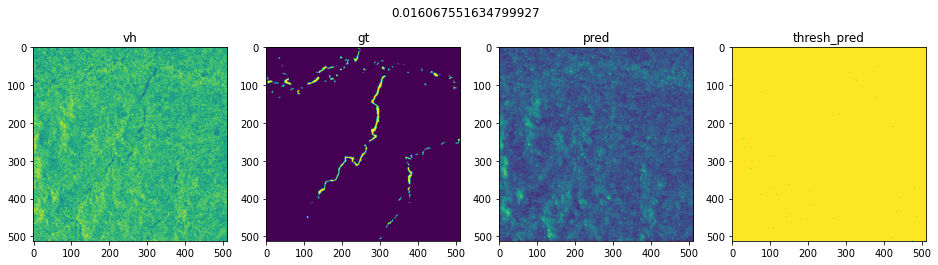

In [57]:
plot_preds(0, 0)

Epoch 1/100
79/79 [==============================] - 34s 354ms/step - loss: 1.4636 - mae: 0.3658 - accuracy: 0.7520 - val_loss: 1.2456 - val_mae: 0.0914 - val_accuracy: 0.9176

Epoch 00001: val_loss improved from inf to 1.24561, saving model to unet_models/EffUnetB0_512_3_weak_1.h5


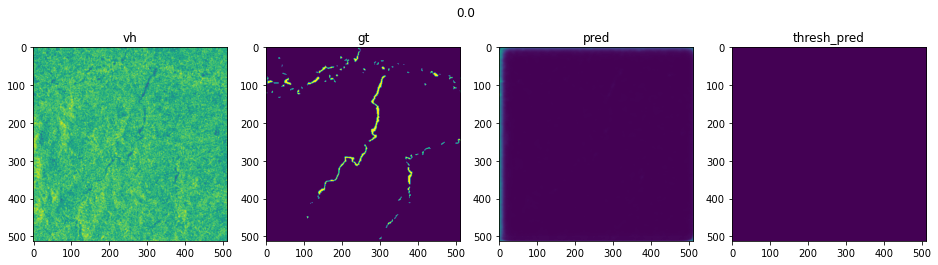

Epoch 2/100
79/79 [==============================] - 27s 344ms/step - loss: 1.0610 - mae: 0.1239 - accuracy: 0.9200 - val_loss: 0.9520 - val_mae: 0.0886 - val_accuracy: 0.9306

Epoch 00002: val_loss improved from 1.24561 to 0.95197, saving model to unet_models/EffUnetB0_512_3_weak_1.h5


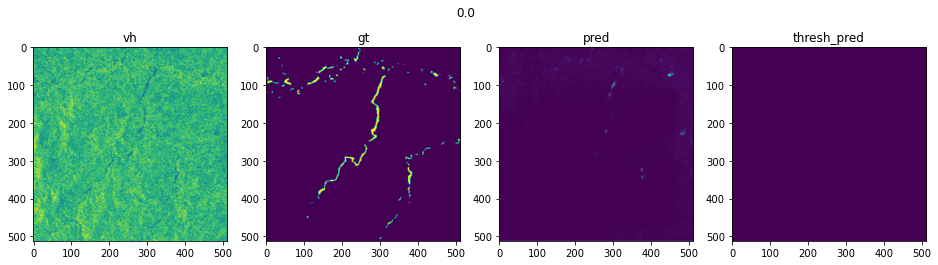

Epoch 3/100
79/79 [==============================] - 28s 346ms/step - loss: 0.9209 - mae: 0.0879 - accuracy: 0.9316 - val_loss: 0.9168 - val_mae: 0.0799 - val_accuracy: 0.9247

Epoch 00003: val_loss improved from 0.95197 to 0.91675, saving model to unet_models/EffUnetB0_512_3_weak_1.h5


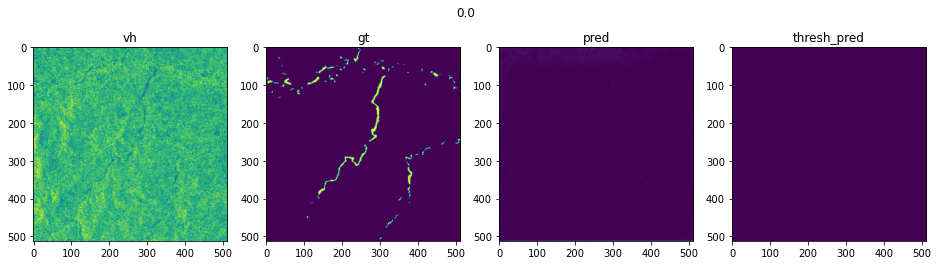

Epoch 4/100
79/79 [==============================] - 28s 349ms/step - loss: 0.8688 - mae: 0.0979 - accuracy: 0.9083 - val_loss: 0.7829 - val_mae: 0.0840 - val_accuracy: 0.9310

Epoch 00004: val_loss improved from 0.91675 to 0.78287, saving model to unet_models/EffUnetB0_512_3_weak_1.h5


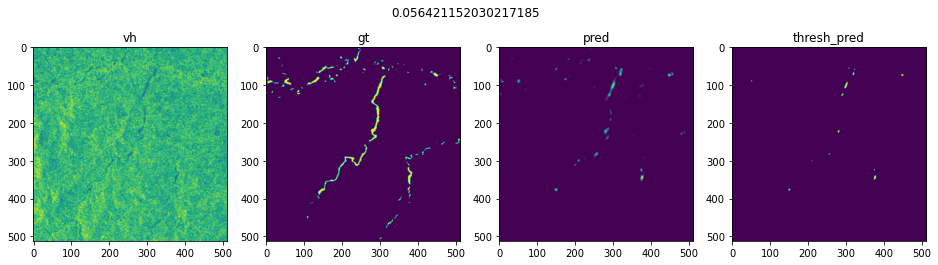

Epoch 5/100
79/79 [==============================] - 28s 350ms/step - loss: 0.8401 - mae: 0.0790 - accuracy: 0.9301 - val_loss: 0.9438 - val_mae: 0.1377 - val_accuracy: 0.9072

Epoch 00005: val_loss did not improve from 0.78287


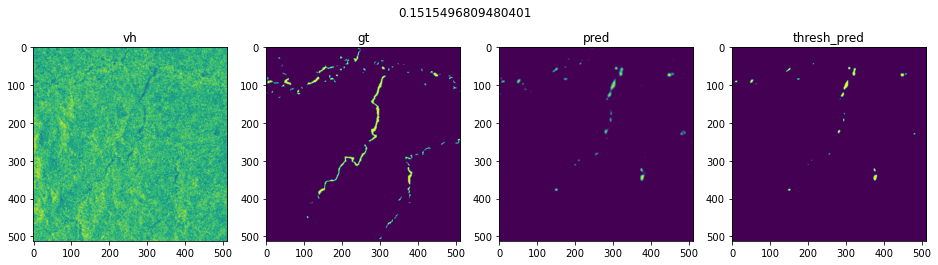

Epoch 6/100
79/79 [==============================] - 28s 353ms/step - loss: 0.8680 - mae: 0.0800 - accuracy: 0.9267 - val_loss: 0.8777 - val_mae: 0.1108 - val_accuracy: 0.9177

Epoch 00006: val_loss did not improve from 0.78287


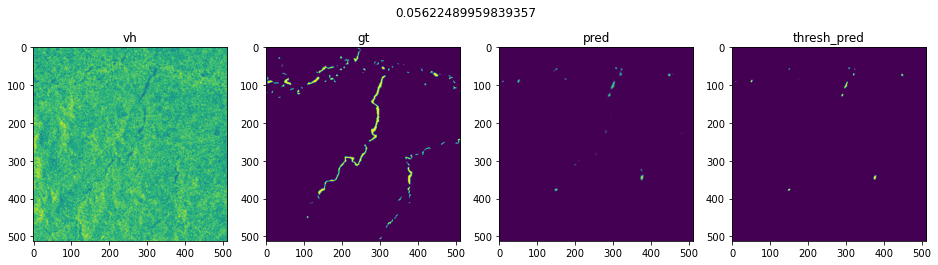

Epoch 7/100
79/79 [==============================] - 28s 354ms/step - loss: 0.8260 - mae: 0.0719 - accuracy: 0.9342 - val_loss: 1.0570 - val_mae: 0.1593 - val_accuracy: 0.8249

Epoch 00007: val_loss did not improve from 0.78287


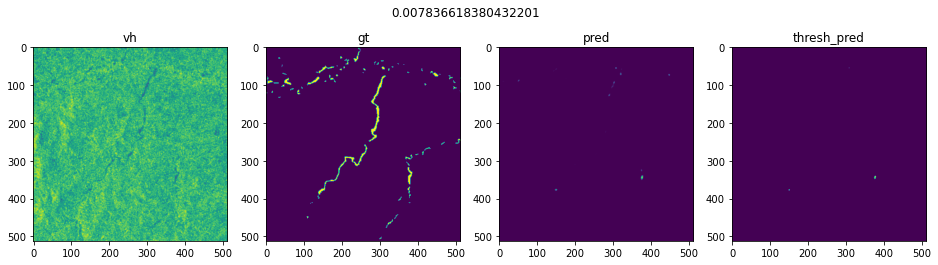

Epoch 8/100
79/79 [==============================] - 28s 356ms/step - loss: 0.7898 - mae: 0.0742 - accuracy: 0.9338 - val_loss: 0.7602 - val_mae: 0.0724 - val_accuracy: 0.9333

Epoch 00008: val_loss improved from 0.78287 to 0.76024, saving model to unet_models/EffUnetB0_512_3_weak_1.h5


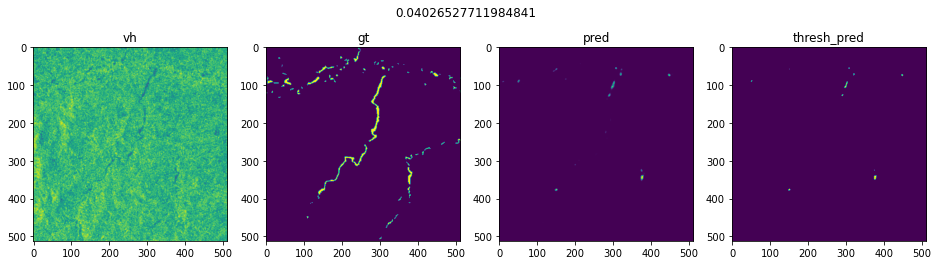

Epoch 9/100
79/79 [==============================] - 28s 357ms/step - loss: 0.6468 - mae: 0.0548 - accuracy: 0.9506 - val_loss: 0.6814 - val_mae: 0.0623 - val_accuracy: 0.9436

Epoch 00009: val_loss improved from 0.76024 to 0.68138, saving model to unet_models/EffUnetB0_512_3_weak_1.h5


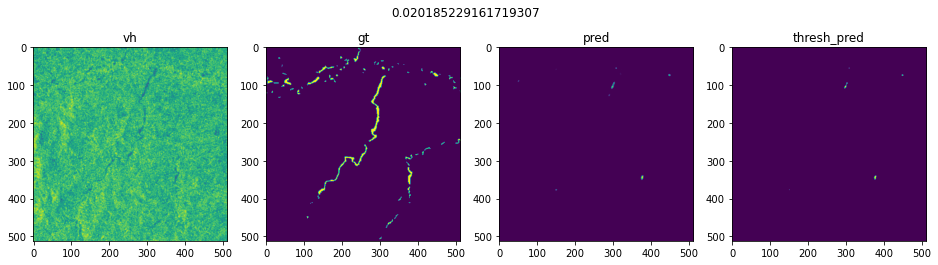

Epoch 10/100
79/79 [==============================] - 28s 357ms/step - loss: 0.8112 - mae: 0.0818 - accuracy: 0.9248 - val_loss: 0.7099 - val_mae: 0.0729 - val_accuracy: 0.9313

Epoch 00010: val_loss did not improve from 0.68138


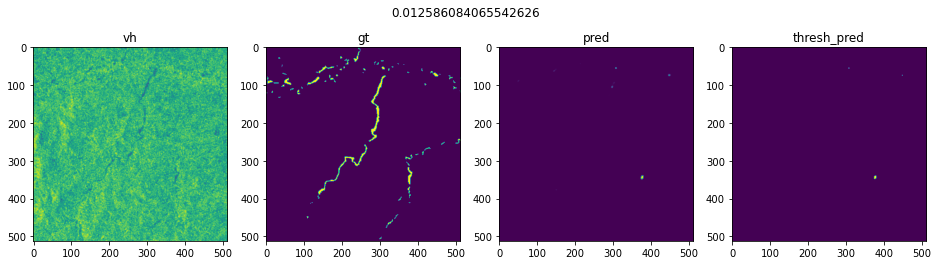

Epoch 11/100
79/79 [==============================] - 28s 359ms/step - loss: 0.7512 - mae: 0.0710 - accuracy: 0.9339 - val_loss: 0.6733 - val_mae: 0.0616 - val_accuracy: 0.9429

Epoch 00011: val_loss improved from 0.68138 to 0.67334, saving model to unet_models/EffUnetB0_512_3_weak_1.h5


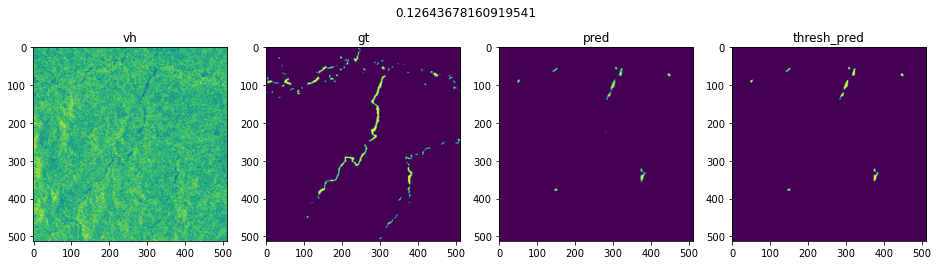

Epoch 12/100
79/79 [==============================] - 28s 358ms/step - loss: 0.7326 - mae: 0.0719 - accuracy: 0.9366 - val_loss: 0.7992 - val_mae: 0.0766 - val_accuracy: 0.9262

Epoch 00012: val_loss did not improve from 0.67334


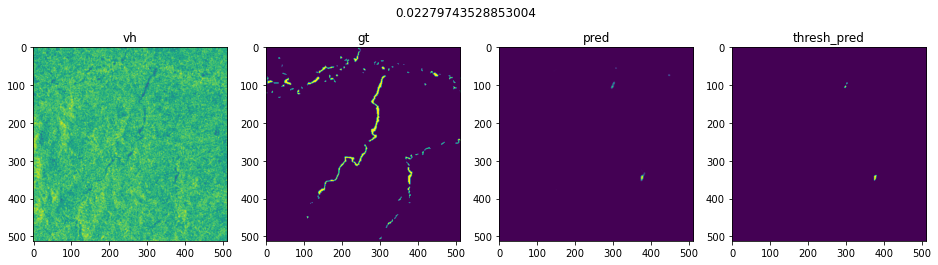

Epoch 13/100
79/79 [==============================] - 29s 360ms/step - loss: 0.7376 - mae: 0.0674 - accuracy: 0.9387 - val_loss: 0.8692 - val_mae: 0.0897 - val_accuracy: 0.9129

Epoch 00013: val_loss did not improve from 0.67334


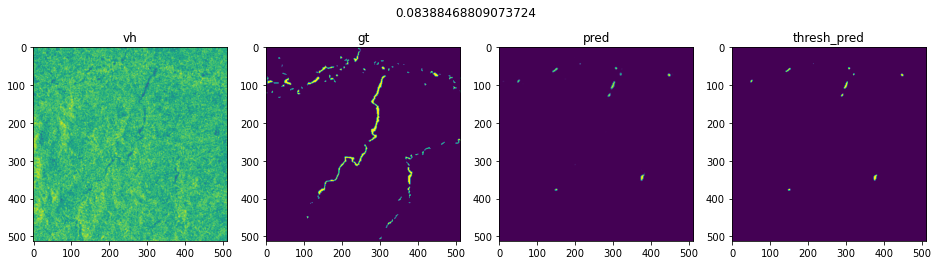

Epoch 14/100
79/79 [==============================] - 28s 359ms/step - loss: 0.7677 - mae: 0.0730 - accuracy: 0.9332 - val_loss: 0.7110 - val_mae: 0.0697 - val_accuracy: 0.9341

Epoch 00014: val_loss did not improve from 0.67334


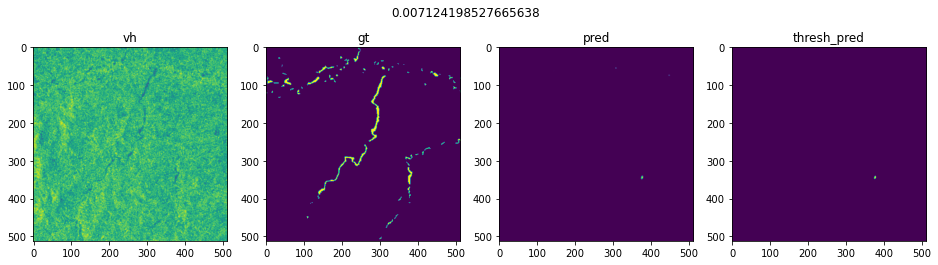

Epoch 15/100
79/79 [==============================] - 28s 358ms/step - loss: 0.6649 - mae: 0.0555 - accuracy: 0.9498 - val_loss: 0.7417 - val_mae: 0.0671 - val_accuracy: 0.9345

Epoch 00015: val_loss did not improve from 0.67334


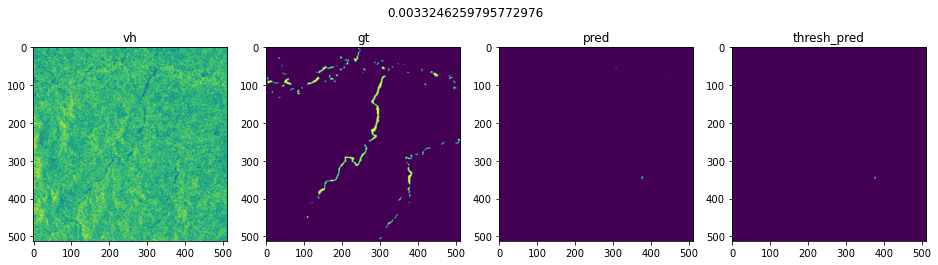

Epoch 16/100
79/79 [==============================] - 29s 360ms/step - loss: 0.6952 - mae: 0.0765 - accuracy: 0.9333 - val_loss: 0.7194 - val_mae: 0.0758 - val_accuracy: 0.9300

Epoch 00016: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00016: val_loss did not improve from 0.67334


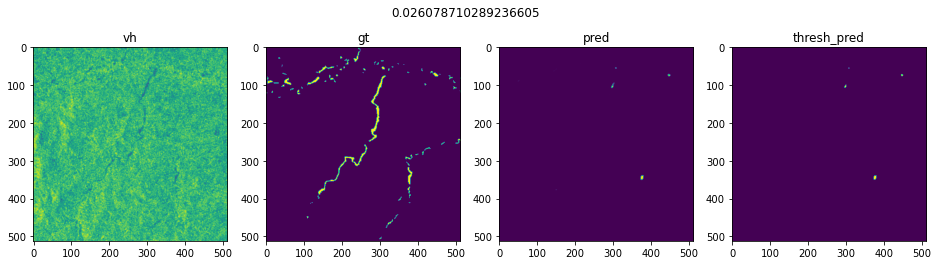

Epoch 17/100
79/79 [==============================] - 28s 358ms/step - loss: 0.7076 - mae: 0.0698 - accuracy: 0.9362 - val_loss: 0.7204 - val_mae: 0.0712 - val_accuracy: 0.9331

Epoch 00017: val_loss did not improve from 0.67334


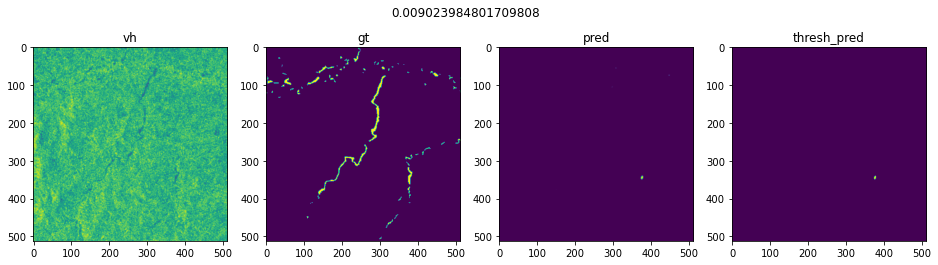

Epoch 18/100
79/79 [==============================] - 29s 361ms/step - loss: 0.6615 - mae: 0.0607 - accuracy: 0.9484 - val_loss: 0.7281 - val_mae: 0.0709 - val_accuracy: 0.9335

Epoch 00018: val_loss did not improve from 0.67334


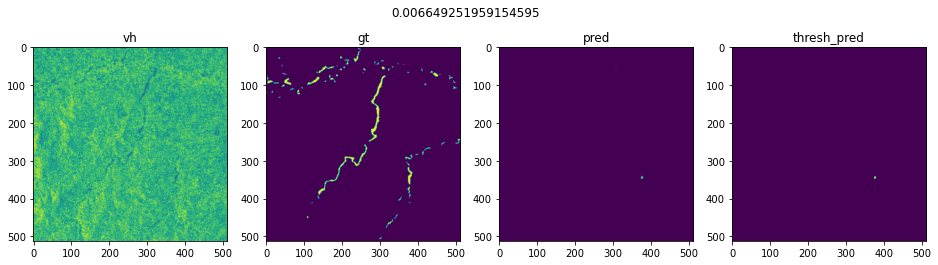

Epoch 19/100
79/79 [==============================] - 28s 359ms/step - loss: 0.6148 - mae: 0.0610 - accuracy: 0.9486 - val_loss: 0.7615 - val_mae: 0.0715 - val_accuracy: 0.9325

Epoch 00019: val_loss did not improve from 0.67334


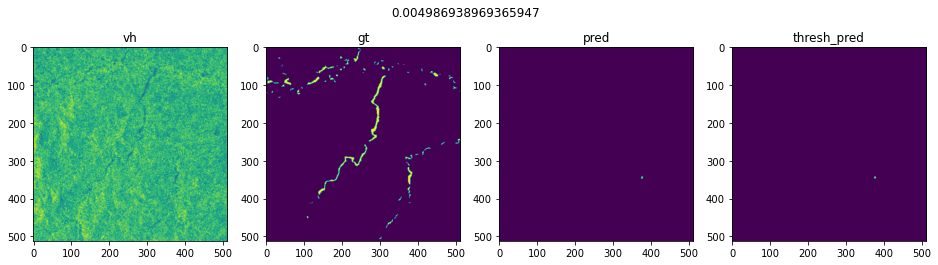

Epoch 20/100
79/79 [==============================] - 28s 359ms/step - loss: 0.6471 - mae: 0.0655 - accuracy: 0.9448 - val_loss: 0.7374 - val_mae: 0.0696 - val_accuracy: 0.9345

Epoch 00020: val_loss did not improve from 0.67334


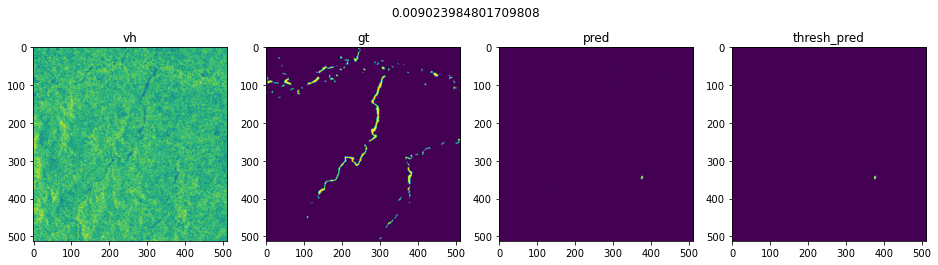

Epoch 21/100
79/79 [==============================] - 28s 358ms/step - loss: 0.7004 - mae: 0.0711 - accuracy: 0.9374 - val_loss: 0.7479 - val_mae: 0.0710 - val_accuracy: 0.9329

Epoch 00021: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00021: val_loss did not improve from 0.67334


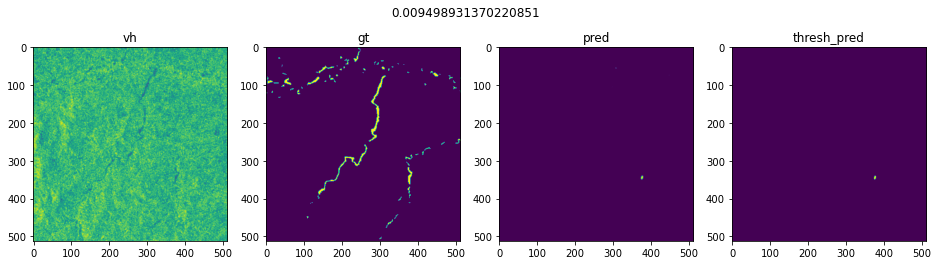

Epoch 22/100
79/79 [==============================] - 28s 358ms/step - loss: 0.6642 - mae: 0.0677 - accuracy: 0.9398 - val_loss: 0.7461 - val_mae: 0.0710 - val_accuracy: 0.9330

Epoch 00022: val_loss did not improve from 0.67334


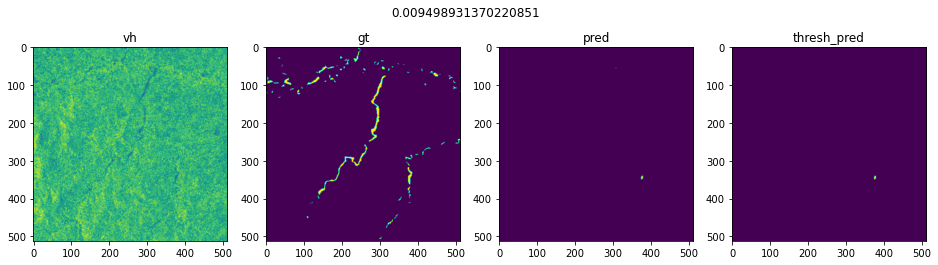

Epoch 23/100
79/79 [==============================] - 28s 358ms/step - loss: 0.6999 - mae: 0.0655 - accuracy: 0.9424 - val_loss: 0.7354 - val_mae: 0.0707 - val_accuracy: 0.9333

Epoch 00023: val_loss did not improve from 0.67334


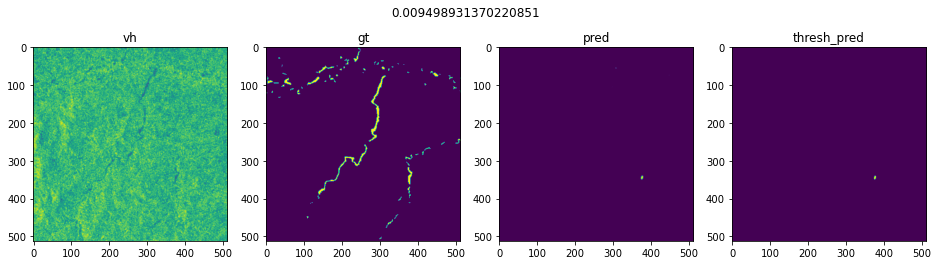

Epoch 00023: early stopping


In [58]:
results = model.fit(train_datagen, validation_data=val_datagen,
                    epochs=100, callbacks=callbacks)

# StratifiedKFold models with EfficientNetB4 backbone

In [60]:
INP_SHAPE = 512
N_CHANNELS = 3
BATCH_SIZE = 4

Epoch 1/70
108/108 [==============================] - 127s 705ms/step - loss: 1.2730 - mae: 0.2931 - accuracy: 0.8038 - val_loss: 2.6465 - val_mae: 0.1311 - val_accuracy: 0.8695

Epoch 00001: val_loss improved from inf to 2.64646, saving model to unet_models/EfficientB4Unet_512_3_0.h5


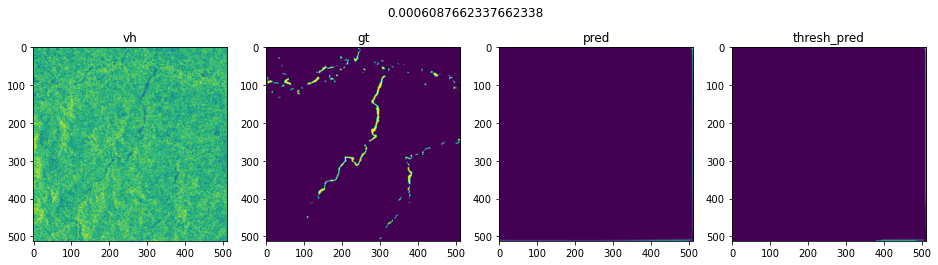

Epoch 2/70
108/108 [==============================] - 75s 693ms/step - loss: 0.7367 - mae: 0.0829 - accuracy: 0.9355 - val_loss: 0.8249 - val_mae: 0.0934 - val_accuracy: 0.9100

Epoch 00004: val_loss improved from 0.87682 to 0.82490, saving model to unet_models/EfficientB4Unet_512_3_0.h5


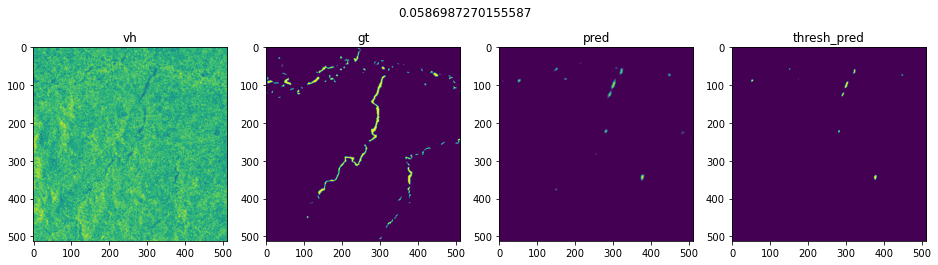

Epoch 5/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6920 - mae: 0.0749 - accuracy: 0.9380 - val_loss: 0.6306 - val_mae: 0.0634 - val_accuracy: 0.9418

Epoch 00005: val_loss improved from 0.82490 to 0.63058, saving model to unet_models/EfficientB4Unet_512_3_0.h5


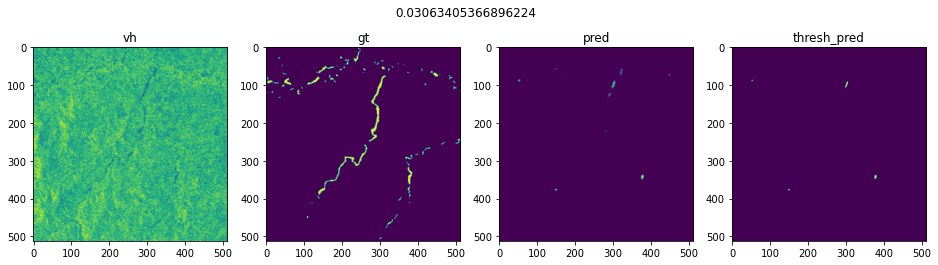

Epoch 6/70
108/108 [==============================] - 75s 693ms/step - loss: 0.8325 - mae: 0.0850 - accuracy: 0.9250 - val_loss: 0.5909 - val_mae: 0.0508 - val_accuracy: 0.9501

Epoch 00006: val_loss improved from 0.63058 to 0.59088, saving model to unet_models/EfficientB4Unet_512_3_0.h5


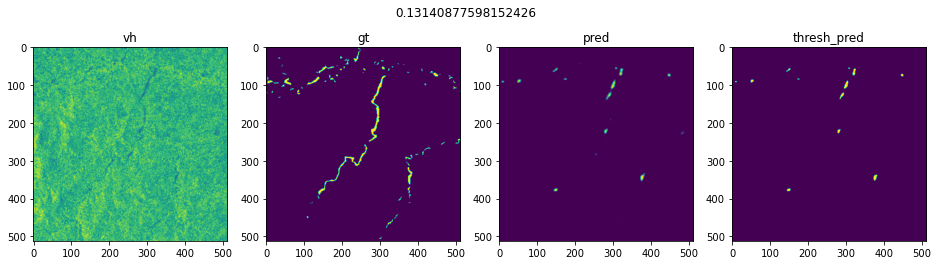

Epoch 7/70
108/108 [==============================] - 75s 694ms/step - loss: 0.7698 - mae: 0.0841 - accuracy: 0.9264 - val_loss: 0.7347 - val_mae: 0.0699 - val_accuracy: 0.9465

Epoch 00007: val_loss did not improve from 0.59088


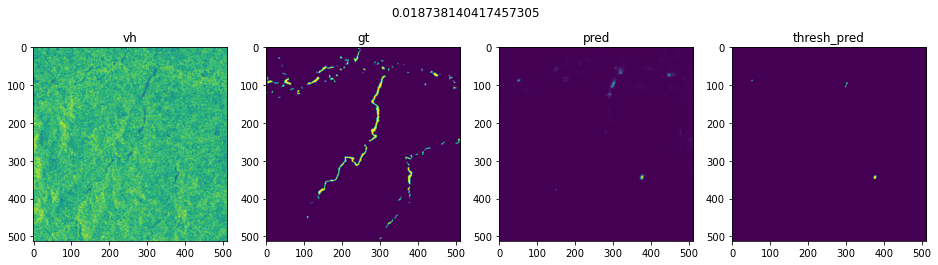

Epoch 8/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6694 - mae: 0.0612 - accuracy: 0.9472 - val_loss: 0.5717 - val_mae: 0.0558 - val_accuracy: 0.9557

Epoch 00008: val_loss improved from 0.59088 to 0.57170, saving model to unet_models/EfficientB4Unet_512_3_0.h5


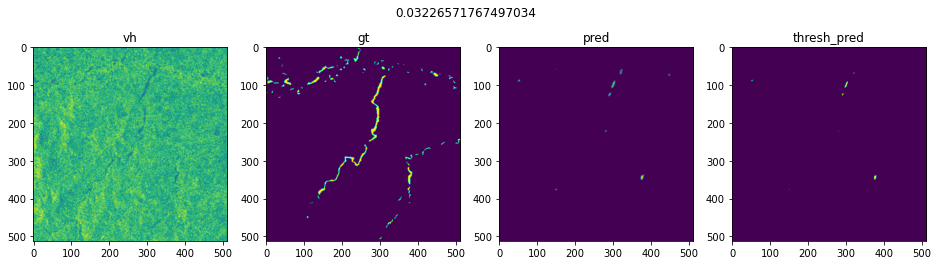

Epoch 9/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6963 - mae: 0.0697 - accuracy: 0.9395 - val_loss: 0.6420 - val_mae: 0.0531 - val_accuracy: 0.9506

Epoch 00009: val_loss did not improve from 0.57170


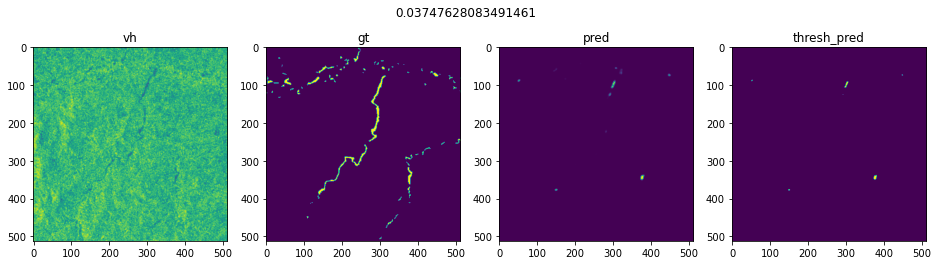

Epoch 10/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6465 - mae: 0.0638 - accuracy: 0.9437 - val_loss: 0.6630 - val_mae: 0.0619 - val_accuracy: 0.9482

Epoch 00010: val_loss did not improve from 0.57170


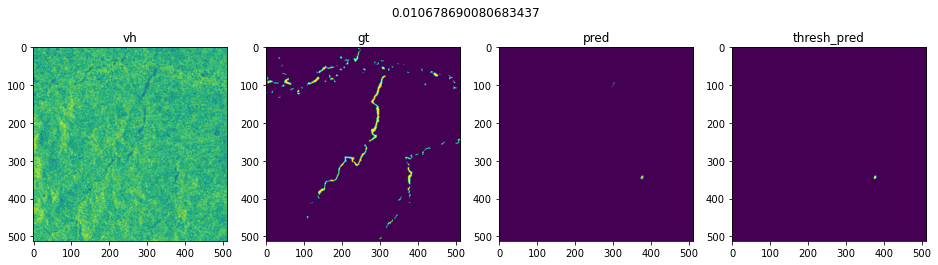

Epoch 11/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6784 - mae: 0.0667 - accuracy: 0.9420 - val_loss: 0.6364 - val_mae: 0.0574 - val_accuracy: 0.9500

Epoch 00011: val_loss did not improve from 0.57170


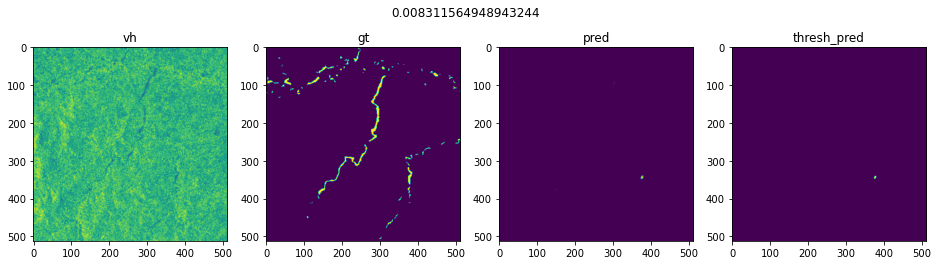

Epoch 12/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6598 - mae: 0.0717 - accuracy: 0.9409 - val_loss: 0.6413 - val_mae: 0.0575 - val_accuracy: 0.9503

Epoch 00012: val_loss did not improve from 0.57170


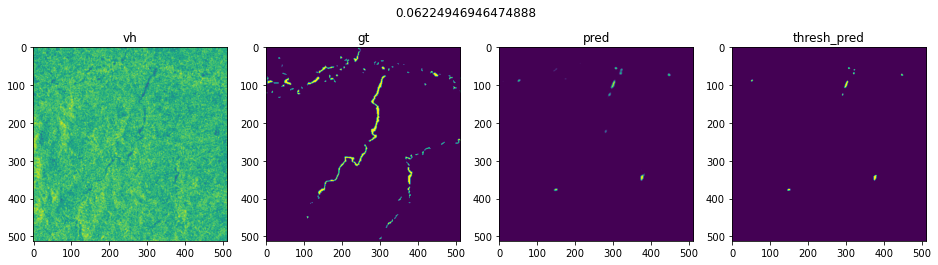

Epoch 13/70
108/108 [==============================] - 75s 690ms/step - loss: 0.6624 - mae: 0.0754 - accuracy: 0.9366 - val_loss: 0.6280 - val_mae: 0.0522 - val_accuracy: 0.9525

Epoch 00013: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00013: val_loss did not improve from 0.57170


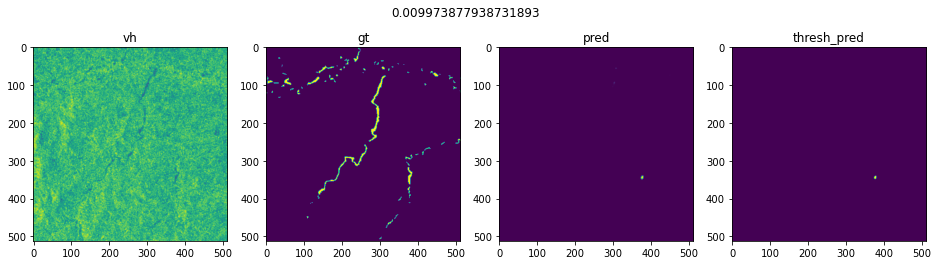

Epoch 14/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6229 - mae: 0.0607 - accuracy: 0.9468 - val_loss: 0.6405 - val_mae: 0.0570 - val_accuracy: 0.9506

Epoch 00014: val_loss did not improve from 0.57170


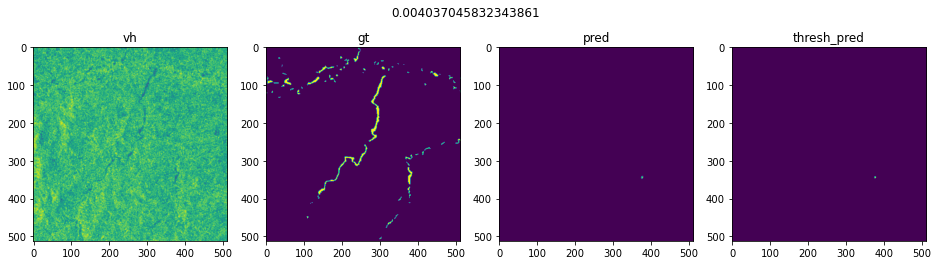

Epoch 15/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6215 - mae: 0.0651 - accuracy: 0.9439 - val_loss: 0.6574 - val_mae: 0.0608 - val_accuracy: 0.9484

Epoch 00015: val_loss did not improve from 0.57170


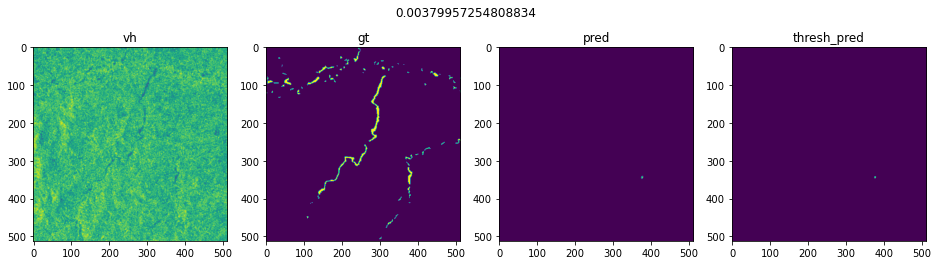

Epoch 16/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6119 - mae: 0.0591 - accuracy: 0.9503 - val_loss: 0.6682 - val_mae: 0.0616 - val_accuracy: 0.9461

Epoch 00016: val_loss did not improve from 0.57170


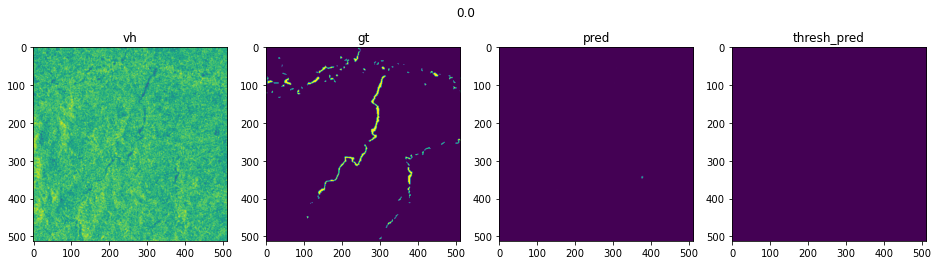

Epoch 17/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6271 - mae: 0.0643 - accuracy: 0.9451 - val_loss: 0.7009 - val_mae: 0.0693 - val_accuracy: 0.9408

Epoch 00017: val_loss did not improve from 0.57170


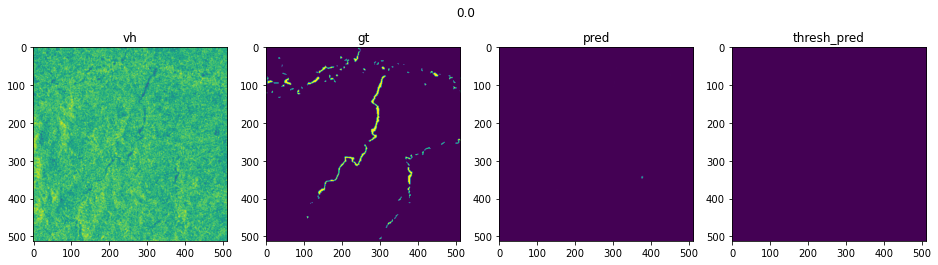

Epoch 18/70
108/108 [==============================] - 75s 696ms/step - loss: 0.6155 - mae: 0.0553 - accuracy: 0.9524 - val_loss: 0.6813 - val_mae: 0.0656 - val_accuracy: 0.9430

Epoch 00018: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00018: val_loss did not improve from 0.57170


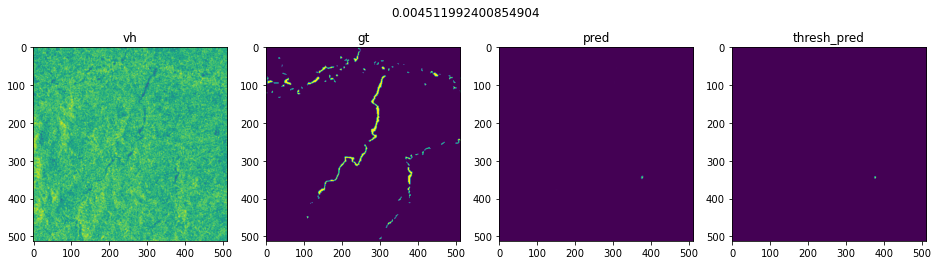

Epoch 19/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6747 - mae: 0.0689 - accuracy: 0.9409 - val_loss: 0.6564 - val_mae: 0.0598 - val_accuracy: 0.9484

Epoch 00019: val_loss did not improve from 0.57170


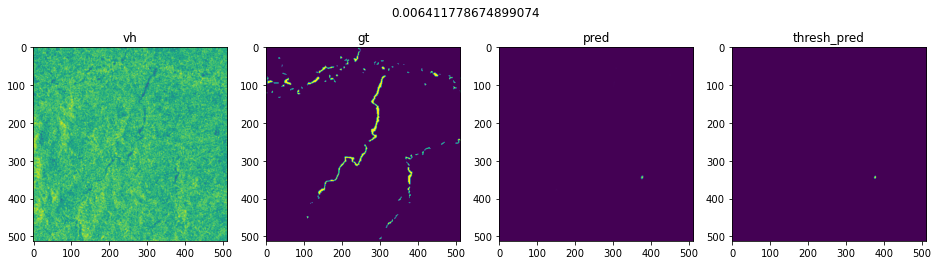

Epoch 20/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6390 - mae: 0.0661 - accuracy: 0.9413 - val_loss: 0.6548 - val_mae: 0.0595 - val_accuracy: 0.9482

Epoch 00020: val_loss did not improve from 0.57170


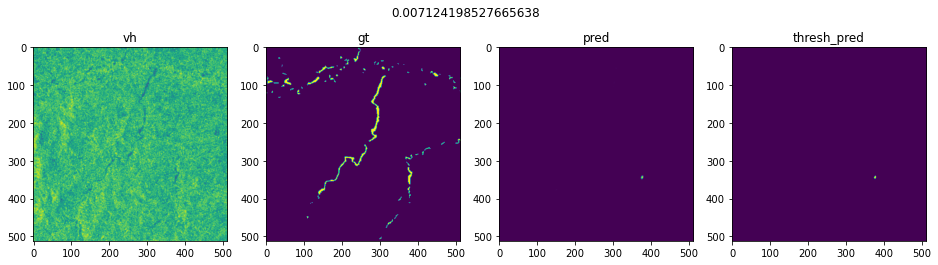

Epoch 21/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6088 - mae: 0.0612 - accuracy: 0.9472 - val_loss: 0.6487 - val_mae: 0.0580 - val_accuracy: 0.9496

Epoch 00021: val_loss did not improve from 0.57170


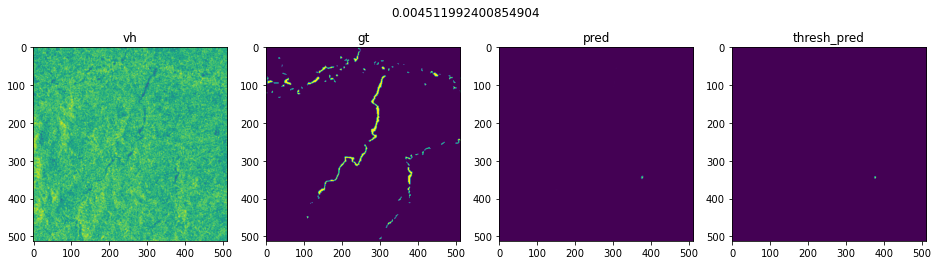

Epoch 22/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5695 - mae: 0.0602 - accuracy: 0.9482 - val_loss: 0.6462 - val_mae: 0.0577 - val_accuracy: 0.9496

Epoch 00022: val_loss did not improve from 0.57170


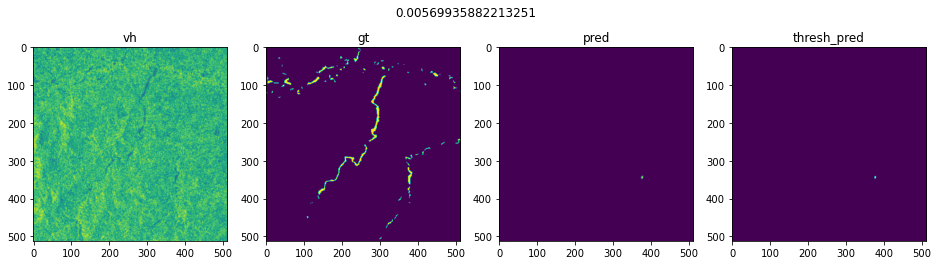

Epoch 23/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5965 - mae: 0.0614 - accuracy: 0.9459 - val_loss: 0.6471 - val_mae: 0.0577 - val_accuracy: 0.9495

Epoch 00023: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00023: val_loss did not improve from 0.57170


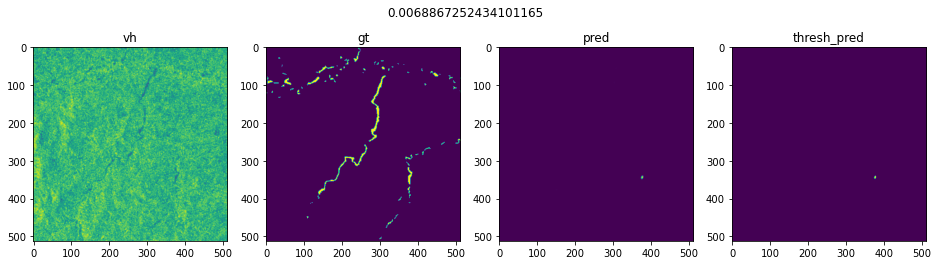

Epoch 00023: early stopping
Epoch 1/70
108/108 [==============================] - 89s 707ms/step - loss: 1.3842 - mae: 0.3532 - accuracy: 0.7540 - val_loss: 1.0407 - val_mae: 0.1333 - val_accuracy: 0.9401

Epoch 00001: val_loss improved from inf to 1.04070, saving model to unet_models/EfficientB4Unet_512_3_1.h5


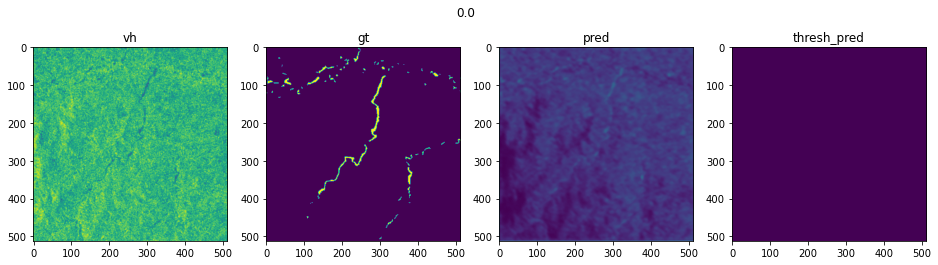

Epoch 2/70
108/108 [==============================] - 75s 693ms/step - loss: 0.9523 - mae: 0.1272 - accuracy: 0.9135 - val_loss: 13.4073 - val_mae: 0.8347 - val_accuracy: 0.1652

Epoch 00002: val_loss did not improve from 1.04070


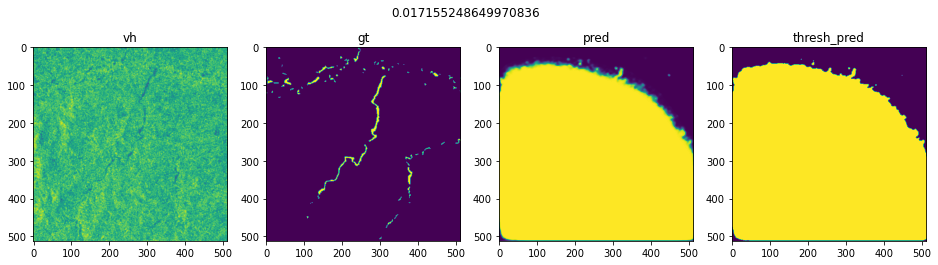

Epoch 3/70
108/108 [==============================] - 75s 694ms/step - loss: 0.7875 - mae: 0.1029 - accuracy: 0.9164 - val_loss: 10.6258 - val_mae: 0.6635 - val_accuracy: 0.3366

Epoch 00003: val_loss did not improve from 1.04070


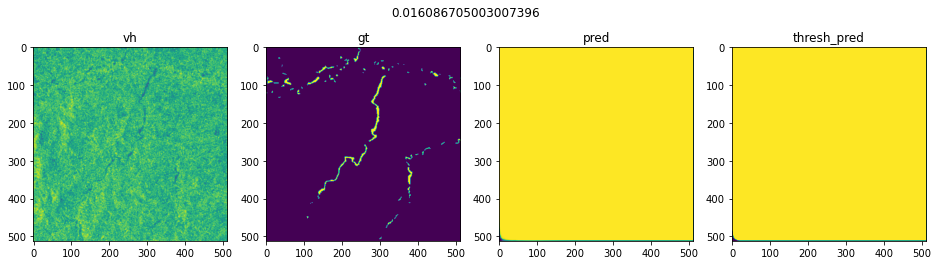

Epoch 4/70
108/108 [==============================] - 75s 694ms/step - loss: 0.7741 - mae: 0.0924 - accuracy: 0.9179 - val_loss: 3.9023 - val_mae: 0.5123 - val_accuracy: 0.4623

Epoch 00004: val_loss did not improve from 1.04070


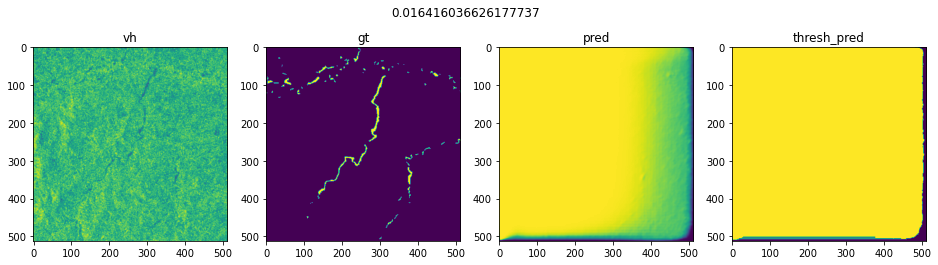

Epoch 5/70
108/108 [==============================] - 75s 692ms/step - loss: 0.7610 - mae: 0.0816 - accuracy: 0.9357 - val_loss: 0.7568 - val_mae: 0.1082 - val_accuracy: 0.8910

Epoch 00005: val_loss improved from 1.04070 to 0.75677, saving model to unet_models/EfficientB4Unet_512_3_1.h5


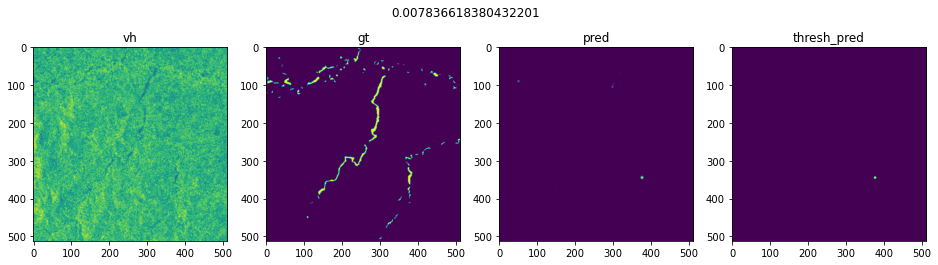

Epoch 6/70
108/108 [==============================] - 75s 692ms/step - loss: 0.7295 - mae: 0.0758 - accuracy: 0.9338 - val_loss: 1.0299 - val_mae: 0.0870 - val_accuracy: 0.9167

Epoch 00006: val_loss did not improve from 0.75677


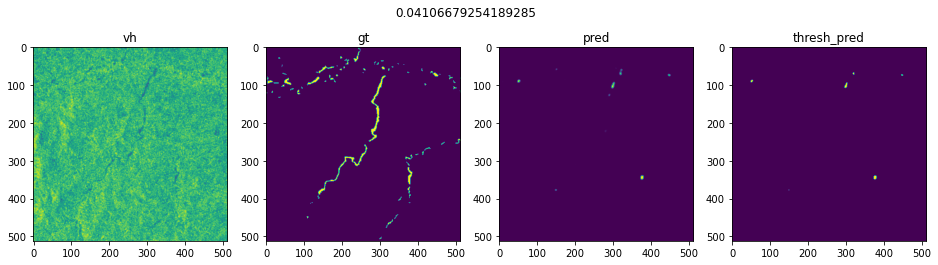

Epoch 7/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6372 - mae: 0.0685 - accuracy: 0.9434 - val_loss: 0.6695 - val_mae: 0.0595 - val_accuracy: 0.9443

Epoch 00007: val_loss improved from 0.75677 to 0.66950, saving model to unet_models/EfficientB4Unet_512_3_1.h5


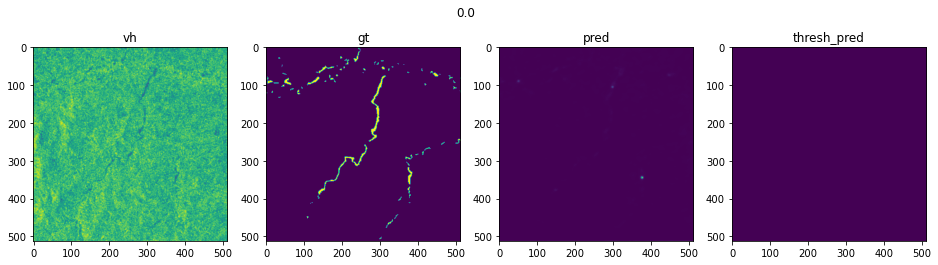

Epoch 8/70
108/108 [==============================] - 76s 699ms/step - loss: 0.6514 - mae: 0.0695 - accuracy: 0.9402 - val_loss: 1.6345 - val_mae: 0.1157 - val_accuracy: 0.8937

Epoch 00008: val_loss did not improve from 0.66950


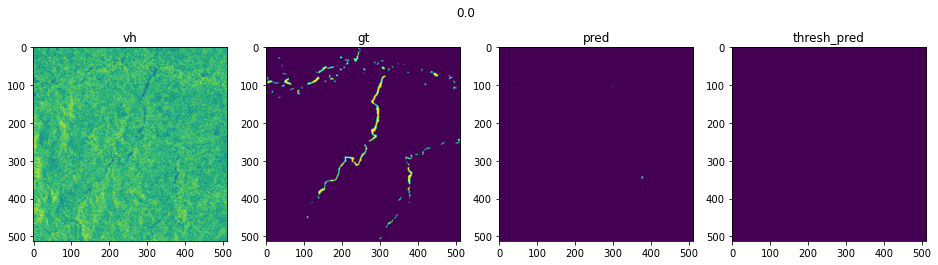

Epoch 9/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6985 - mae: 0.0758 - accuracy: 0.9364 - val_loss: 0.6489 - val_mae: 0.0601 - val_accuracy: 0.9448

Epoch 00009: val_loss improved from 0.66950 to 0.64891, saving model to unet_models/EfficientB4Unet_512_3_1.h5


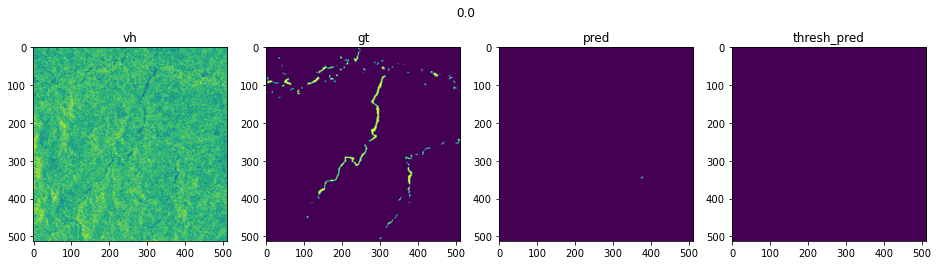

Epoch 10/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6966 - mae: 0.0750 - accuracy: 0.9346 - val_loss: 0.5769 - val_mae: 0.0604 - val_accuracy: 0.9525

Epoch 00010: val_loss improved from 0.64891 to 0.57687, saving model to unet_models/EfficientB4Unet_512_3_1.h5


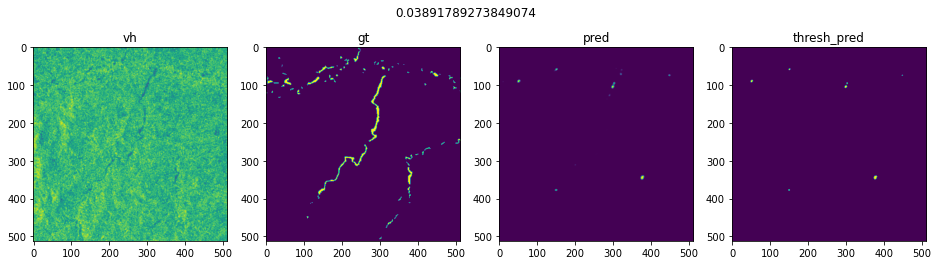

Epoch 11/70
108/108 [==============================] - 75s 692ms/step - loss: 0.7157 - mae: 0.0761 - accuracy: 0.9347 - val_loss: 0.5745 - val_mae: 0.0558 - val_accuracy: 0.9549

Epoch 00011: val_loss improved from 0.57687 to 0.57446, saving model to unet_models/EfficientB4Unet_512_3_1.h5


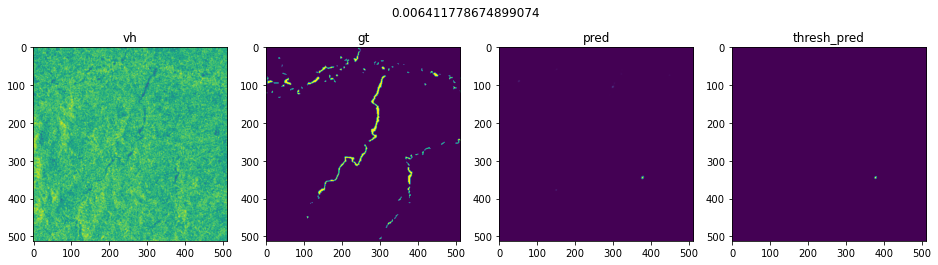

Epoch 12/70
108/108 [==============================] - 75s 690ms/step - loss: 0.5822 - mae: 0.0556 - accuracy: 0.9519 - val_loss: 0.7550 - val_mae: 0.0831 - val_accuracy: 0.9257

Epoch 00012: val_loss did not improve from 0.57446


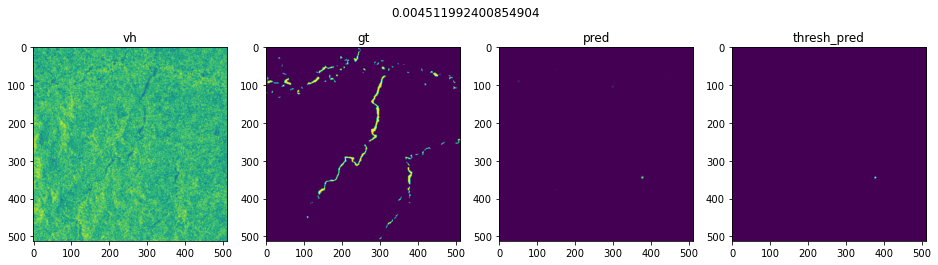

Epoch 13/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6552 - mae: 0.0739 - accuracy: 0.9389 - val_loss: 0.6453 - val_mae: 0.0741 - val_accuracy: 0.9460

Epoch 00013: val_loss did not improve from 0.57446


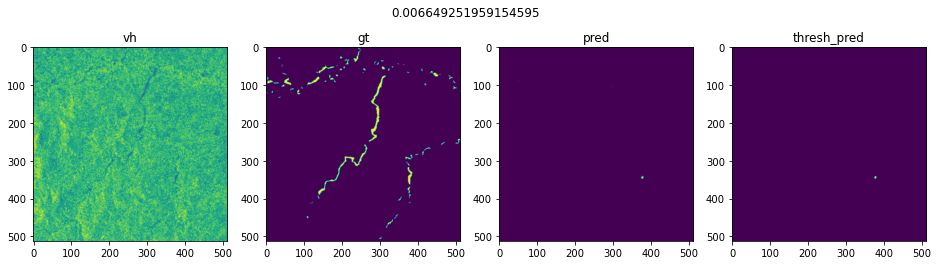

Epoch 14/70
108/108 [==============================] - 75s 691ms/step - loss: 0.6867 - mae: 0.0694 - accuracy: 0.9409 - val_loss: 0.5911 - val_mae: 0.0536 - val_accuracy: 0.9488

Epoch 00014: val_loss did not improve from 0.57446


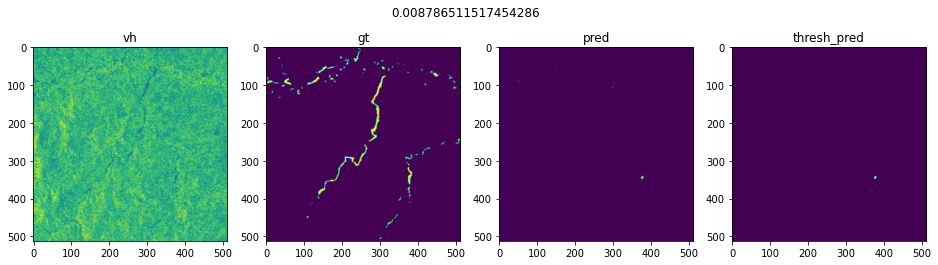

Epoch 15/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6428 - mae: 0.0643 - accuracy: 0.9460 - val_loss: 0.5634 - val_mae: 0.0496 - val_accuracy: 0.9568

Epoch 00015: val_loss improved from 0.57446 to 0.56342, saving model to unet_models/EfficientB4Unet_512_3_1.h5


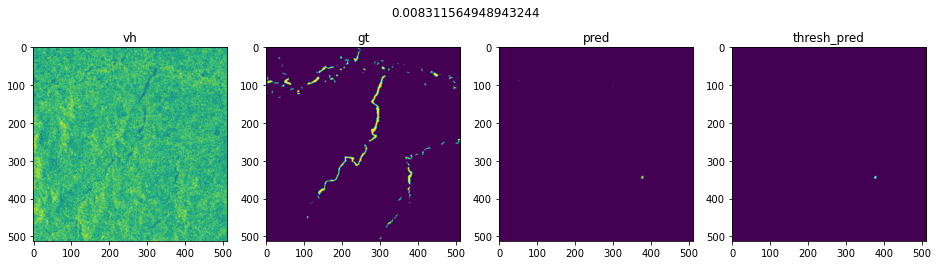

Epoch 16/70
108/108 [==============================] - 75s 691ms/step - loss: 0.6195 - mae: 0.0625 - accuracy: 0.9459 - val_loss: 0.5673 - val_mae: 0.0538 - val_accuracy: 0.9505

Epoch 00016: val_loss did not improve from 0.56342


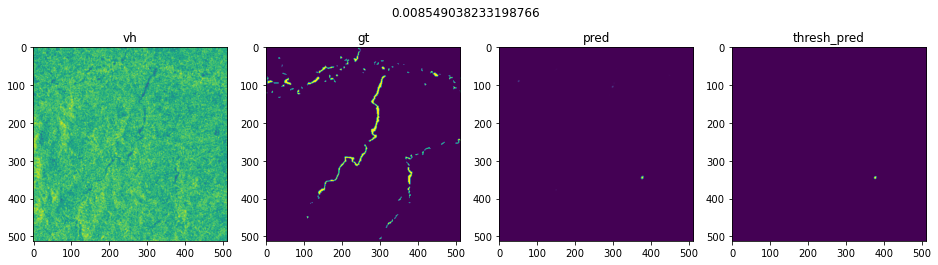

Epoch 17/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6089 - mae: 0.0613 - accuracy: 0.9461 - val_loss: 0.5637 - val_mae: 0.0576 - val_accuracy: 0.9507

Epoch 00017: val_loss did not improve from 0.56342


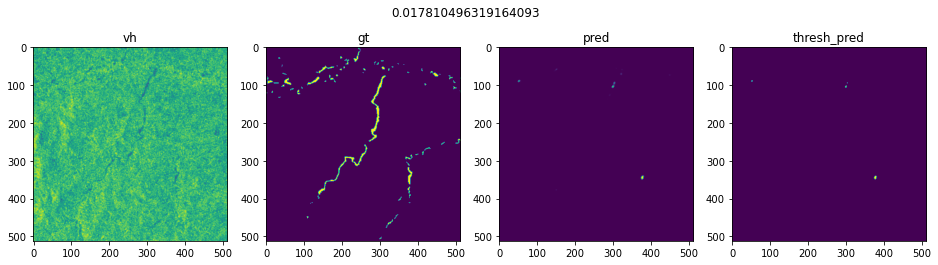

Epoch 18/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6385 - mae: 0.0686 - accuracy: 0.9430 - val_loss: 0.6127 - val_mae: 0.0772 - val_accuracy: 0.9416

Epoch 00018: val_loss did not improve from 0.56342


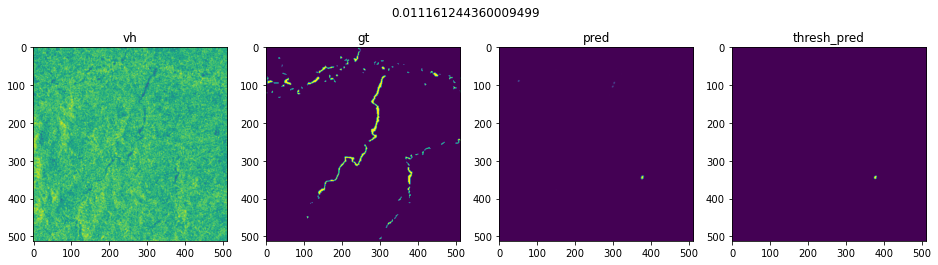

Epoch 19/70
108/108 [==============================] - 75s 691ms/step - loss: 0.5559 - mae: 0.0574 - accuracy: 0.9522 - val_loss: 0.6410 - val_mae: 0.0629 - val_accuracy: 0.9451

Epoch 00019: val_loss did not improve from 0.56342


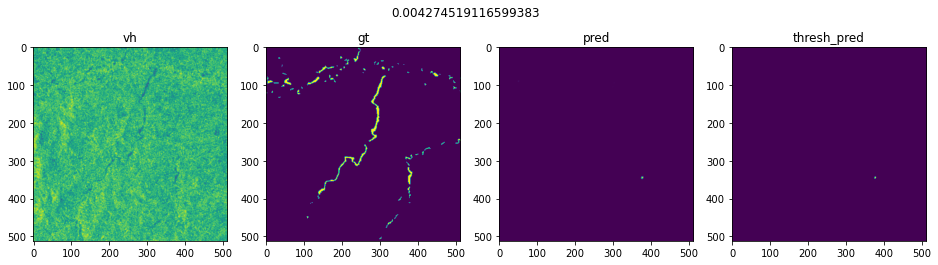

Epoch 20/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5983 - mae: 0.0669 - accuracy: 0.9408 - val_loss: 0.5589 - val_mae: 0.0552 - val_accuracy: 0.9512

Epoch 00020: val_loss improved from 0.56342 to 0.55889, saving model to unet_models/EfficientB4Unet_512_3_1.h5


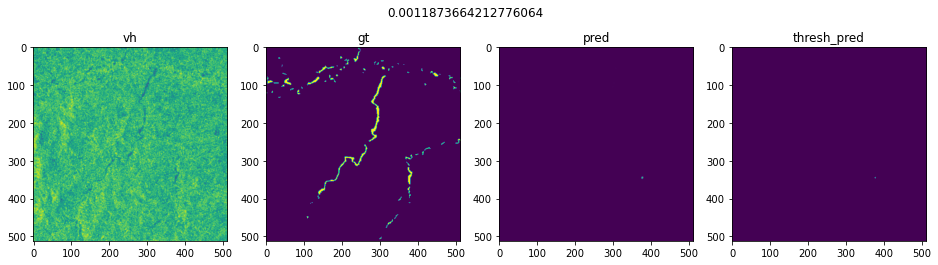

Epoch 21/70
108/108 [==============================] - 75s 691ms/step - loss: 0.6110 - mae: 0.0674 - accuracy: 0.9419 - val_loss: 0.5597 - val_mae: 0.0636 - val_accuracy: 0.9543

Epoch 00021: val_loss did not improve from 0.55889


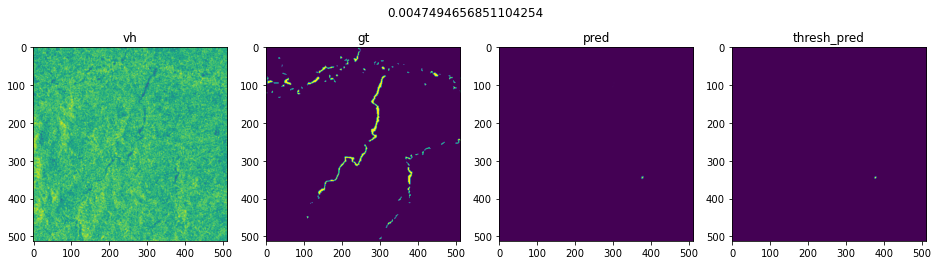

Epoch 22/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6006 - mae: 0.0630 - accuracy: 0.9460 - val_loss: 0.6110 - val_mae: 0.0595 - val_accuracy: 0.9502

Epoch 00022: val_loss did not improve from 0.55889


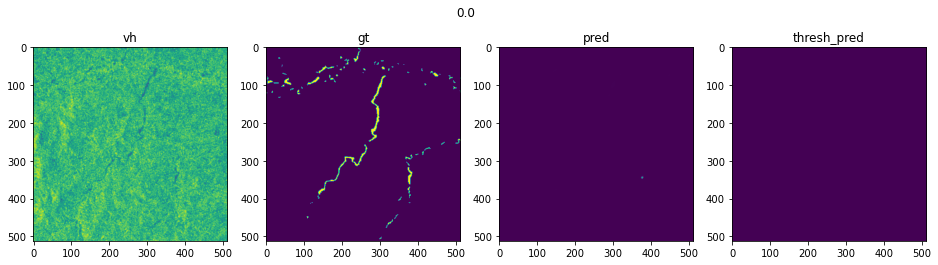

Epoch 23/70
108/108 [==============================] - 75s 690ms/step - loss: 0.6144 - mae: 0.0639 - accuracy: 0.9437 - val_loss: 0.5212 - val_mae: 0.0469 - val_accuracy: 0.9574

Epoch 00023: val_loss improved from 0.55889 to 0.52116, saving model to unet_models/EfficientB4Unet_512_3_1.h5


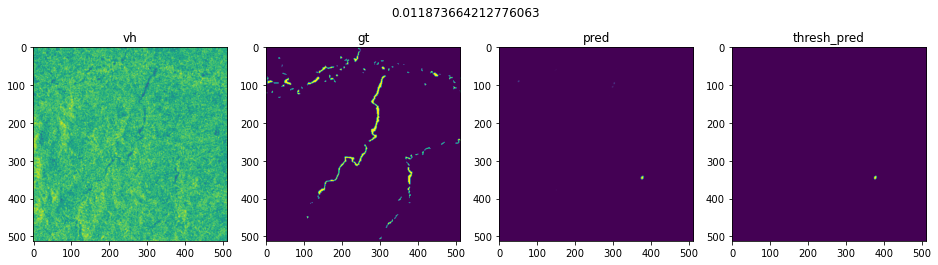

Epoch 24/70
108/108 [==============================] - 75s 691ms/step - loss: 0.6080 - mae: 0.0678 - accuracy: 0.9388 - val_loss: 0.5512 - val_mae: 0.0515 - val_accuracy: 0.9535

Epoch 00024: val_loss did not improve from 0.52116


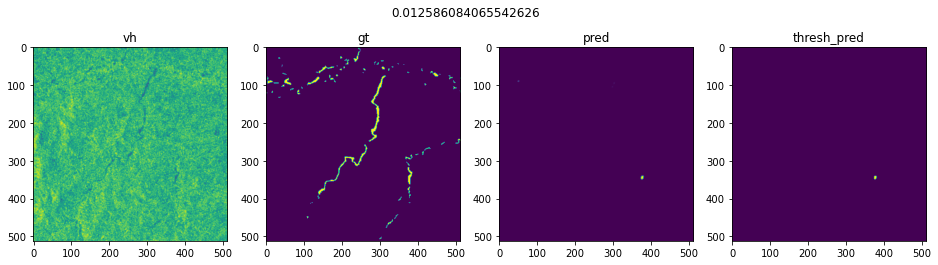

Epoch 25/70
108/108 [==============================] - 75s 691ms/step - loss: 0.5874 - mae: 0.0610 - accuracy: 0.9469 - val_loss: 0.5777 - val_mae: 0.0621 - val_accuracy: 0.9524

Epoch 00025: val_loss did not improve from 0.52116


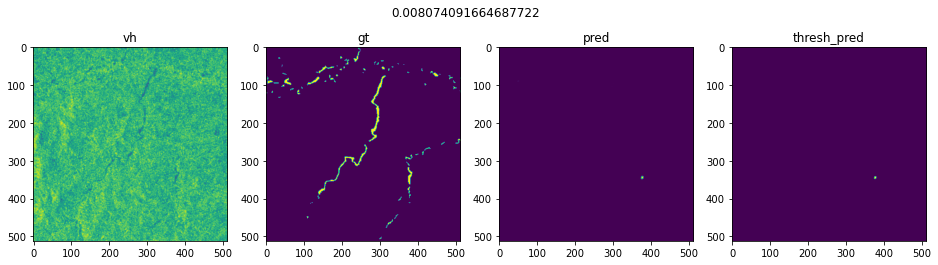

Epoch 26/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6119 - mae: 0.0628 - accuracy: 0.9459 - val_loss: 0.5183 - val_mae: 0.0503 - val_accuracy: 0.9547

Epoch 00026: val_loss improved from 0.52116 to 0.51828, saving model to unet_models/EfficientB4Unet_512_3_1.h5


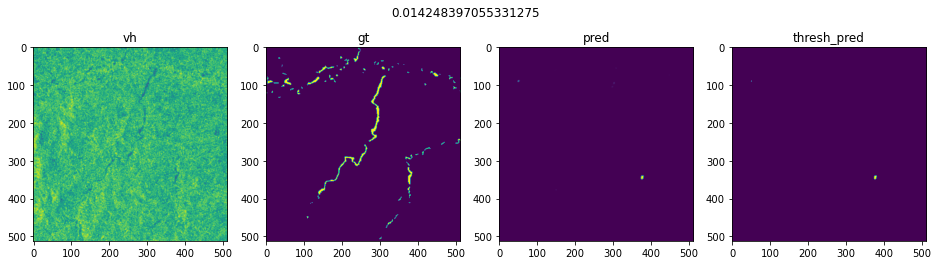

Epoch 27/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5758 - mae: 0.0630 - accuracy: 0.9455 - val_loss: 0.5873 - val_mae: 0.0672 - val_accuracy: 0.9524

Epoch 00027: val_loss did not improve from 0.51828


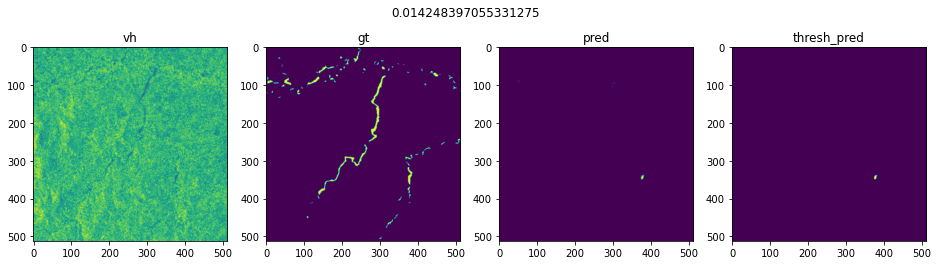

Epoch 28/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6223 - mae: 0.0729 - accuracy: 0.9366 - val_loss: 0.5652 - val_mae: 0.0603 - val_accuracy: 0.9468

Epoch 00028: val_loss did not improve from 0.51828


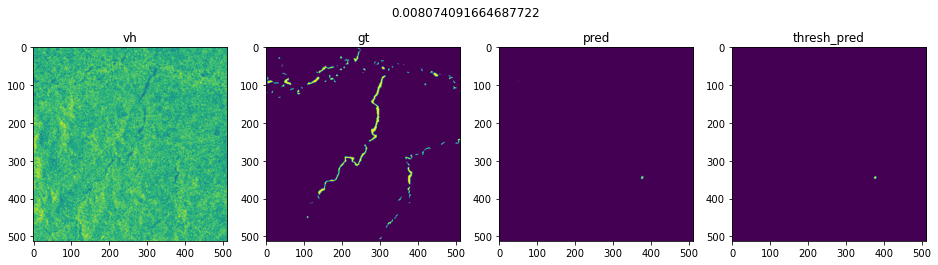

Epoch 29/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5211 - mae: 0.0534 - accuracy: 0.9531 - val_loss: 0.4852 - val_mae: 0.0481 - val_accuracy: 0.9603

Epoch 00029: val_loss improved from 0.51828 to 0.48518, saving model to unet_models/EfficientB4Unet_512_3_1.h5


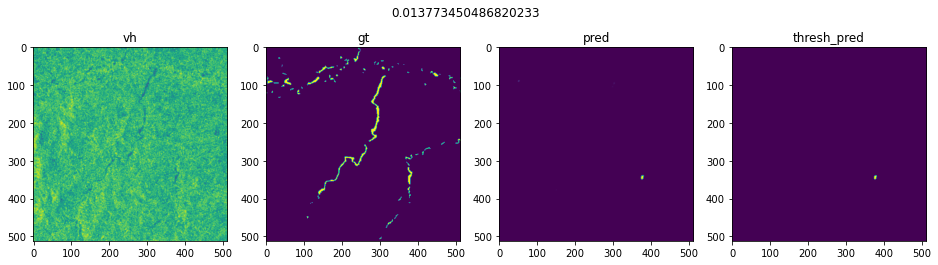

Epoch 30/70
108/108 [==============================] - 75s 694ms/step - loss: 0.5683 - mae: 0.0531 - accuracy: 0.9536 - val_loss: 0.5309 - val_mae: 0.0492 - val_accuracy: 0.9552

Epoch 00030: val_loss did not improve from 0.48518


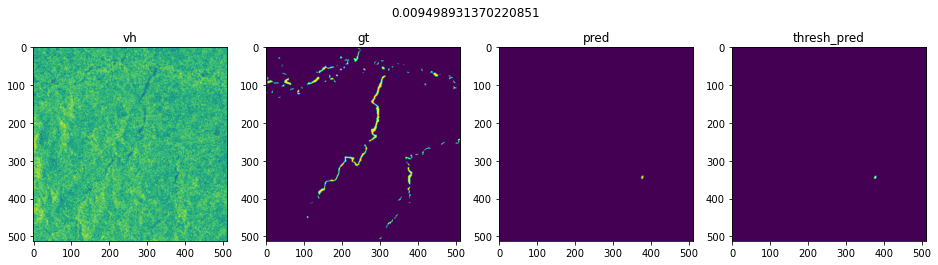

Epoch 31/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5902 - mae: 0.0607 - accuracy: 0.9467 - val_loss: 0.4937 - val_mae: 0.0529 - val_accuracy: 0.9613

Epoch 00031: val_loss did not improve from 0.48518


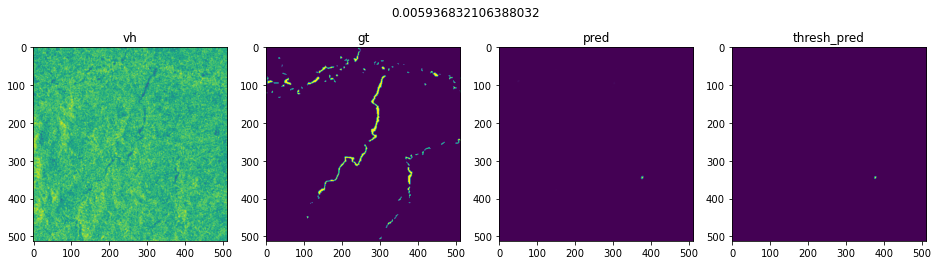

Epoch 32/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5522 - mae: 0.0594 - accuracy: 0.9487 - val_loss: 0.6756 - val_mae: 0.0664 - val_accuracy: 0.9420

Epoch 00032: val_loss did not improve from 0.48518


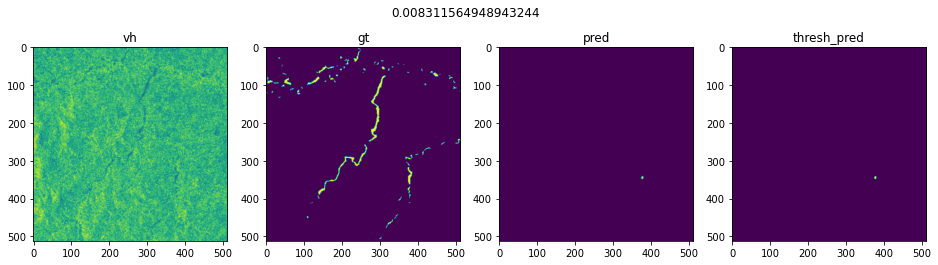

Epoch 33/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5408 - mae: 0.0547 - accuracy: 0.9516 - val_loss: 0.5992 - val_mae: 0.0623 - val_accuracy: 0.9474

Epoch 00033: val_loss did not improve from 0.48518


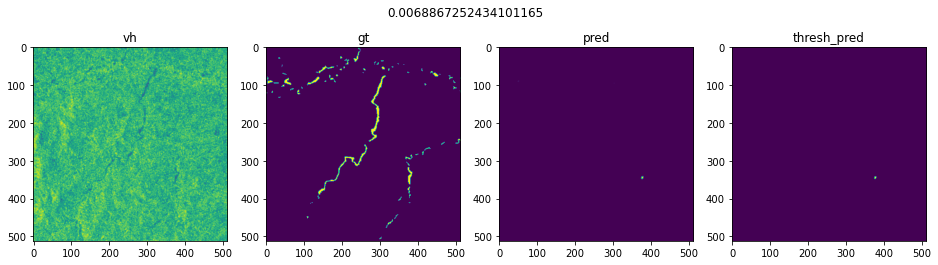

Epoch 34/70
108/108 [==============================] - 75s 691ms/step - loss: 0.5879 - mae: 0.0561 - accuracy: 0.9507 - val_loss: 0.5604 - val_mae: 0.0645 - val_accuracy: 0.9547

Epoch 00034: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00034: val_loss did not improve from 0.48518


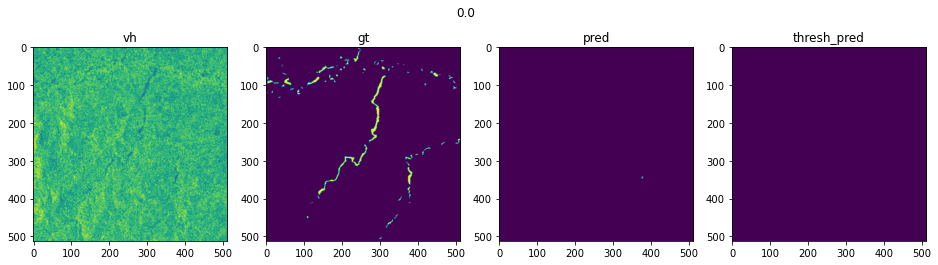

Epoch 35/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5921 - mae: 0.0620 - accuracy: 0.9444 - val_loss: 0.5034 - val_mae: 0.0476 - val_accuracy: 0.9590

Epoch 00035: val_loss did not improve from 0.48518


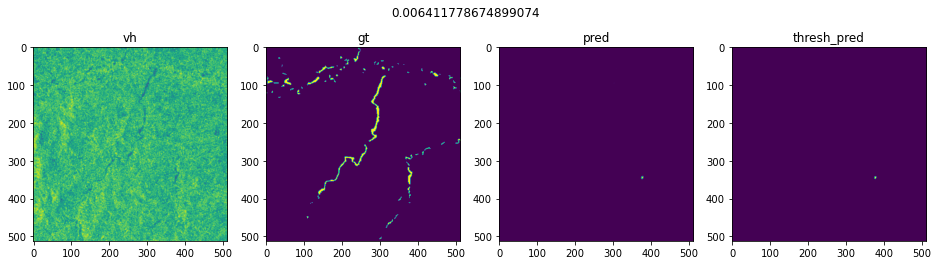

Epoch 36/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5524 - mae: 0.0518 - accuracy: 0.9545 - val_loss: 0.5195 - val_mae: 0.0500 - val_accuracy: 0.9572

Epoch 00036: val_loss did not improve from 0.48518


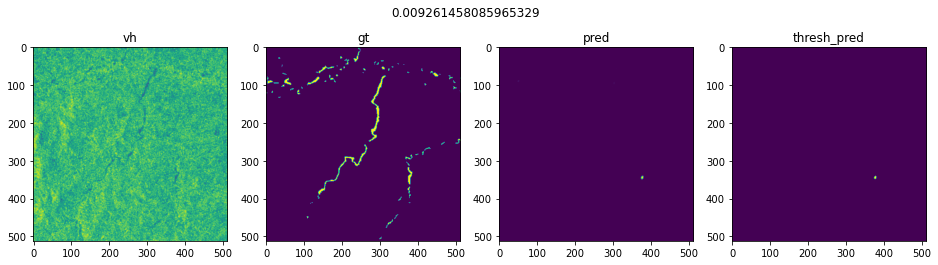

Epoch 37/70
108/108 [==============================] - 75s 691ms/step - loss: 0.5776 - mae: 0.0617 - accuracy: 0.9442 - val_loss: 0.5594 - val_mae: 0.0562 - val_accuracy: 0.9513

Epoch 00037: val_loss did not improve from 0.48518


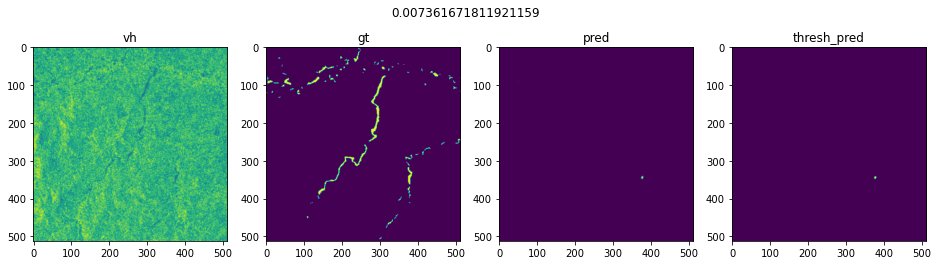

Epoch 38/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5473 - mae: 0.0563 - accuracy: 0.9509 - val_loss: 0.5557 - val_mae: 0.0561 - val_accuracy: 0.9525

Epoch 00038: val_loss did not improve from 0.48518


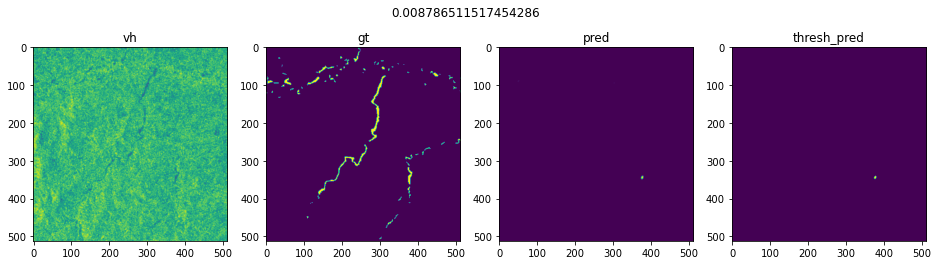

Epoch 39/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5278 - mae: 0.0536 - accuracy: 0.9537 - val_loss: 0.5169 - val_mae: 0.0509 - val_accuracy: 0.9553

Epoch 00039: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00039: val_loss did not improve from 0.48518


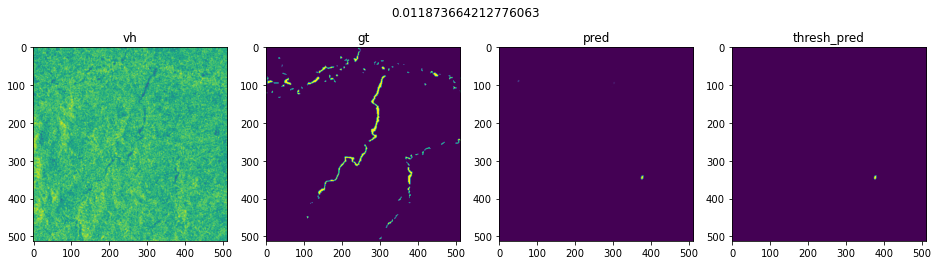

Epoch 40/70
108/108 [==============================] - 75s 692ms/step - loss: 0.4916 - mae: 0.0492 - accuracy: 0.9568 - val_loss: 0.5074 - val_mae: 0.0509 - val_accuracy: 0.9556

Epoch 00040: val_loss did not improve from 0.48518


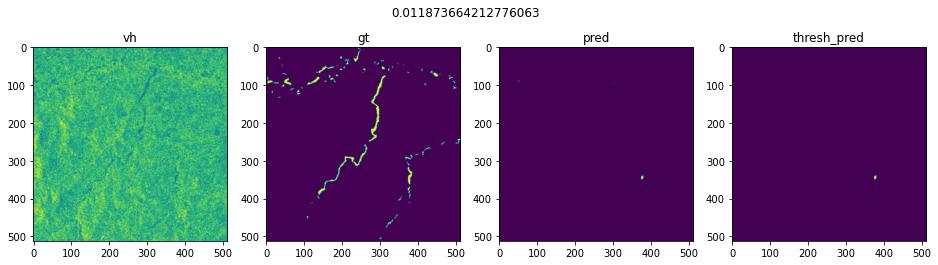

Epoch 41/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5141 - mae: 0.0543 - accuracy: 0.9521 - val_loss: 0.5252 - val_mae: 0.0527 - val_accuracy: 0.9541

Epoch 00041: val_loss did not improve from 0.48518


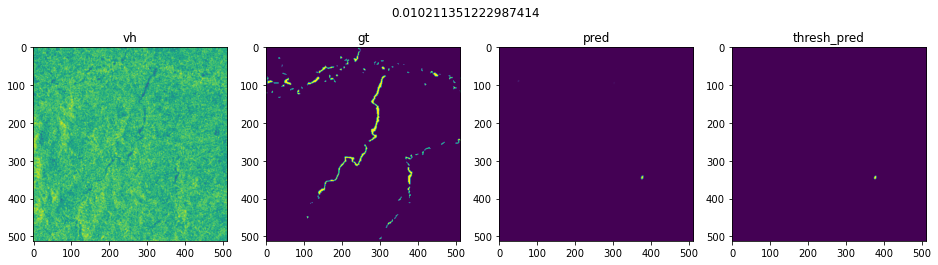

Epoch 42/70
108/108 [==============================] - 75s 693ms/step - loss: 0.4965 - mae: 0.0443 - accuracy: 0.9628 - val_loss: 0.5130 - val_mae: 0.0503 - val_accuracy: 0.9567

Epoch 00042: val_loss did not improve from 0.48518


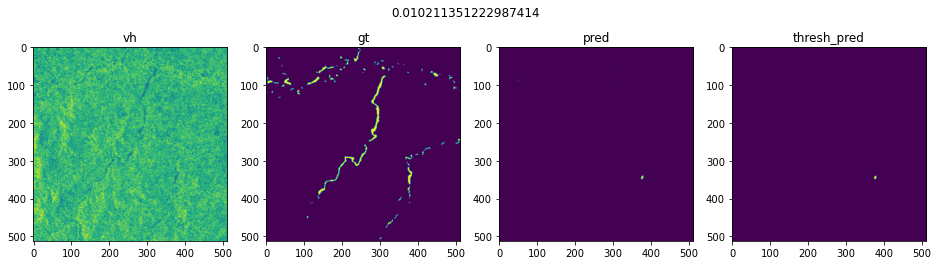

Epoch 43/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5409 - mae: 0.0564 - accuracy: 0.9513 - val_loss: 0.5255 - val_mae: 0.0530 - val_accuracy: 0.9532

Epoch 00043: val_loss did not improve from 0.48518


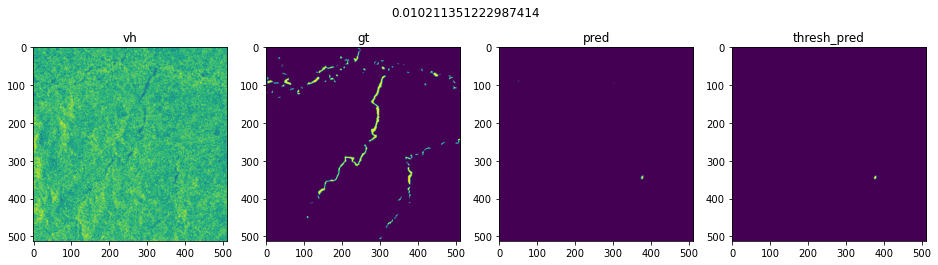

Epoch 44/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5201 - mae: 0.0573 - accuracy: 0.9495 - val_loss: 0.5257 - val_mae: 0.0527 - val_accuracy: 0.9537

Epoch 00044: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00044: val_loss did not improve from 0.48518


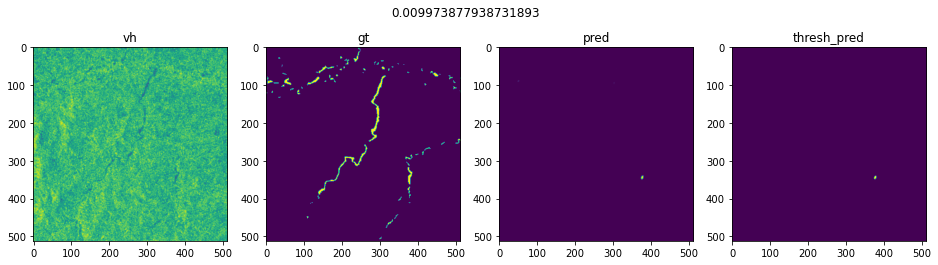

Epoch 00044: early stopping
Epoch 1/70
108/108 [==============================] - 89s 714ms/step - loss: 1.2530 - mae: 0.2882 - accuracy: 0.8454 - val_loss: 13.7255 - val_mae: 0.8458 - val_accuracy: 0.1542

Epoch 00001: val_loss improved from inf to 13.72554, saving model to unet_models/EfficientB4Unet_512_3_2.h5


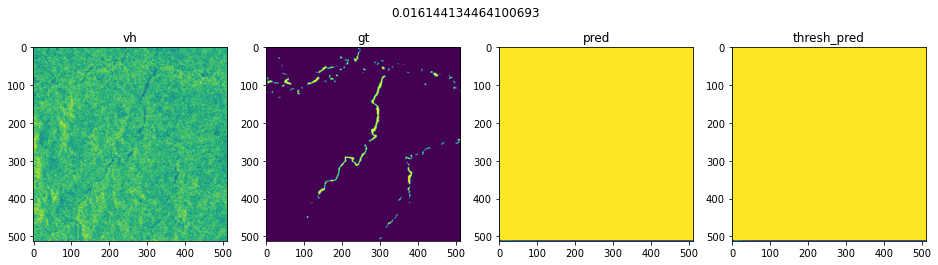

Epoch 2/70
108/108 [==============================] - 75s 697ms/step - loss: 0.9292 - mae: 0.1071 - accuracy: 0.9243 - val_loss: 0.9509 - val_mae: 0.1041 - val_accuracy: 0.9126

Epoch 00002: val_loss improved from 13.72554 to 0.95095, saving model to unet_models/EfficientB4Unet_512_3_2.h5


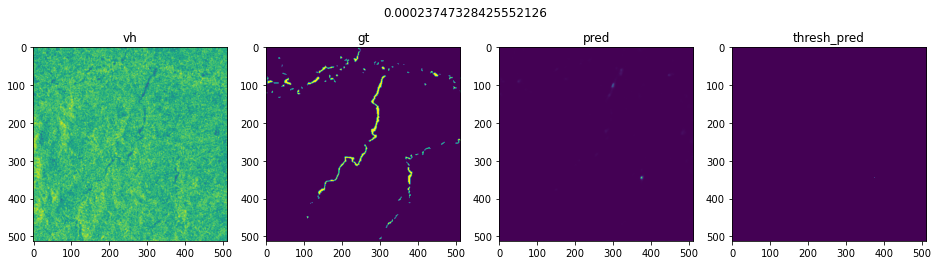

Epoch 3/70
108/108 [==============================] - 75s 695ms/step - loss: 0.8338 - mae: 0.1011 - accuracy: 0.9187 - val_loss: 1.8094 - val_mae: 0.3746 - val_accuracy: 0.5967

Epoch 00003: val_loss did not improve from 0.95095


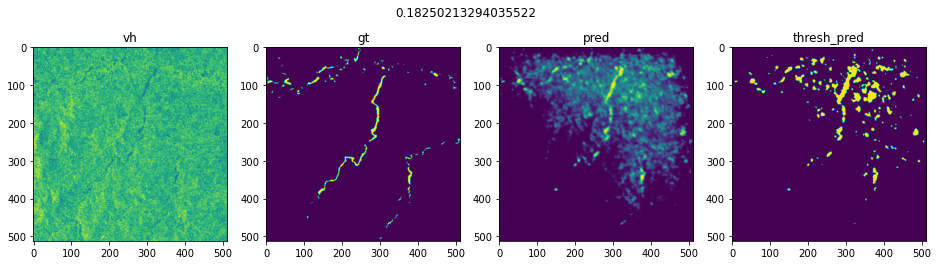

Epoch 4/70
108/108 [==============================] - 75s 695ms/step - loss: 0.7684 - mae: 0.0894 - accuracy: 0.9257 - val_loss: 0.6249 - val_mae: 0.0611 - val_accuracy: 0.9427

Epoch 00004: val_loss improved from 0.95095 to 0.62488, saving model to unet_models/EfficientB4Unet_512_3_2.h5


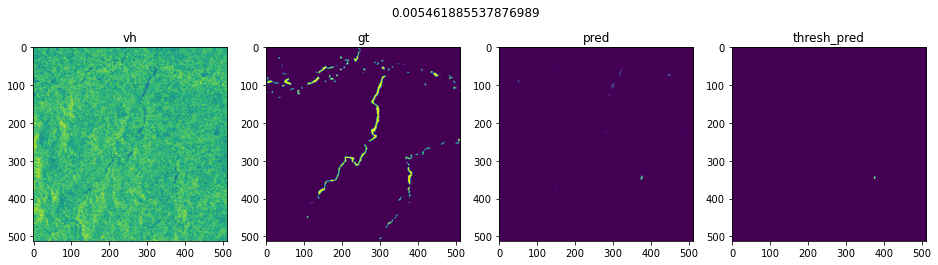

Epoch 5/70
108/108 [==============================] - 75s 695ms/step - loss: 0.6696 - mae: 0.0717 - accuracy: 0.9420 - val_loss: 0.7588 - val_mae: 0.0627 - val_accuracy: 0.9402

Epoch 00005: val_loss did not improve from 0.62488


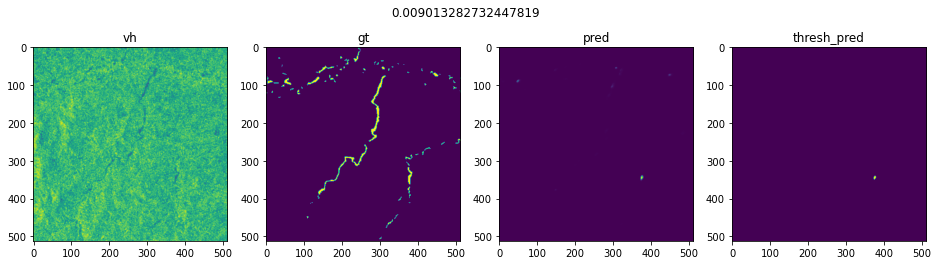

Epoch 6/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6783 - mae: 0.0680 - accuracy: 0.9430 - val_loss: 0.7410 - val_mae: 0.0975 - val_accuracy: 0.9307

Epoch 00006: val_loss did not improve from 0.62488


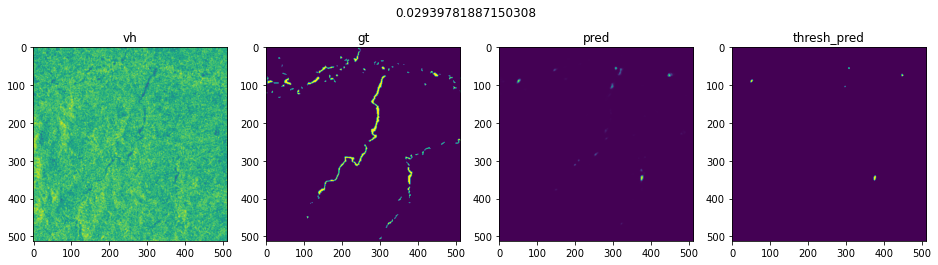

Epoch 7/70
108/108 [==============================] - 75s 696ms/step - loss: 0.7444 - mae: 0.0788 - accuracy: 0.9315 - val_loss: 1.6597 - val_mae: 0.1213 - val_accuracy: 0.8795

Epoch 00007: val_loss did not improve from 0.62488


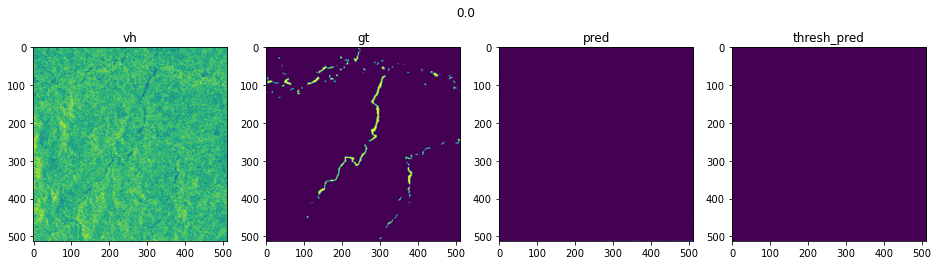

Epoch 8/70
108/108 [==============================] - 75s 695ms/step - loss: 0.6375 - mae: 0.0638 - accuracy: 0.9466 - val_loss: 0.7444 - val_mae: 0.0663 - val_accuracy: 0.9376

Epoch 00008: val_loss did not improve from 0.62488


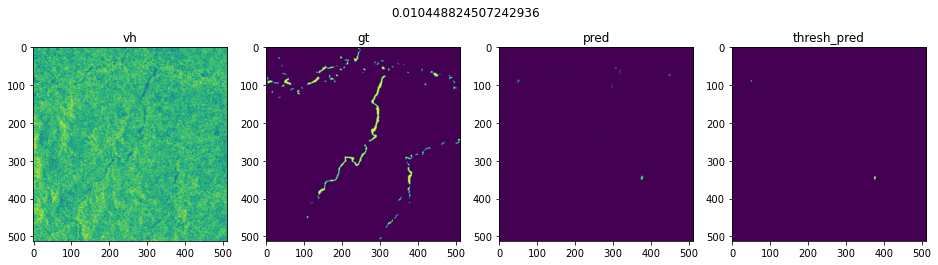

Epoch 9/70
108/108 [==============================] - 75s 696ms/step - loss: 0.6225 - mae: 0.0641 - accuracy: 0.9442 - val_loss: 0.5992 - val_mae: 0.0613 - val_accuracy: 0.9460

Epoch 00009: val_loss improved from 0.62488 to 0.59924, saving model to unet_models/EfficientB4Unet_512_3_2.h5


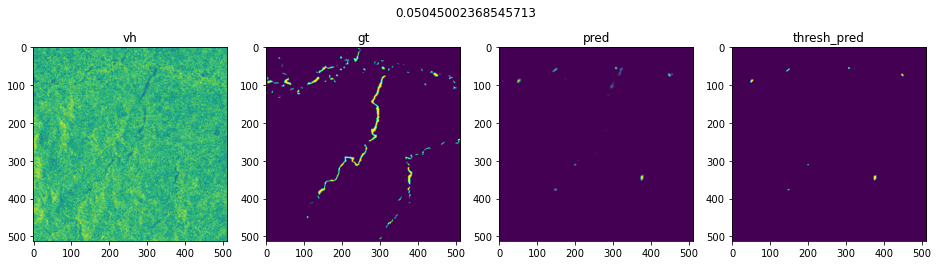

Epoch 10/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6517 - mae: 0.0614 - accuracy: 0.9466 - val_loss: 0.5818 - val_mae: 0.0595 - val_accuracy: 0.9457

Epoch 00010: val_loss improved from 0.59924 to 0.58185, saving model to unet_models/EfficientB4Unet_512_3_2.h5


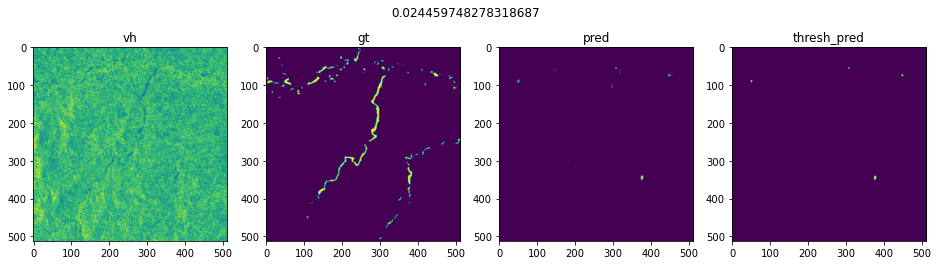

Epoch 11/70
108/108 [==============================] - 75s 696ms/step - loss: 0.6395 - mae: 0.0595 - accuracy: 0.9470 - val_loss: 0.8003 - val_mae: 0.1093 - val_accuracy: 0.8833

Epoch 00011: val_loss did not improve from 0.58185


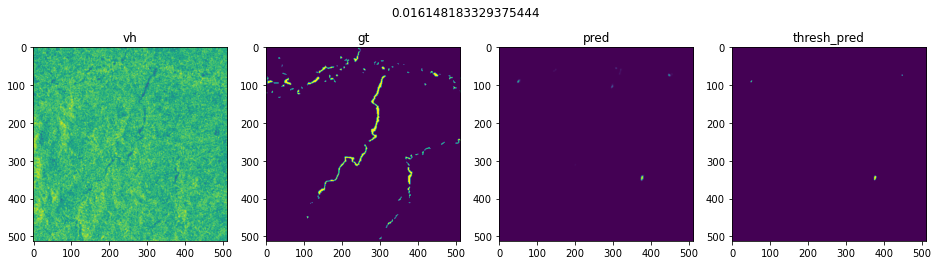

Epoch 12/70
108/108 [==============================] - 75s 696ms/step - loss: 0.6618 - mae: 0.0607 - accuracy: 0.9458 - val_loss: 0.6396 - val_mae: 0.0803 - val_accuracy: 0.9431

Epoch 00012: val_loss did not improve from 0.58185


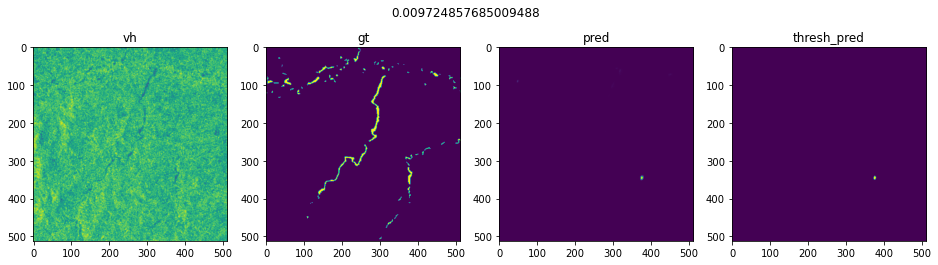

Epoch 13/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5982 - mae: 0.0577 - accuracy: 0.9493 - val_loss: 0.6538 - val_mae: 0.0639 - val_accuracy: 0.9401

Epoch 00013: val_loss did not improve from 0.58185


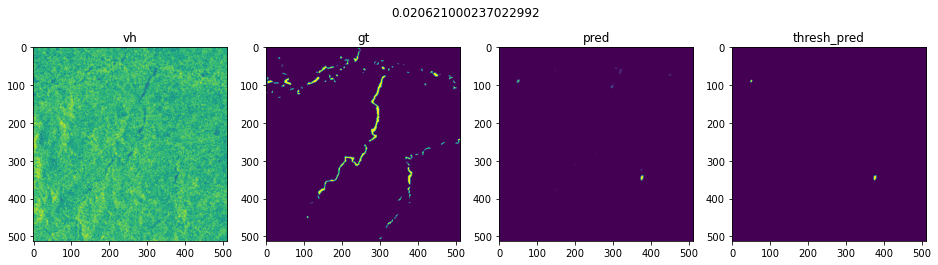

Epoch 14/70
108/108 [==============================] - 75s 695ms/step - loss: 0.6287 - mae: 0.0606 - accuracy: 0.9480 - val_loss: 0.6618 - val_mae: 0.0699 - val_accuracy: 0.9382

Epoch 00014: val_loss did not improve from 0.58185


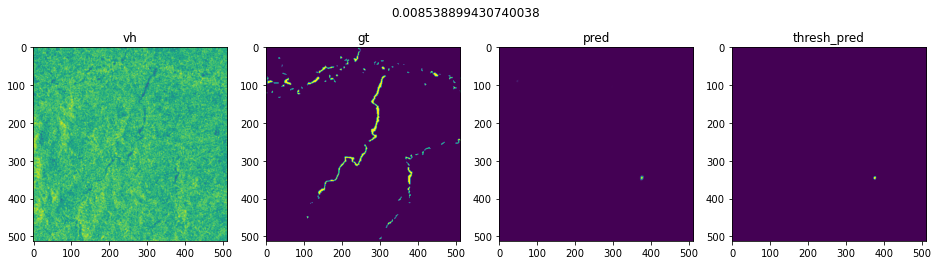

Epoch 15/70
108/108 [==============================] - 75s 695ms/step - loss: 0.6221 - mae: 0.0573 - accuracy: 0.9497 - val_loss: 0.5836 - val_mae: 0.0594 - val_accuracy: 0.9437

Epoch 00015: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00015: val_loss did not improve from 0.58185


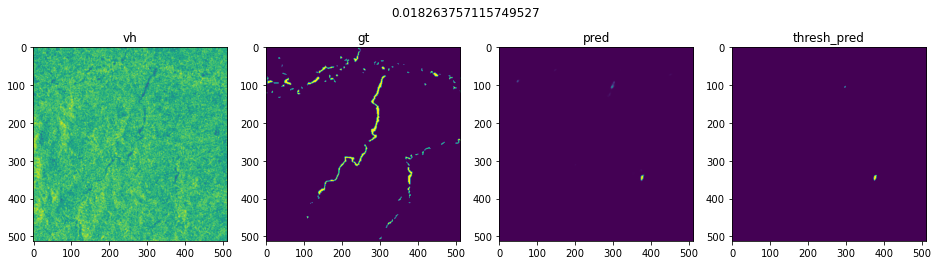

Epoch 16/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6263 - mae: 0.0684 - accuracy: 0.9363 - val_loss: 0.5782 - val_mae: 0.0625 - val_accuracy: 0.9434

Epoch 00016: val_loss improved from 0.58185 to 0.57821, saving model to unet_models/EfficientB4Unet_512_3_2.h5


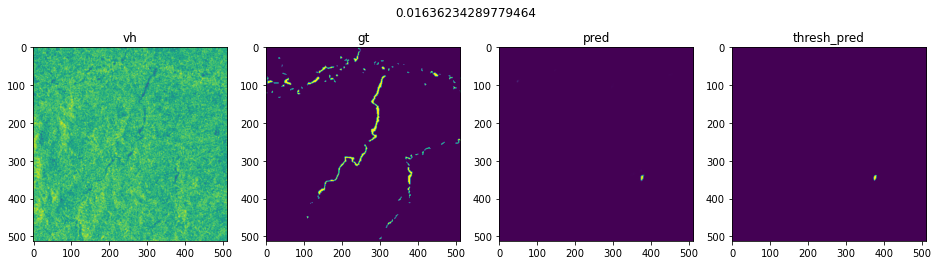

Epoch 17/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5570 - mae: 0.0586 - accuracy: 0.9476 - val_loss: 0.6235 - val_mae: 0.0709 - val_accuracy: 0.9419

Epoch 00017: val_loss did not improve from 0.57821


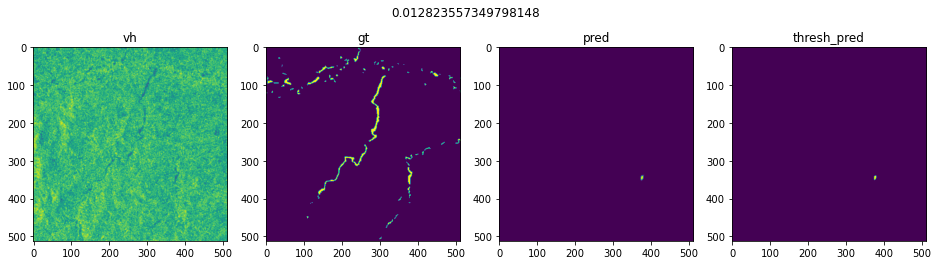

Epoch 18/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5642 - mae: 0.0542 - accuracy: 0.9521 - val_loss: 0.6179 - val_mae: 0.0660 - val_accuracy: 0.9411

Epoch 00018: val_loss did not improve from 0.57821


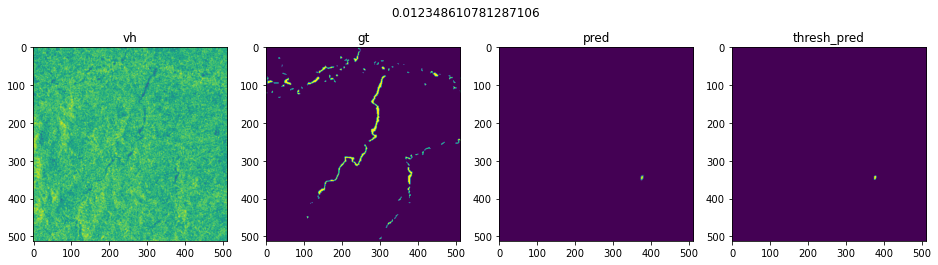

Epoch 19/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5686 - mae: 0.0546 - accuracy: 0.9517 - val_loss: 0.5995 - val_mae: 0.0649 - val_accuracy: 0.9423

Epoch 00019: val_loss did not improve from 0.57821


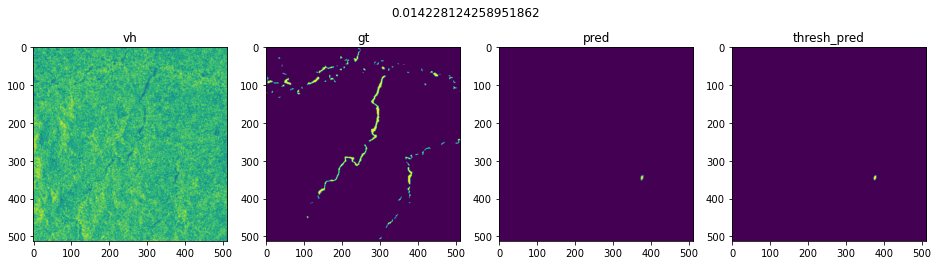

Epoch 20/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5572 - mae: 0.0501 - accuracy: 0.9552 - val_loss: 0.5803 - val_mae: 0.0619 - val_accuracy: 0.9442

Epoch 00020: val_loss did not improve from 0.57821


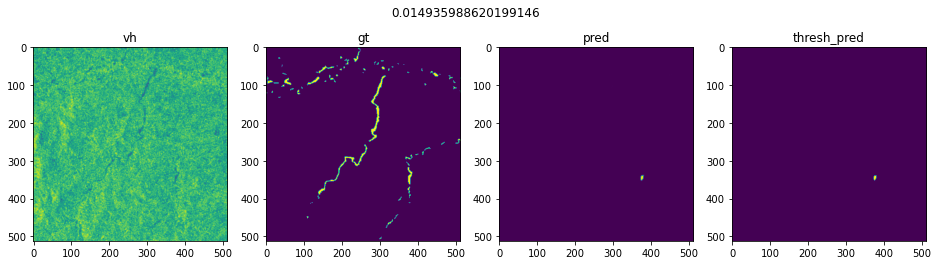

Epoch 21/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5412 - mae: 0.0528 - accuracy: 0.9532 - val_loss: 0.5847 - val_mae: 0.0618 - val_accuracy: 0.9440

Epoch 00021: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00021: val_loss did not improve from 0.57821


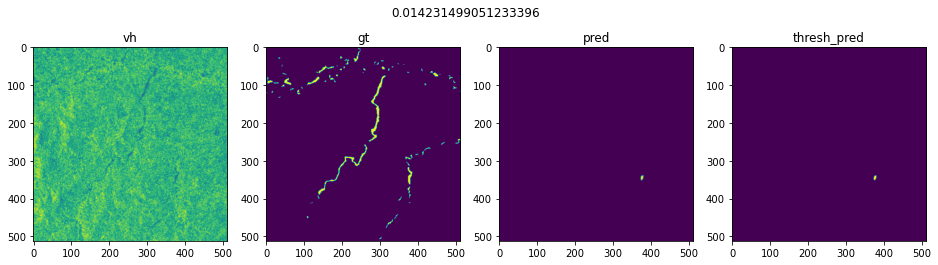

Epoch 22/70
108/108 [==============================] - 75s 697ms/step - loss: 0.5422 - mae: 0.0533 - accuracy: 0.9520 - val_loss: 0.5859 - val_mae: 0.0621 - val_accuracy: 0.9441

Epoch 00022: val_loss did not improve from 0.57821


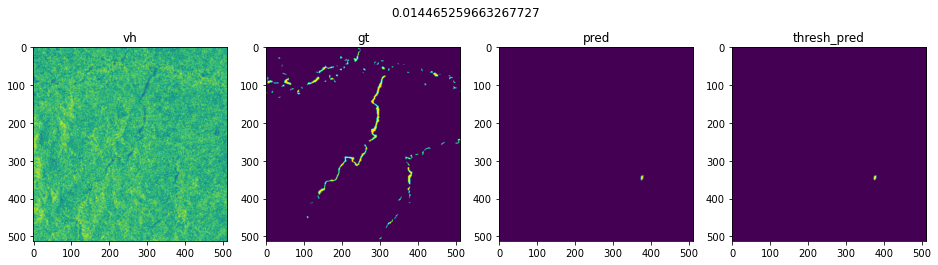

Epoch 23/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5982 - mae: 0.0598 - accuracy: 0.9462 - val_loss: 0.5817 - val_mae: 0.0623 - val_accuracy: 0.9439

Epoch 00023: val_loss did not improve from 0.57821


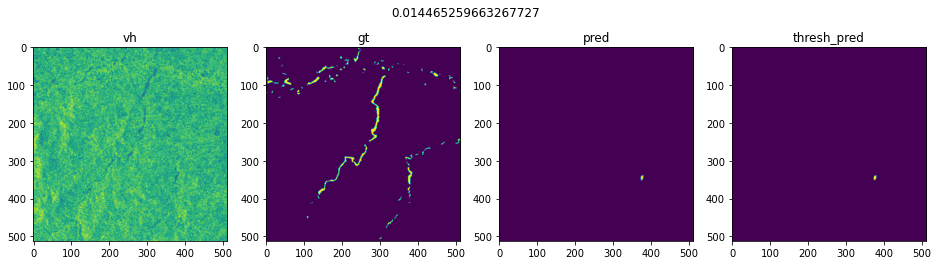

Epoch 24/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5557 - mae: 0.0528 - accuracy: 0.9523 - val_loss: 0.5907 - val_mae: 0.0631 - val_accuracy: 0.9434

Epoch 00024: val_loss did not improve from 0.57821


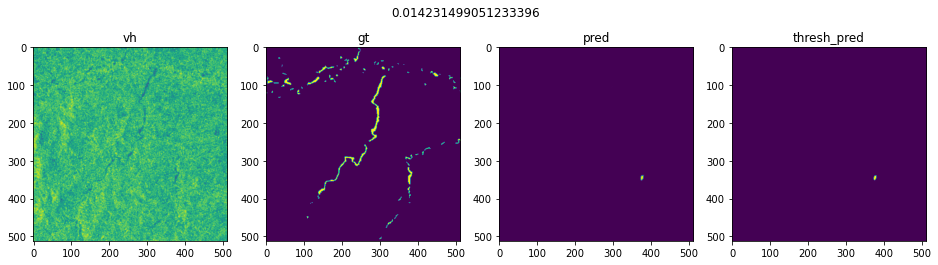

Epoch 25/70
108/108 [==============================] - 75s 698ms/step - loss: 0.5535 - mae: 0.0541 - accuracy: 0.9523 - val_loss: 0.5960 - val_mae: 0.0633 - val_accuracy: 0.9431

Epoch 00025: val_loss did not improve from 0.57821


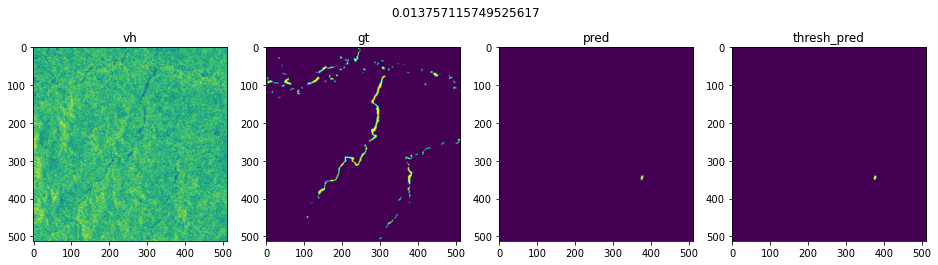

Epoch 26/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5459 - mae: 0.0508 - accuracy: 0.9562 - val_loss: 0.5849 - val_mae: 0.0626 - val_accuracy: 0.9440

Epoch 00026: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00026: val_loss did not improve from 0.57821


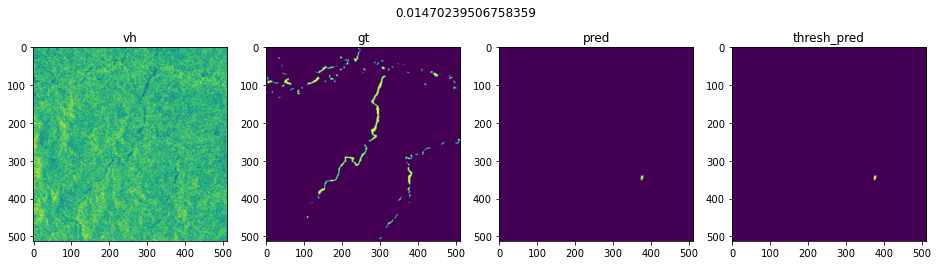

Epoch 27/70
108/108 [==============================] - 75s 696ms/step - loss: 0.4969 - mae: 0.0457 - accuracy: 0.9604 - val_loss: 0.5836 - val_mae: 0.0625 - val_accuracy: 0.9440

Epoch 00027: val_loss did not improve from 0.57821


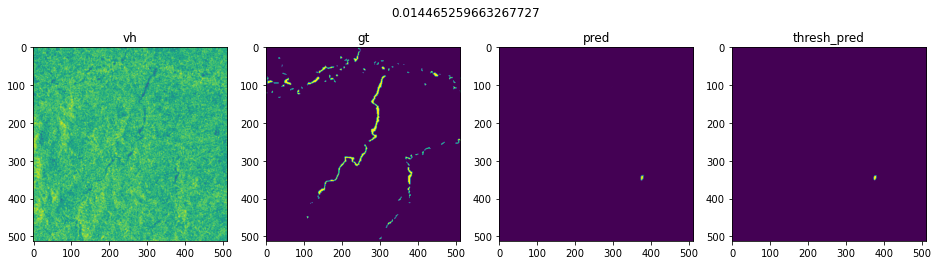

Epoch 28/70
108/108 [==============================] - 75s 695ms/step - loss: 0.6208 - mae: 0.0573 - accuracy: 0.9486 - val_loss: 0.5926 - val_mae: 0.0628 - val_accuracy: 0.9434

Epoch 00028: val_loss did not improve from 0.57821


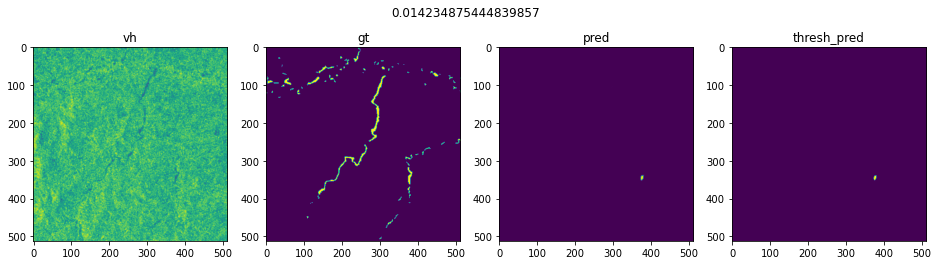

Epoch 29/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5726 - mae: 0.0540 - accuracy: 0.9513 - val_loss: 0.5876 - val_mae: 0.0627 - val_accuracy: 0.9435

Epoch 00029: val_loss did not improve from 0.57821


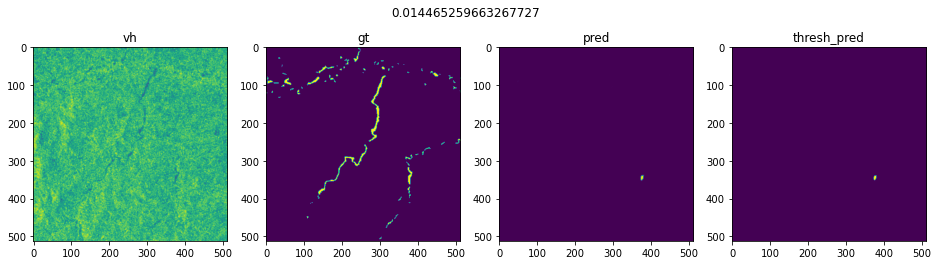

Epoch 30/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5922 - mae: 0.0598 - accuracy: 0.9466 - val_loss: 0.5784 - val_mae: 0.0621 - val_accuracy: 0.9441

Epoch 00030: val_loss did not improve from 0.57821


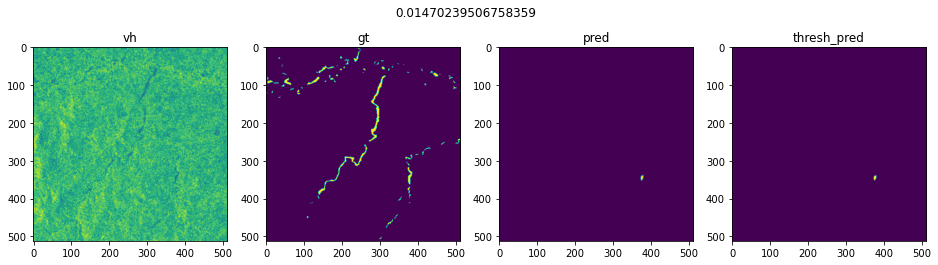

Epoch 31/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5176 - mae: 0.0453 - accuracy: 0.9609 - val_loss: 0.5777 - val_mae: 0.0621 - val_accuracy: 0.9442

Epoch 00031: val_loss improved from 0.57821 to 0.57765, saving model to unet_models/EfficientB4Unet_512_3_2.h5


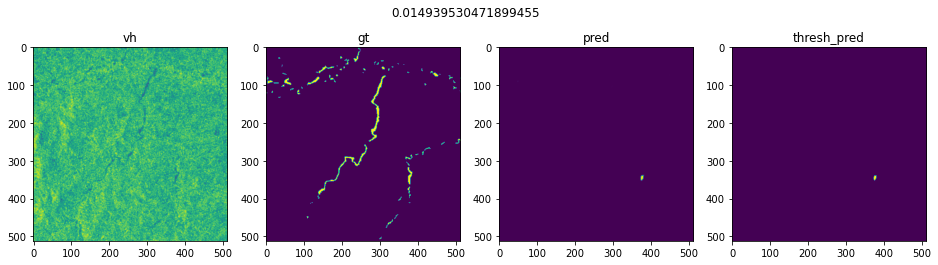

Epoch 32/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5535 - mae: 0.0512 - accuracy: 0.9563 - val_loss: 0.5854 - val_mae: 0.0626 - val_accuracy: 0.9437

Epoch 00032: val_loss did not improve from 0.57765


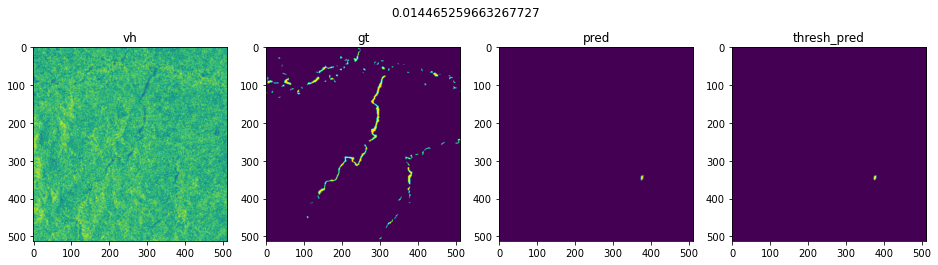

Epoch 33/70
108/108 [==============================] - 75s 697ms/step - loss: 0.5885 - mae: 0.0573 - accuracy: 0.9482 - val_loss: 0.5793 - val_mae: 0.0622 - val_accuracy: 0.9438

Epoch 00033: val_loss did not improve from 0.57765


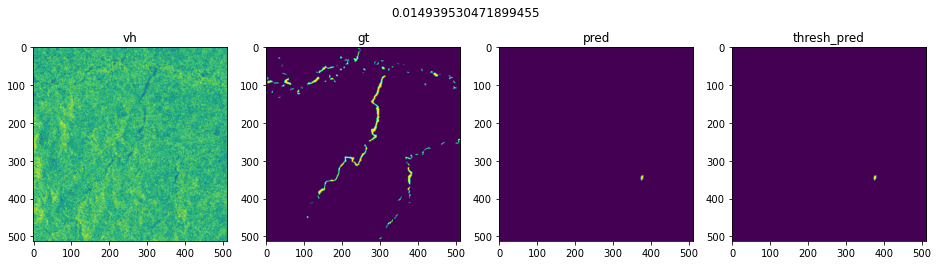

Epoch 34/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5535 - mae: 0.0528 - accuracy: 0.9528 - val_loss: 0.5978 - val_mae: 0.0631 - val_accuracy: 0.9428

Epoch 00034: val_loss did not improve from 0.57765


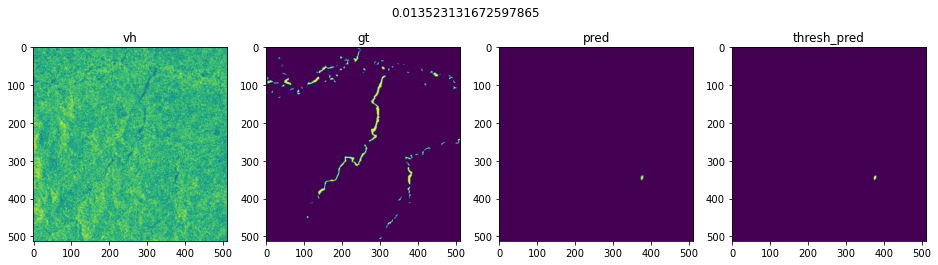

Epoch 35/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5666 - mae: 0.0550 - accuracy: 0.9510 - val_loss: 0.5816 - val_mae: 0.0626 - val_accuracy: 0.9437

Epoch 00035: val_loss did not improve from 0.57765


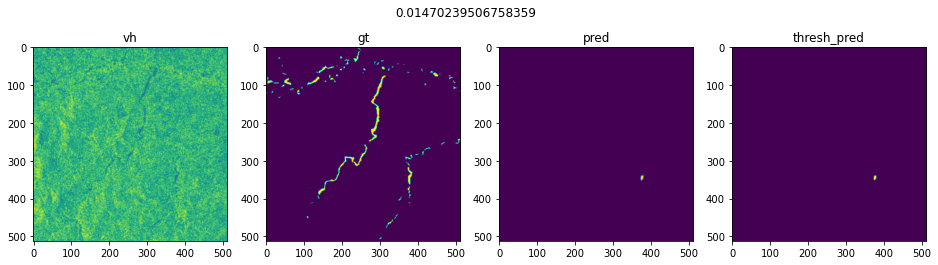

Epoch 36/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5738 - mae: 0.0553 - accuracy: 0.9506 - val_loss: 0.5793 - val_mae: 0.0623 - val_accuracy: 0.9441

Epoch 00036: ReduceLROnPlateau reducing learning rate to 1e-06.

Epoch 00036: val_loss did not improve from 0.57765


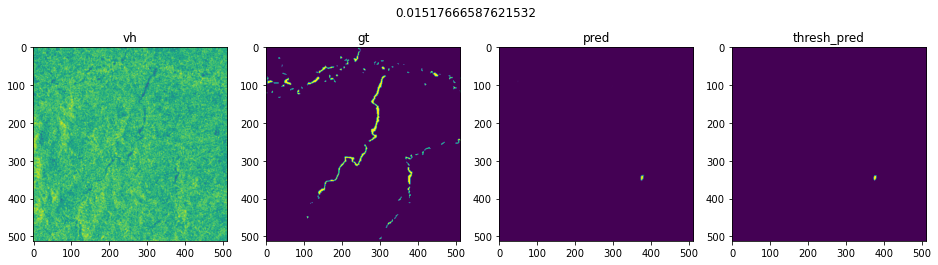

Epoch 37/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5573 - mae: 0.0525 - accuracy: 0.9539 - val_loss: 0.5809 - val_mae: 0.0624 - val_accuracy: 0.9443

Epoch 00037: val_loss did not improve from 0.57765


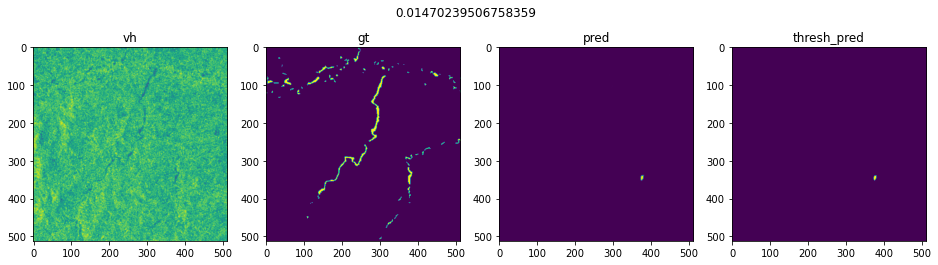

Epoch 38/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5663 - mae: 0.0581 - accuracy: 0.9481 - val_loss: 0.5852 - val_mae: 0.0626 - val_accuracy: 0.9439

Epoch 00038: val_loss did not improve from 0.57765


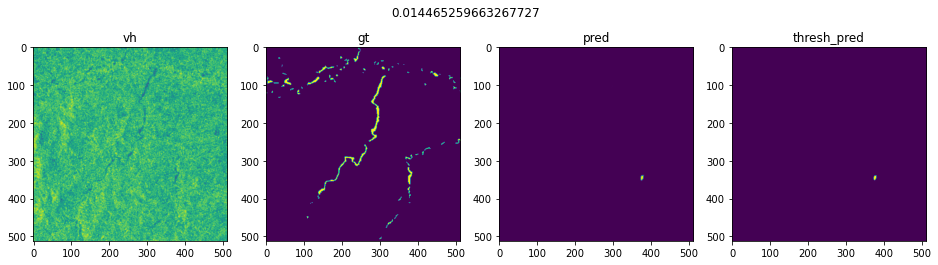

Epoch 39/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5863 - mae: 0.0575 - accuracy: 0.9492 - val_loss: 0.5890 - val_mae: 0.0628 - val_accuracy: 0.9436

Epoch 00039: val_loss did not improve from 0.57765


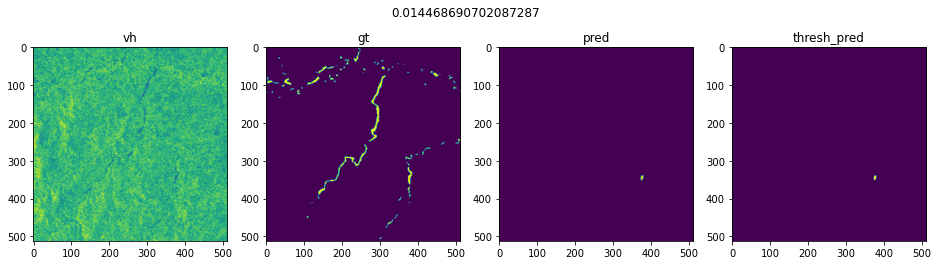

Epoch 40/70
108/108 [==============================] - 76s 699ms/step - loss: 0.5679 - mae: 0.0576 - accuracy: 0.9489 - val_loss: 0.5770 - val_mae: 0.0620 - val_accuracy: 0.9443

Epoch 00040: val_loss improved from 0.57765 to 0.57701, saving model to unet_models/EfficientB4Unet_512_3_2.h5


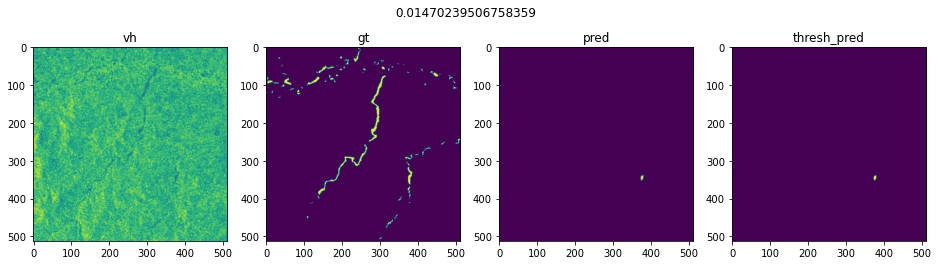

Epoch 41/70
108/108 [==============================] - 75s 694ms/step - loss: 0.5613 - mae: 0.0531 - accuracy: 0.9526 - val_loss: 0.5832 - val_mae: 0.0624 - val_accuracy: 0.9439

Epoch 00041: val_loss did not improve from 0.57701


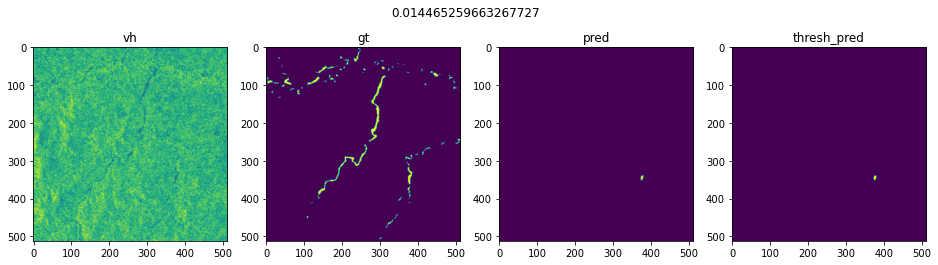

Epoch 42/70
108/108 [==============================] - 75s 695ms/step - loss: 0.6176 - mae: 0.0613 - accuracy: 0.9436 - val_loss: 0.5704 - val_mae: 0.0618 - val_accuracy: 0.9445

Epoch 00042: val_loss improved from 0.57701 to 0.57041, saving model to unet_models/EfficientB4Unet_512_3_2.h5


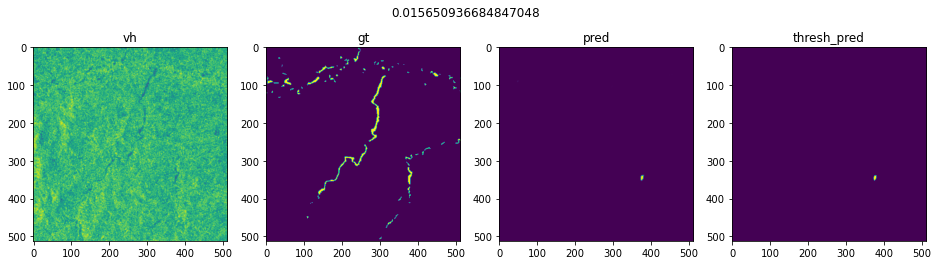

Epoch 43/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5642 - mae: 0.0554 - accuracy: 0.9510 - val_loss: 0.5773 - val_mae: 0.0620 - val_accuracy: 0.9443

Epoch 00043: val_loss did not improve from 0.57041


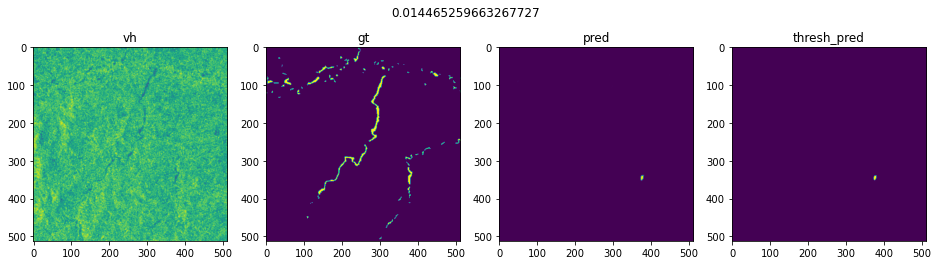

Epoch 44/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5690 - mae: 0.0537 - accuracy: 0.9530 - val_loss: 0.5835 - val_mae: 0.0624 - val_accuracy: 0.9438

Epoch 00044: val_loss did not improve from 0.57041


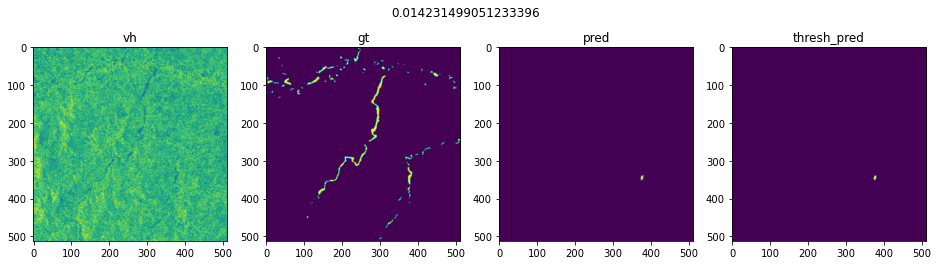

Epoch 45/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5601 - mae: 0.0560 - accuracy: 0.9514 - val_loss: 0.5825 - val_mae: 0.0630 - val_accuracy: 0.9437

Epoch 00045: val_loss did not improve from 0.57041


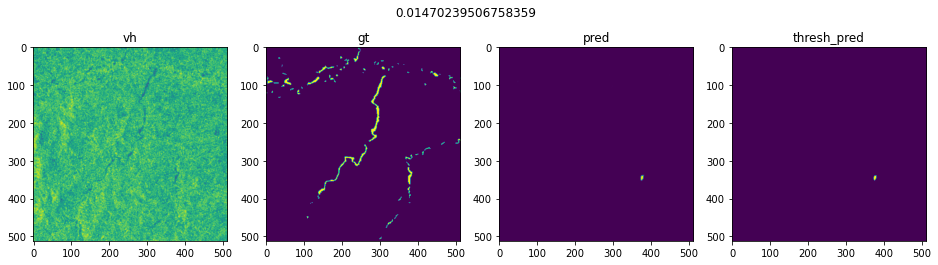

Epoch 46/70
108/108 [==============================] - 75s 697ms/step - loss: 0.5610 - mae: 0.0544 - accuracy: 0.9525 - val_loss: 0.5804 - val_mae: 0.0627 - val_accuracy: 0.9439

Epoch 00046: val_loss did not improve from 0.57041


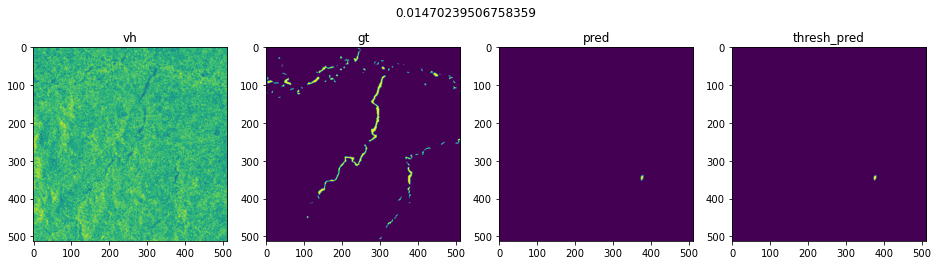

Epoch 47/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5166 - mae: 0.0536 - accuracy: 0.9536 - val_loss: 0.5864 - val_mae: 0.0631 - val_accuracy: 0.9435

Epoch 00047: val_loss did not improve from 0.57041


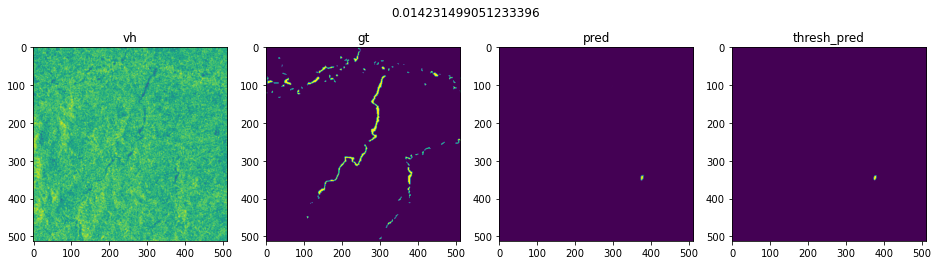

Epoch 48/70
108/108 [==============================] - 75s 697ms/step - loss: 0.5623 - mae: 0.0554 - accuracy: 0.9508 - val_loss: 0.5873 - val_mae: 0.0624 - val_accuracy: 0.9435

Epoch 00048: val_loss did not improve from 0.57041


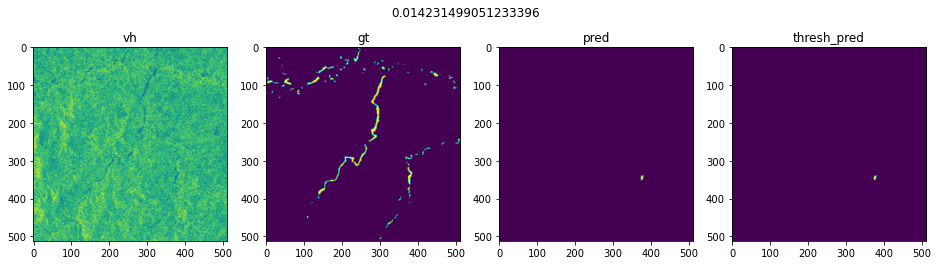

Epoch 49/70
108/108 [==============================] - 75s 693ms/step - loss: 0.4998 - mae: 0.0511 - accuracy: 0.9559 - val_loss: 0.5930 - val_mae: 0.0629 - val_accuracy: 0.9435

Epoch 00049: val_loss did not improve from 0.57041


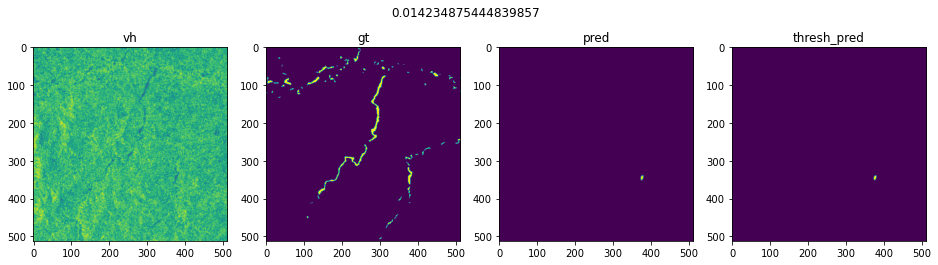

Epoch 50/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5795 - mae: 0.0598 - accuracy: 0.9458 - val_loss: 0.5896 - val_mae: 0.0629 - val_accuracy: 0.9434

Epoch 00050: val_loss did not improve from 0.57041


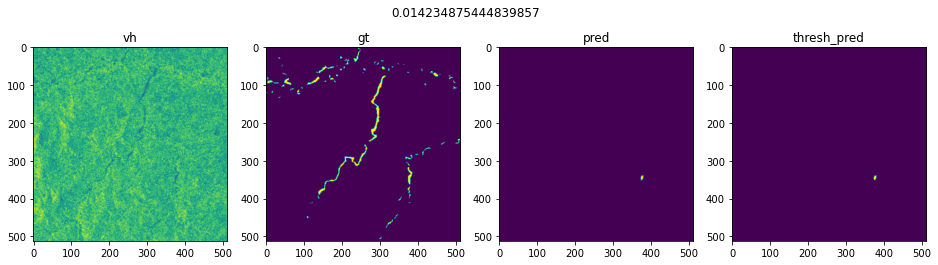

Epoch 51/70
108/108 [==============================] - 75s 697ms/step - loss: 0.5694 - mae: 0.0582 - accuracy: 0.9484 - val_loss: 0.5832 - val_mae: 0.0628 - val_accuracy: 0.9438

Epoch 00051: val_loss did not improve from 0.57041


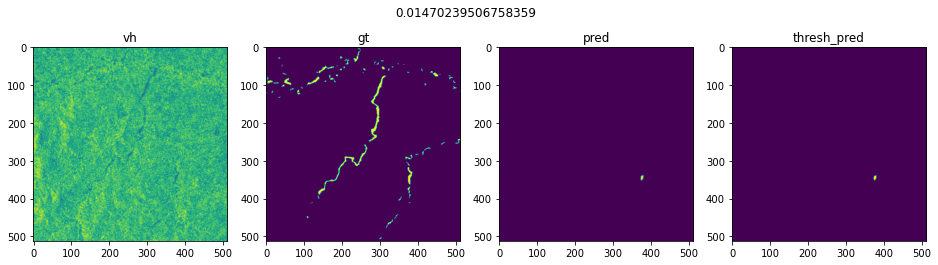

Epoch 52/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5868 - mae: 0.0622 - accuracy: 0.9450 - val_loss: 0.5818 - val_mae: 0.0621 - val_accuracy: 0.9443

Epoch 00052: val_loss did not improve from 0.57041


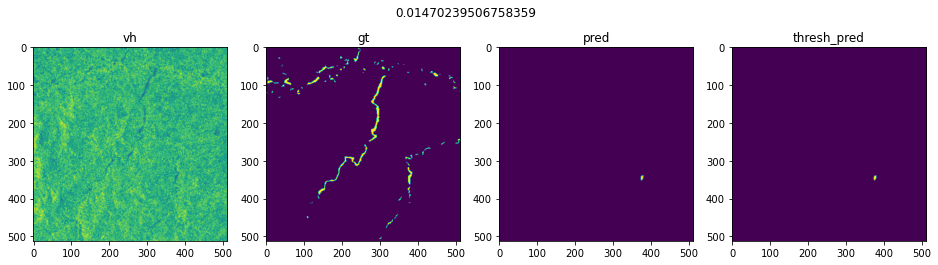

Epoch 53/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5906 - mae: 0.0606 - accuracy: 0.9467 - val_loss: 0.5847 - val_mae: 0.0627 - val_accuracy: 0.9438

Epoch 00053: val_loss did not improve from 0.57041


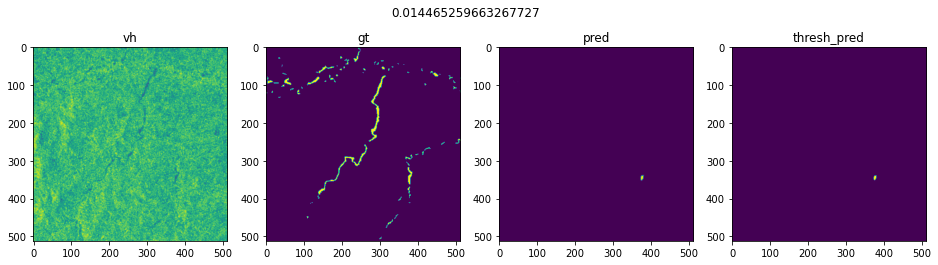

Epoch 54/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5430 - mae: 0.0551 - accuracy: 0.9522 - val_loss: 0.5915 - val_mae: 0.0629 - val_accuracy: 0.9434

Epoch 00054: val_loss did not improve from 0.57041


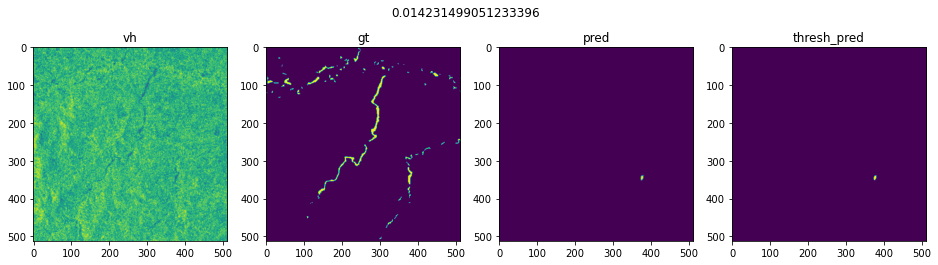

Epoch 55/70
108/108 [==============================] - 75s 696ms/step - loss: 0.6018 - mae: 0.0600 - accuracy: 0.9450 - val_loss: 0.5910 - val_mae: 0.0633 - val_accuracy: 0.9430

Epoch 00055: val_loss did not improve from 0.57041


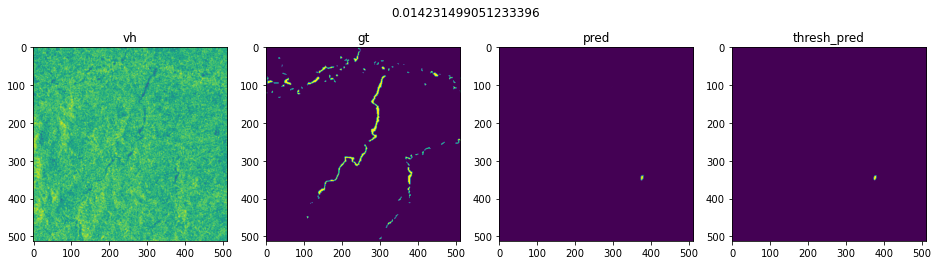

Epoch 56/70
108/108 [==============================] - 75s 696ms/step - loss: 0.6173 - mae: 0.0599 - accuracy: 0.9458 - val_loss: 0.5915 - val_mae: 0.0630 - val_accuracy: 0.9433

Epoch 00056: val_loss did not improve from 0.57041


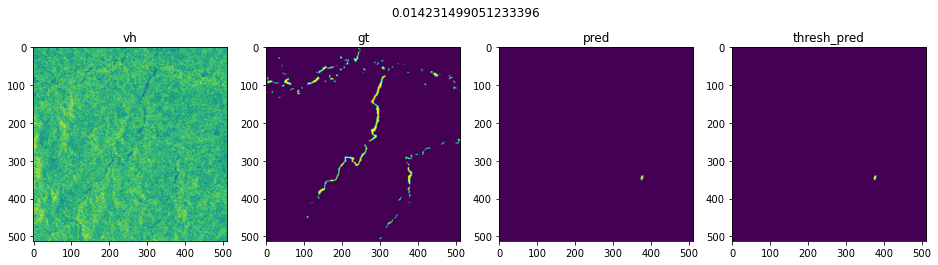

Epoch 57/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5707 - mae: 0.0553 - accuracy: 0.9513 - val_loss: 0.5917 - val_mae: 0.0632 - val_accuracy: 0.9432

Epoch 00057: val_loss did not improve from 0.57041


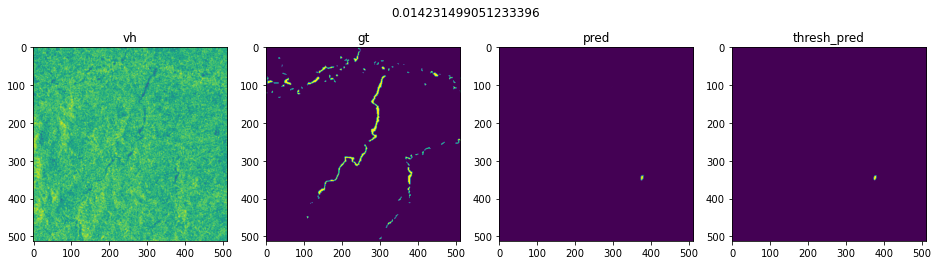

Epoch 00057: early stopping
Epoch 1/70
108/108 [==============================] - 89s 712ms/step - loss: 1.2845 - mae: 0.2834 - accuracy: 0.8582 - val_loss: 2.8437 - val_mae: 0.1426 - val_accuracy: 0.8575

Epoch 00001: val_loss improved from inf to 2.84374, saving model to unet_models/EfficientB4Unet_512_3_3.h5


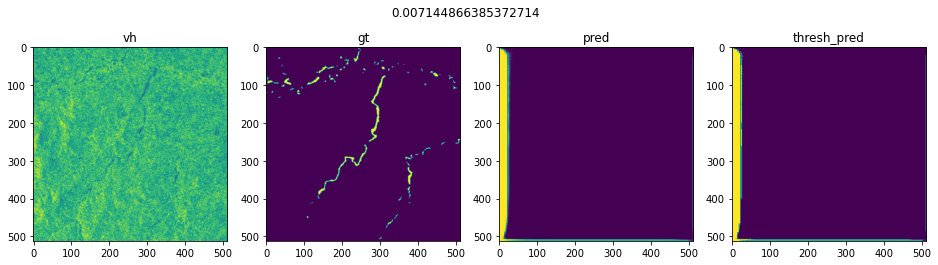

Epoch 2/70
108/108 [==============================] - 75s 697ms/step - loss: 0.9928 - mae: 0.1207 - accuracy: 0.9087 - val_loss: 0.7798 - val_mae: 0.0580 - val_accuracy: 0.9556

Epoch 00002: val_loss improved from 2.84374 to 0.77978, saving model to unet_models/EfficientB4Unet_512_3_3.h5


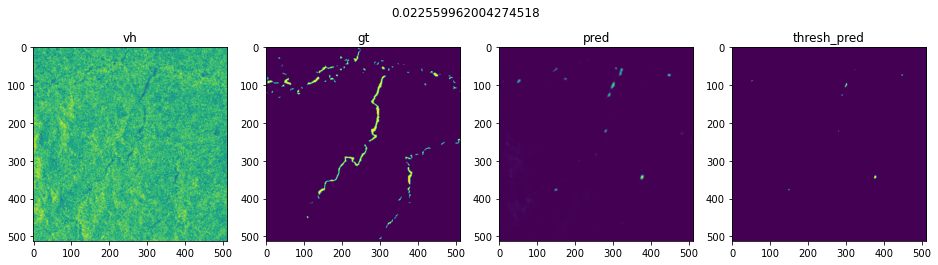

Epoch 3/70
108/108 [==============================] - 75s 693ms/step - loss: 0.8255 - mae: 0.0971 - accuracy: 0.9212 - val_loss: 1.4235 - val_mae: 0.1027 - val_accuracy: 0.9000

Epoch 00003: val_loss did not improve from 0.77978


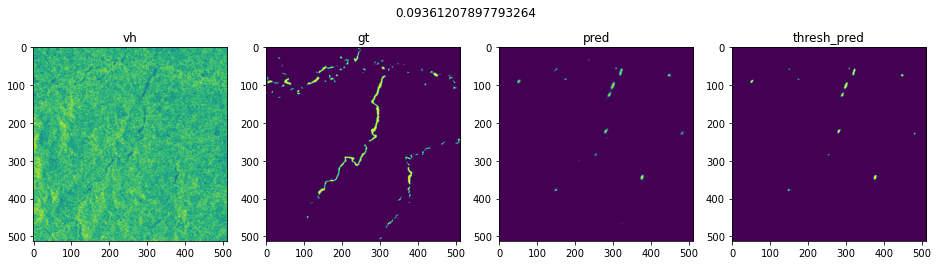

Epoch 4/70
108/108 [==============================] - 75s 694ms/step - loss: 0.7856 - mae: 0.0972 - accuracy: 0.9157 - val_loss: 1.7224 - val_mae: 0.1077 - val_accuracy: 0.8945

Epoch 00004: val_loss did not improve from 0.77978


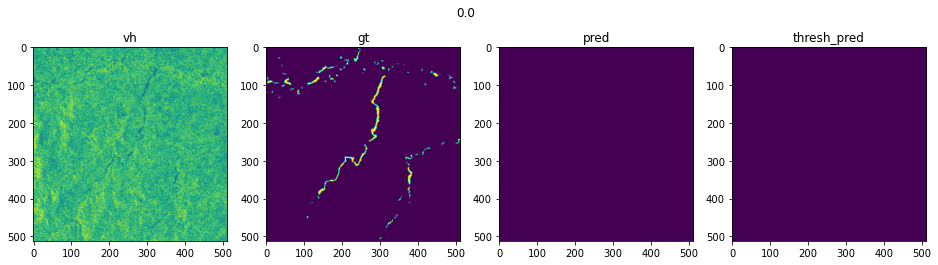

Epoch 5/70
108/108 [==============================] - 75s 696ms/step - loss: 0.7391 - mae: 0.0868 - accuracy: 0.9230 - val_loss: 0.8226 - val_mae: 0.0782 - val_accuracy: 0.9278

Epoch 00005: val_loss did not improve from 0.77978


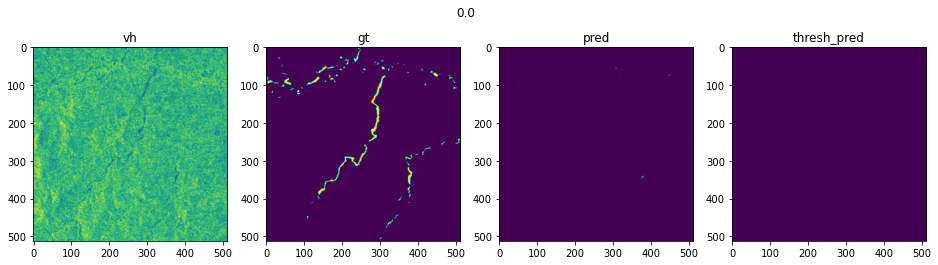

Epoch 6/70
108/108 [==============================] - 75s 695ms/step - loss: 0.7507 - mae: 0.0865 - accuracy: 0.9299 - val_loss: 0.6437 - val_mae: 0.0478 - val_accuracy: 0.9536

Epoch 00006: val_loss improved from 0.77978 to 0.64372, saving model to unet_models/EfficientB4Unet_512_3_3.h5


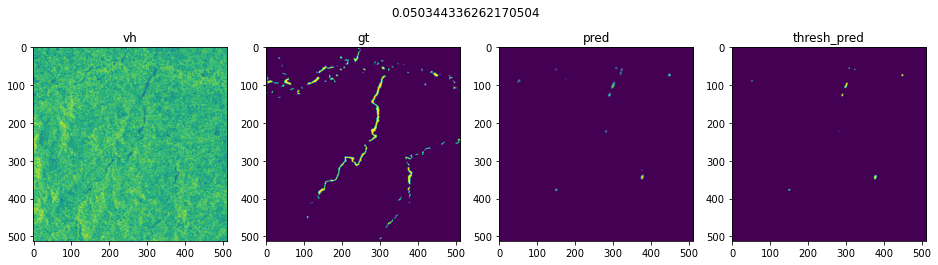

Epoch 7/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6809 - mae: 0.0776 - accuracy: 0.9329 - val_loss: 0.8379 - val_mae: 0.0627 - val_accuracy: 0.9473

Epoch 00007: val_loss did not improve from 0.64372


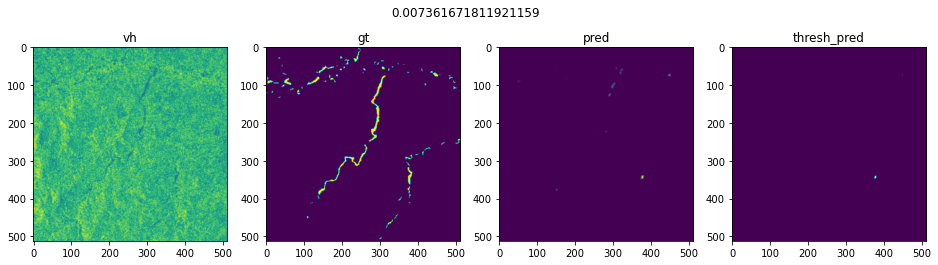

Epoch 8/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6559 - mae: 0.0679 - accuracy: 0.9430 - val_loss: 0.7576 - val_mae: 0.1134 - val_accuracy: 0.9306

Epoch 00008: val_loss did not improve from 0.64372


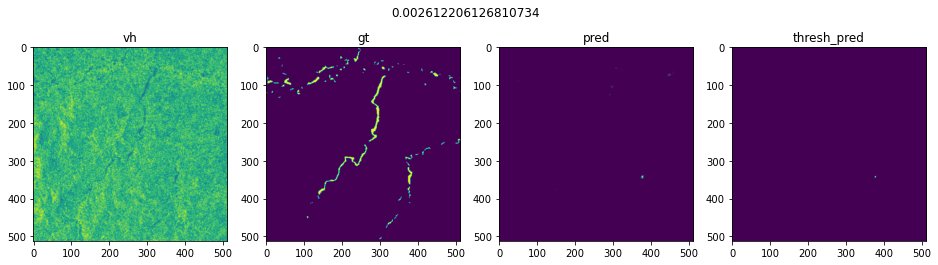

Epoch 9/70
108/108 [==============================] - 75s 692ms/step - loss: 0.8064 - mae: 0.0929 - accuracy: 0.9236 - val_loss: 0.5453 - val_mae: 0.0450 - val_accuracy: 0.9630

Epoch 00009: val_loss improved from 0.64372 to 0.54534, saving model to unet_models/EfficientB4Unet_512_3_3.h5


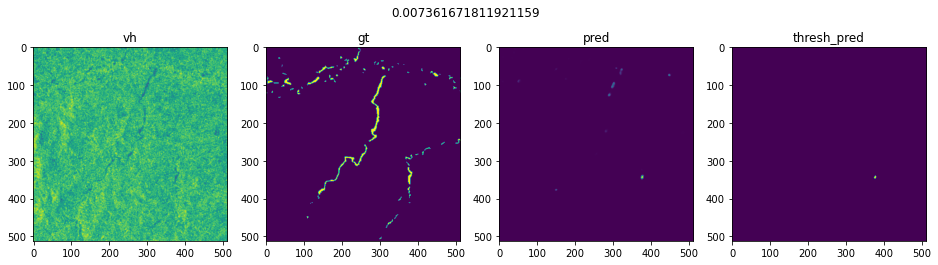

Epoch 10/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6927 - mae: 0.0769 - accuracy: 0.9333 - val_loss: 0.5472 - val_mae: 0.0441 - val_accuracy: 0.9637

Epoch 00010: val_loss did not improve from 0.54534


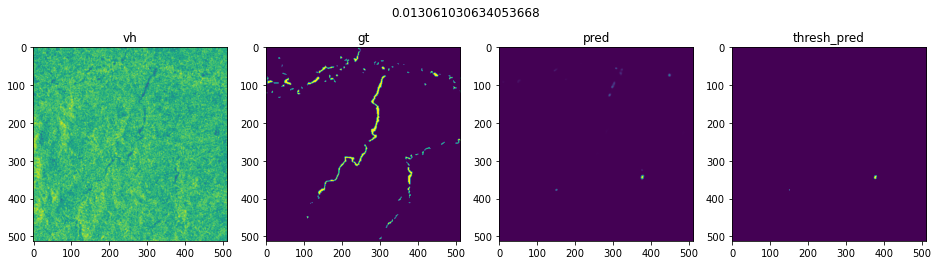

Epoch 11/70
108/108 [==============================] - 75s 694ms/step - loss: 0.7523 - mae: 0.0855 - accuracy: 0.9257 - val_loss: 0.5922 - val_mae: 0.0614 - val_accuracy: 0.9632

Epoch 00011: val_loss did not improve from 0.54534


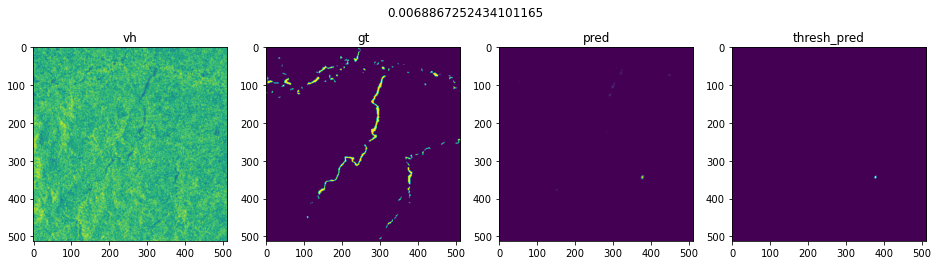

Epoch 12/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6894 - mae: 0.0746 - accuracy: 0.9335 - val_loss: 0.5418 - val_mae: 0.0520 - val_accuracy: 0.9642

Epoch 00012: val_loss improved from 0.54534 to 0.54179, saving model to unet_models/EfficientB4Unet_512_3_3.h5


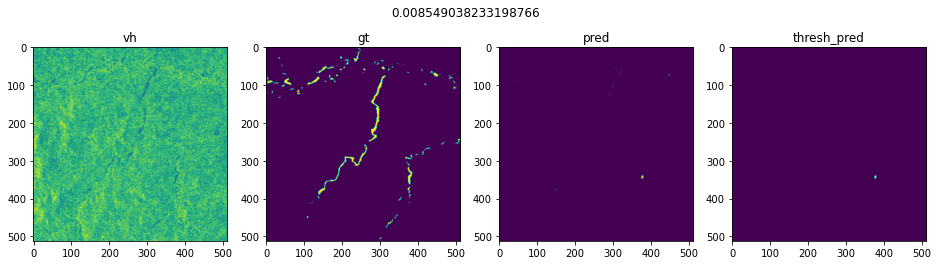

Epoch 13/70
108/108 [==============================] - 75s 695ms/step - loss: 0.6893 - mae: 0.0817 - accuracy: 0.9329 - val_loss: 0.5516 - val_mae: 0.0460 - val_accuracy: 0.9627

Epoch 00013: val_loss did not improve from 0.54179


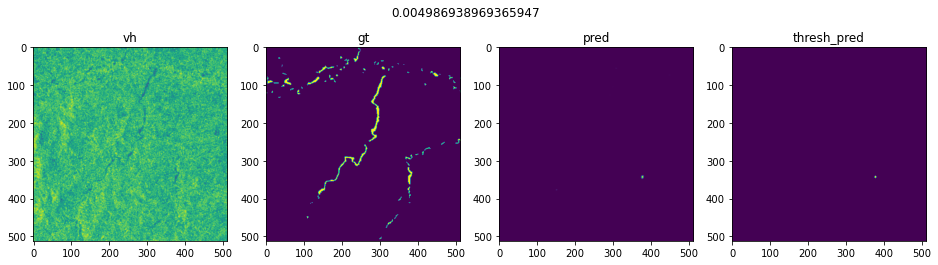

Epoch 14/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6948 - mae: 0.0682 - accuracy: 0.9403 - val_loss: 0.6150 - val_mae: 0.0455 - val_accuracy: 0.9614

Epoch 00014: val_loss did not improve from 0.54179


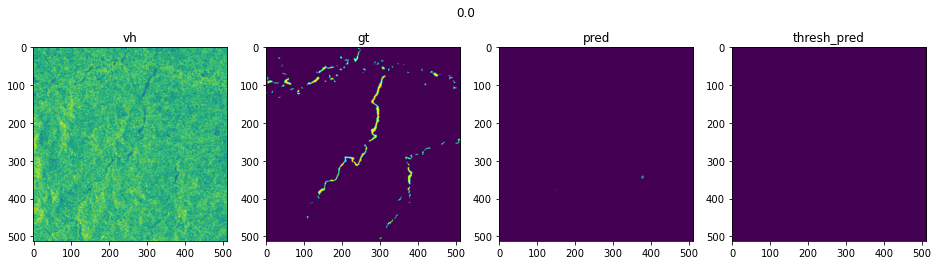

Epoch 15/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6471 - mae: 0.0639 - accuracy: 0.9434 - val_loss: 0.5348 - val_mae: 0.0534 - val_accuracy: 0.9629

Epoch 00015: val_loss improved from 0.54179 to 0.53476, saving model to unet_models/EfficientB4Unet_512_3_3.h5


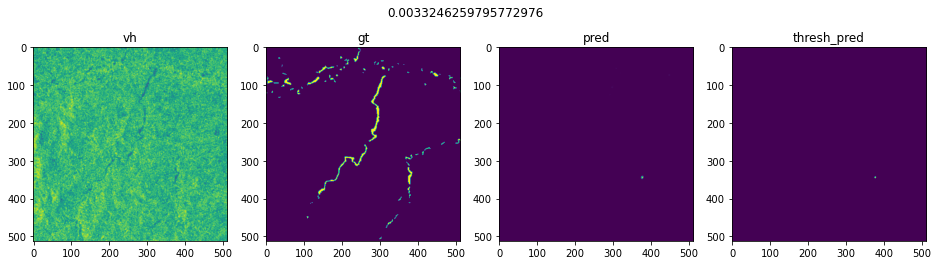

Epoch 16/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6751 - mae: 0.0717 - accuracy: 0.9380 - val_loss: 0.5656 - val_mae: 0.0643 - val_accuracy: 0.9462

Epoch 00016: val_loss did not improve from 0.53476


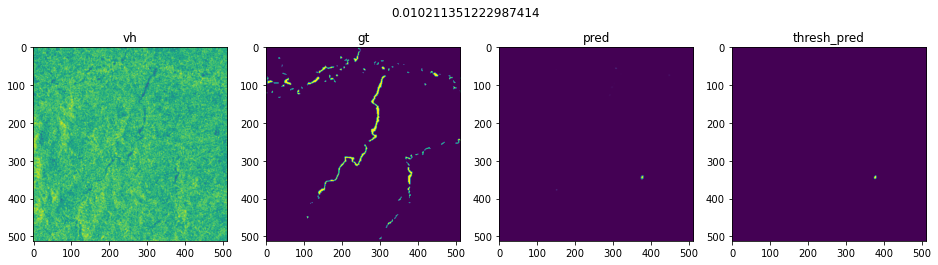

Epoch 17/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6601 - mae: 0.0758 - accuracy: 0.9316 - val_loss: 0.5539 - val_mae: 0.0482 - val_accuracy: 0.9613

Epoch 00017: val_loss did not improve from 0.53476


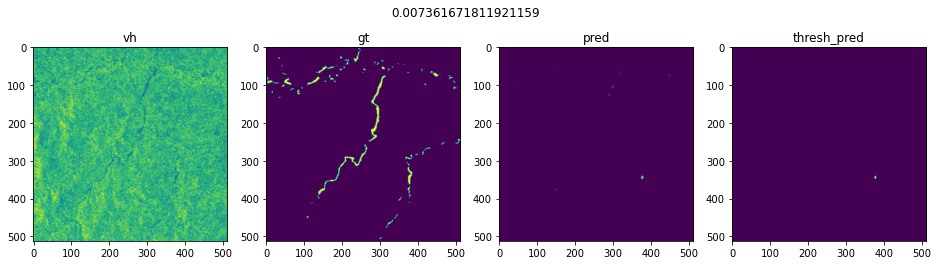

Epoch 18/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6568 - mae: 0.0633 - accuracy: 0.9446 - val_loss: 0.5265 - val_mae: 0.0439 - val_accuracy: 0.9624

Epoch 00018: val_loss improved from 0.53476 to 0.52652, saving model to unet_models/EfficientB4Unet_512_3_3.h5


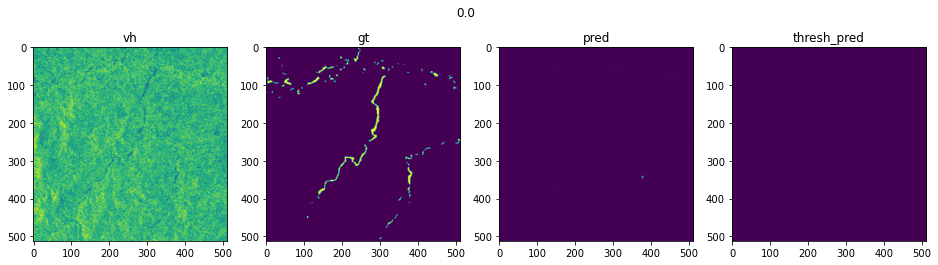

Epoch 19/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6415 - mae: 0.0675 - accuracy: 0.9398 - val_loss: 0.5155 - val_mae: 0.0436 - val_accuracy: 0.9679

Epoch 00019: val_loss improved from 0.52652 to 0.51551, saving model to unet_models/EfficientB4Unet_512_3_3.h5


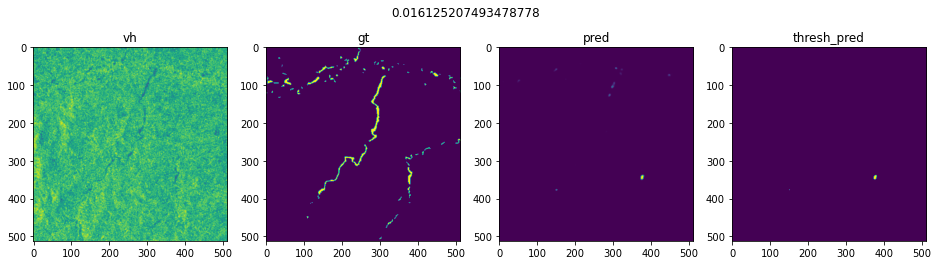

Epoch 20/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6348 - mae: 0.0640 - accuracy: 0.9441 - val_loss: 0.5126 - val_mae: 0.0431 - val_accuracy: 0.9655

Epoch 00020: val_loss improved from 0.51551 to 0.51260, saving model to unet_models/EfficientB4Unet_512_3_3.h5


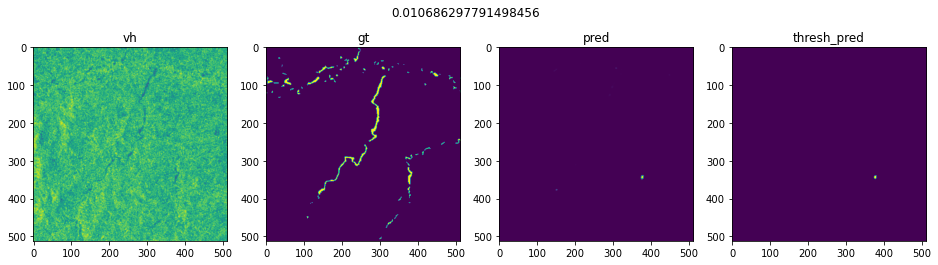

Epoch 21/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5502 - mae: 0.0601 - accuracy: 0.9504 - val_loss: 0.5270 - val_mae: 0.0461 - val_accuracy: 0.9623

Epoch 00021: val_loss did not improve from 0.51260


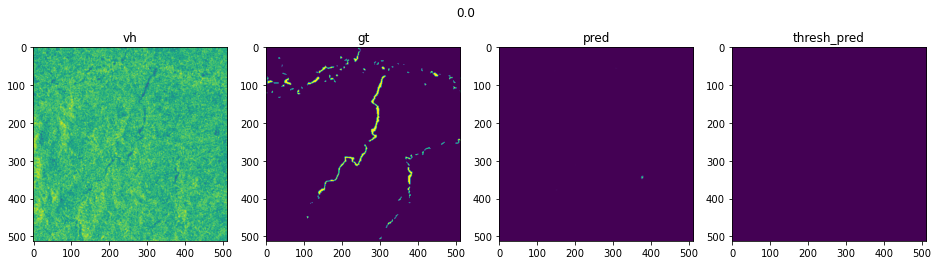

Epoch 22/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6286 - mae: 0.0746 - accuracy: 0.9378 - val_loss: 0.4789 - val_mae: 0.0402 - val_accuracy: 0.9673

Epoch 00022: val_loss improved from 0.51260 to 0.47894, saving model to unet_models/EfficientB4Unet_512_3_3.h5


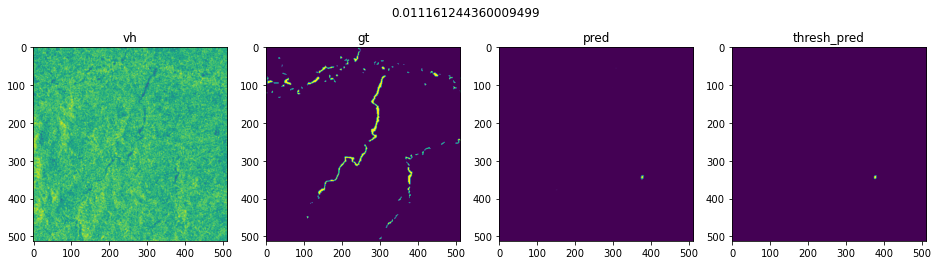

Epoch 23/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6208 - mae: 0.0726 - accuracy: 0.9359 - val_loss: 0.5374 - val_mae: 0.0513 - val_accuracy: 0.9576

Epoch 00023: val_loss did not improve from 0.47894


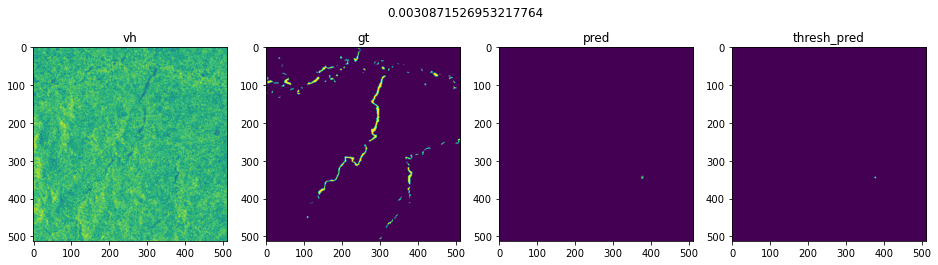

Epoch 24/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6588 - mae: 0.0653 - accuracy: 0.9417 - val_loss: 0.4871 - val_mae: 0.0427 - val_accuracy: 0.9649

Epoch 00024: val_loss did not improve from 0.47894


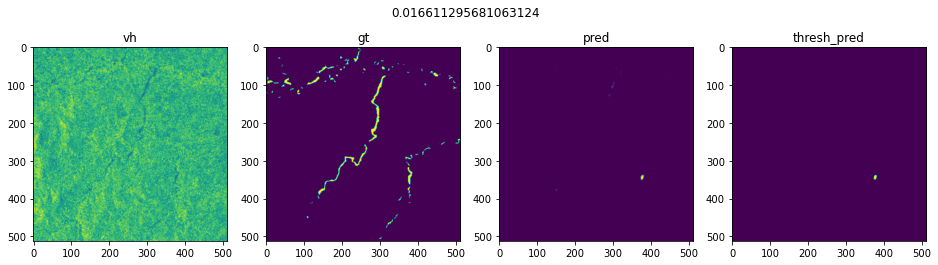

Epoch 25/70
108/108 [==============================] - 75s 691ms/step - loss: 0.5989 - mae: 0.0599 - accuracy: 0.9477 - val_loss: 0.9166 - val_mae: 0.0922 - val_accuracy: 0.9098

Epoch 00025: val_loss did not improve from 0.47894


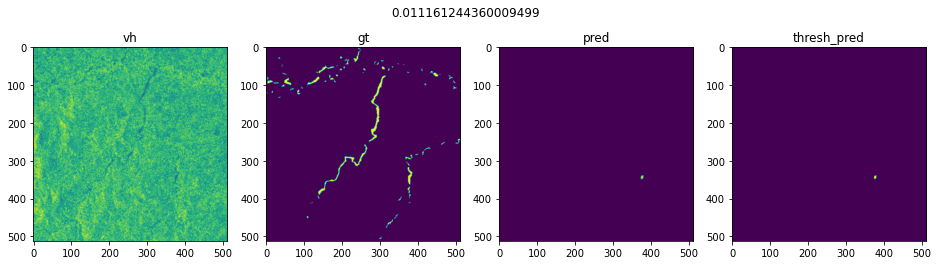

Epoch 26/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5861 - mae: 0.0678 - accuracy: 0.9407 - val_loss: 0.5333 - val_mae: 0.0420 - val_accuracy: 0.9631

Epoch 00026: val_loss did not improve from 0.47894


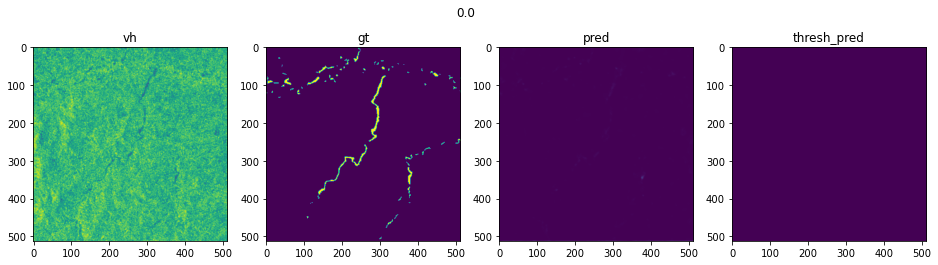

Epoch 27/70
108/108 [==============================] - 75s 694ms/step - loss: 0.5775 - mae: 0.0634 - accuracy: 0.9448 - val_loss: 0.4807 - val_mae: 0.0379 - val_accuracy: 0.9682

Epoch 00027: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00027: val_loss did not improve from 0.47894


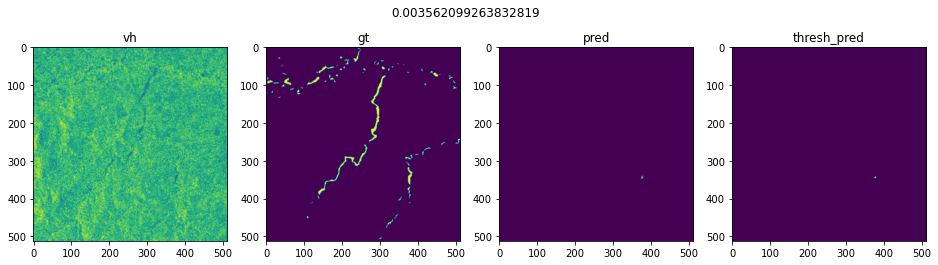

Epoch 28/70
108/108 [==============================] - 75s 694ms/step - loss: 0.6043 - mae: 0.0689 - accuracy: 0.9382 - val_loss: 0.4812 - val_mae: 0.0396 - val_accuracy: 0.9676

Epoch 00028: val_loss did not improve from 0.47894


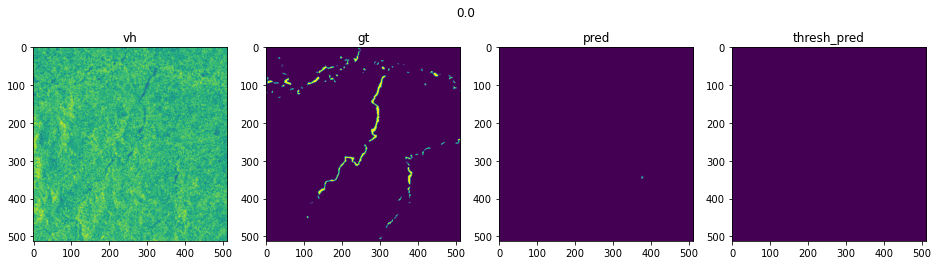

Epoch 29/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5868 - mae: 0.0651 - accuracy: 0.9424 - val_loss: 0.4703 - val_mae: 0.0411 - val_accuracy: 0.9677

Epoch 00029: val_loss improved from 0.47894 to 0.47035, saving model to unet_models/EfficientB4Unet_512_3_3.h5


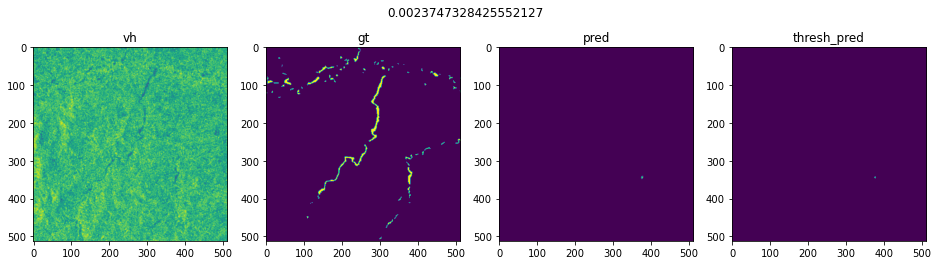

Epoch 30/70
108/108 [==============================] - 75s 691ms/step - loss: 0.5568 - mae: 0.0604 - accuracy: 0.9477 - val_loss: 0.4673 - val_mae: 0.0419 - val_accuracy: 0.9674

Epoch 00030: val_loss improved from 0.47035 to 0.46726, saving model to unet_models/EfficientB4Unet_512_3_3.h5


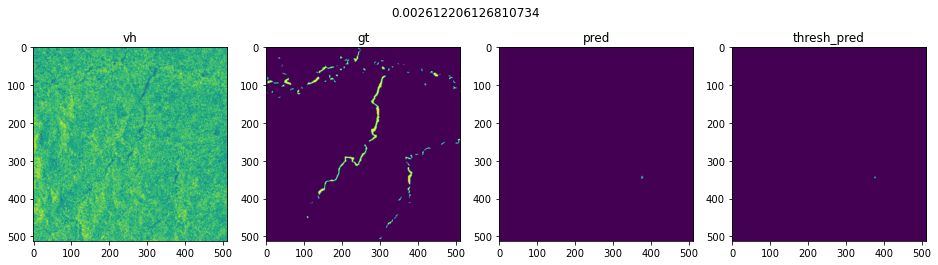

Epoch 31/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5568 - mae: 0.0548 - accuracy: 0.9519 - val_loss: 0.4598 - val_mae: 0.0385 - val_accuracy: 0.9681

Epoch 00031: val_loss improved from 0.46726 to 0.45976, saving model to unet_models/EfficientB4Unet_512_3_3.h5


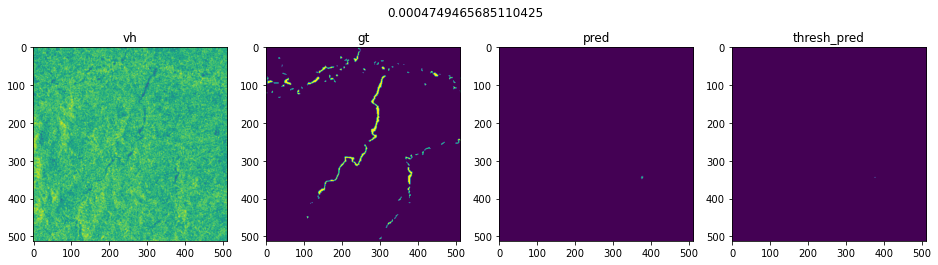

Epoch 32/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5685 - mae: 0.0580 - accuracy: 0.9488 - val_loss: 0.4608 - val_mae: 0.0393 - val_accuracy: 0.9675

Epoch 00032: val_loss did not improve from 0.45976


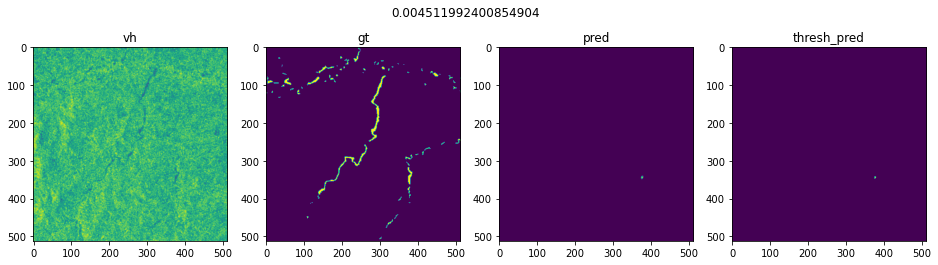

Epoch 33/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5665 - mae: 0.0604 - accuracy: 0.9464 - val_loss: 0.4591 - val_mae: 0.0390 - val_accuracy: 0.9683

Epoch 00033: val_loss improved from 0.45976 to 0.45909, saving model to unet_models/EfficientB4Unet_512_3_3.h5


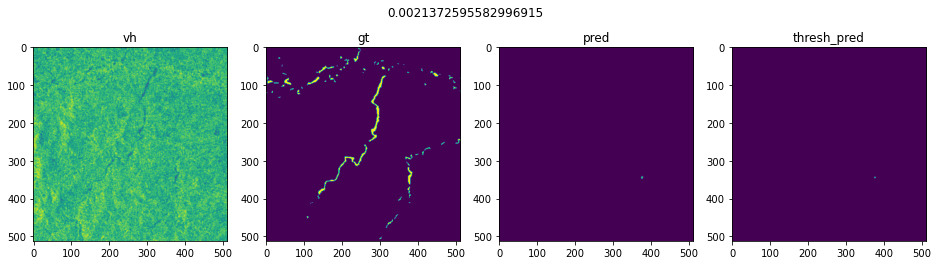

Epoch 34/70
108/108 [==============================] - 75s 694ms/step - loss: 0.5547 - mae: 0.0610 - accuracy: 0.9465 - val_loss: 0.4481 - val_mae: 0.0396 - val_accuracy: 0.9682

Epoch 00034: val_loss improved from 0.45909 to 0.44814, saving model to unet_models/EfficientB4Unet_512_3_3.h5


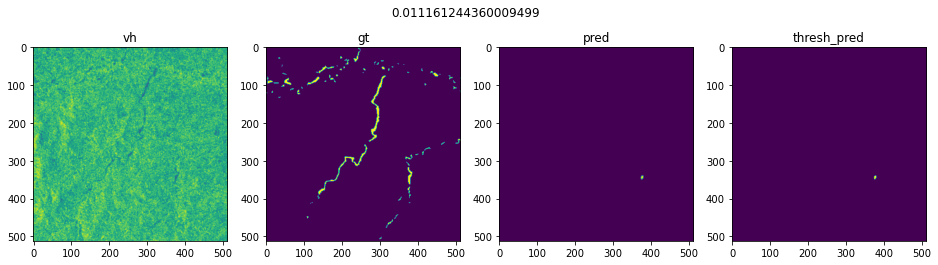

Epoch 35/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5746 - mae: 0.0605 - accuracy: 0.9461 - val_loss: 0.4676 - val_mae: 0.0401 - val_accuracy: 0.9671

Epoch 00035: val_loss did not improve from 0.44814


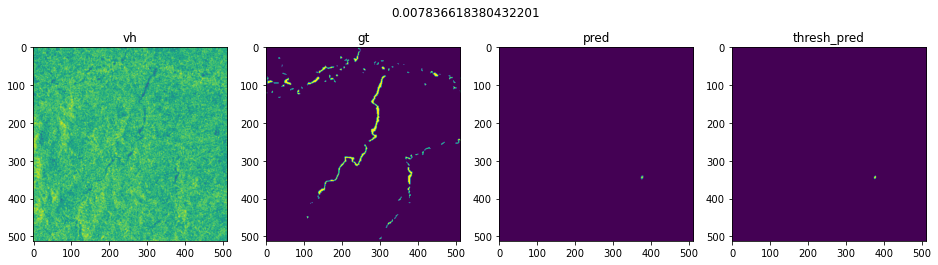

Epoch 36/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5692 - mae: 0.0625 - accuracy: 0.9451 - val_loss: 0.4859 - val_mae: 0.0419 - val_accuracy: 0.9652

Epoch 00036: val_loss did not improve from 0.44814


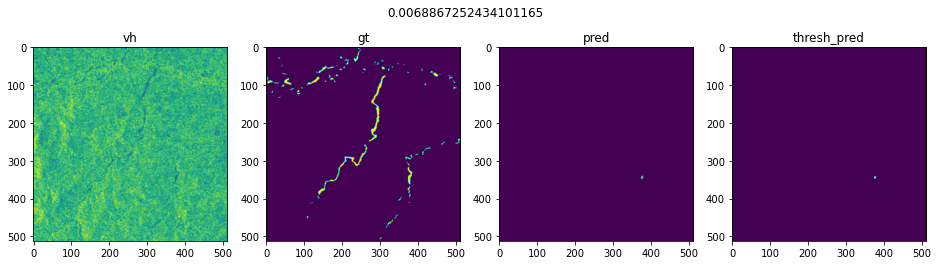

Epoch 37/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5501 - mae: 0.0628 - accuracy: 0.9456 - val_loss: 0.4951 - val_mae: 0.0427 - val_accuracy: 0.9636

Epoch 00037: val_loss did not improve from 0.44814


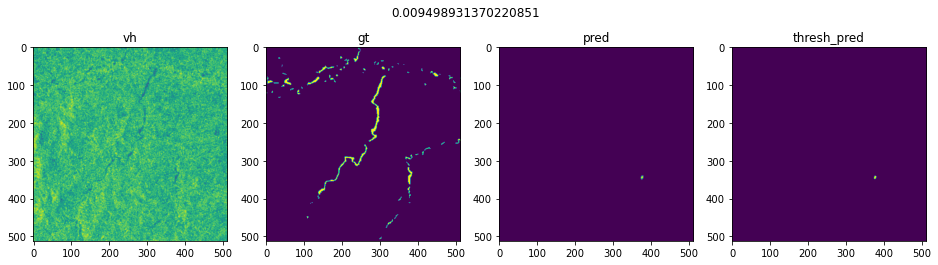

Epoch 38/70
108/108 [==============================] - 75s 694ms/step - loss: 0.5648 - mae: 0.0605 - accuracy: 0.9470 - val_loss: 0.5136 - val_mae: 0.0483 - val_accuracy: 0.9599

Epoch 00038: val_loss did not improve from 0.44814


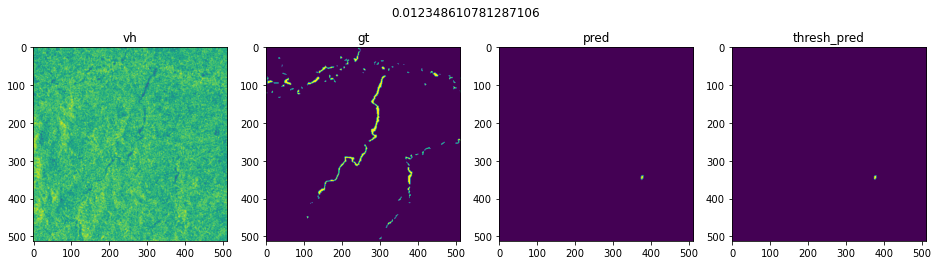

Epoch 39/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5441 - mae: 0.0549 - accuracy: 0.9516 - val_loss: 0.5158 - val_mae: 0.0450 - val_accuracy: 0.9617

Epoch 00039: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00039: val_loss did not improve from 0.44814


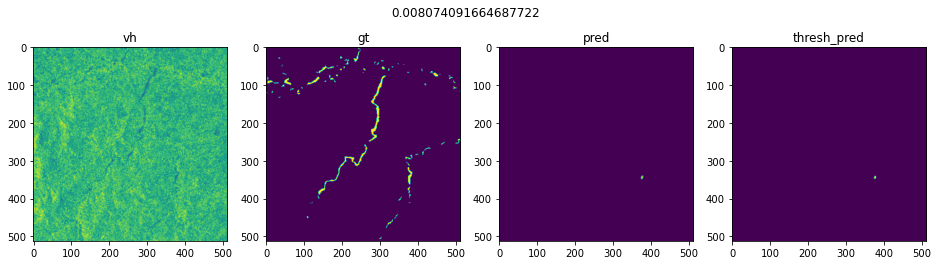

Epoch 40/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5246 - mae: 0.0612 - accuracy: 0.9452 - val_loss: 0.4759 - val_mae: 0.0407 - val_accuracy: 0.9647

Epoch 00040: val_loss did not improve from 0.44814


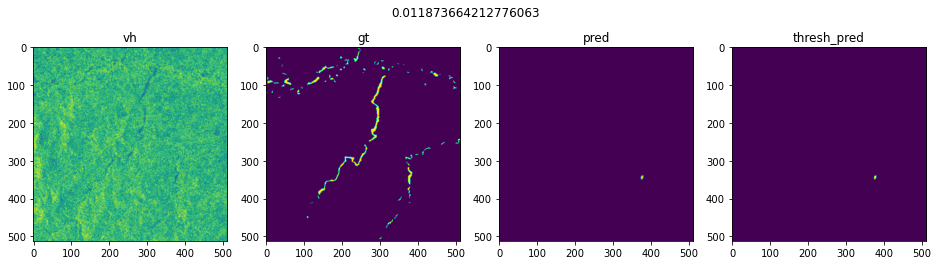

Epoch 41/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5758 - mae: 0.0632 - accuracy: 0.9423 - val_loss: 0.4763 - val_mae: 0.0414 - val_accuracy: 0.9643

Epoch 00041: val_loss did not improve from 0.44814


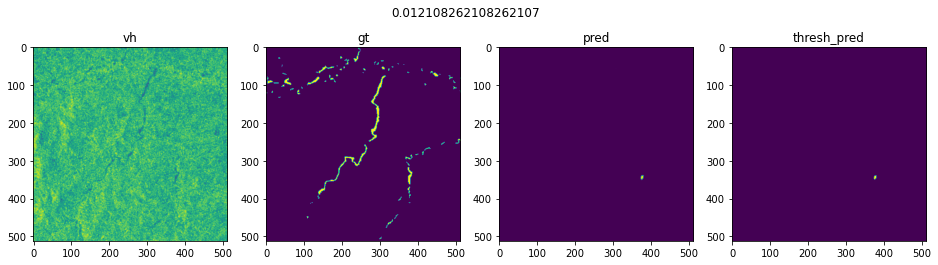

Epoch 42/70
108/108 [==============================] - 75s 696ms/step - loss: 0.5134 - mae: 0.0548 - accuracy: 0.9525 - val_loss: 0.4785 - val_mae: 0.0412 - val_accuracy: 0.9642

Epoch 00042: val_loss did not improve from 0.44814


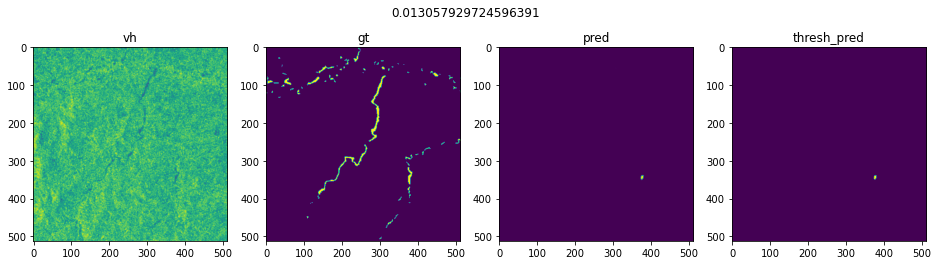

Epoch 43/70
108/108 [==============================] - 75s 694ms/step - loss: 0.4963 - mae: 0.0535 - accuracy: 0.9527 - val_loss: 0.4847 - val_mae: 0.0422 - val_accuracy: 0.9635

Epoch 00043: val_loss did not improve from 0.44814


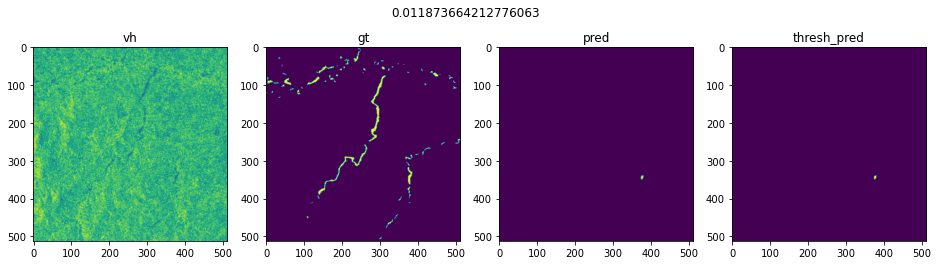

Epoch 44/70
108/108 [==============================] - 75s 694ms/step - loss: 0.4977 - mae: 0.0538 - accuracy: 0.9536 - val_loss: 0.4888 - val_mae: 0.0428 - val_accuracy: 0.9635

Epoch 00044: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00044: val_loss did not improve from 0.44814


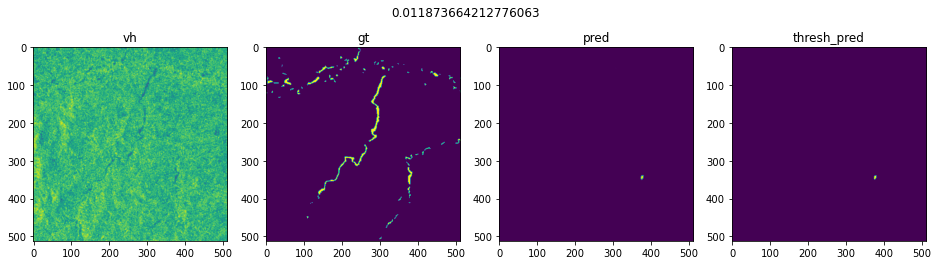

Epoch 45/70
108/108 [==============================] - 75s 695ms/step - loss: 0.5070 - mae: 0.0534 - accuracy: 0.9519 - val_loss: 0.4808 - val_mae: 0.0419 - val_accuracy: 0.9639

Epoch 00045: val_loss did not improve from 0.44814


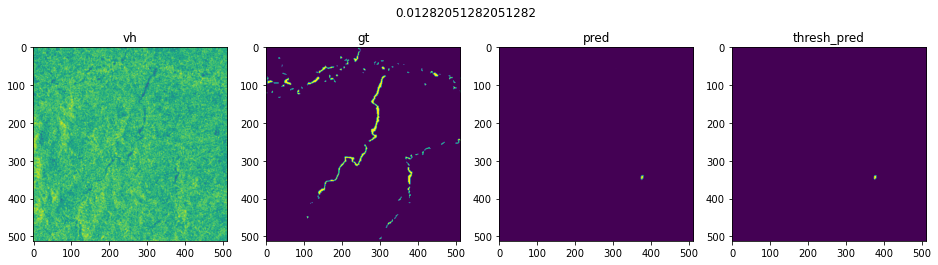

Epoch 46/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5223 - mae: 0.0554 - accuracy: 0.9523 - val_loss: 0.4984 - val_mae: 0.0431 - val_accuracy: 0.9633

Epoch 00046: val_loss did not improve from 0.44814


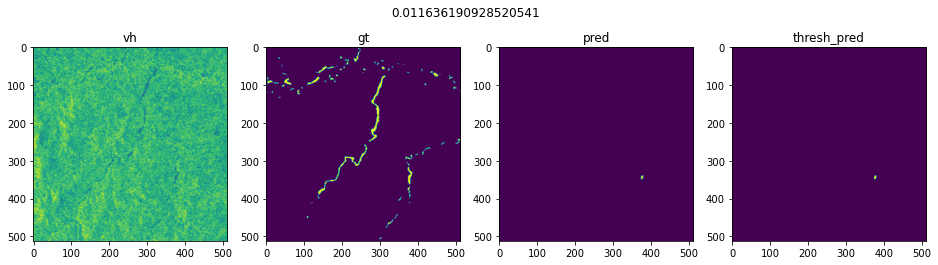

Epoch 47/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5458 - mae: 0.0554 - accuracy: 0.9501 - val_loss: 0.4696 - val_mae: 0.0409 - val_accuracy: 0.9648

Epoch 00047: val_loss did not improve from 0.44814


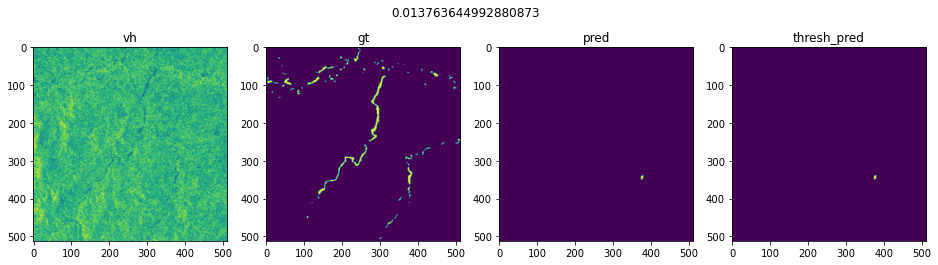

Epoch 48/70
108/108 [==============================] - 75s 694ms/step - loss: 0.5141 - mae: 0.0568 - accuracy: 0.9503 - val_loss: 0.4832 - val_mae: 0.0424 - val_accuracy: 0.9636

Epoch 00048: val_loss did not improve from 0.44814


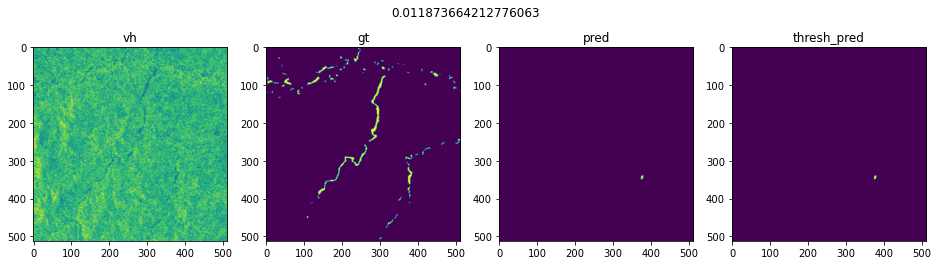

Epoch 49/70
108/108 [==============================] - 75s 692ms/step - loss: 0.5059 - mae: 0.0544 - accuracy: 0.9525 - val_loss: 0.4775 - val_mae: 0.0423 - val_accuracy: 0.9638

Epoch 00049: ReduceLROnPlateau reducing learning rate to 1e-06.

Epoch 00049: val_loss did not improve from 0.44814


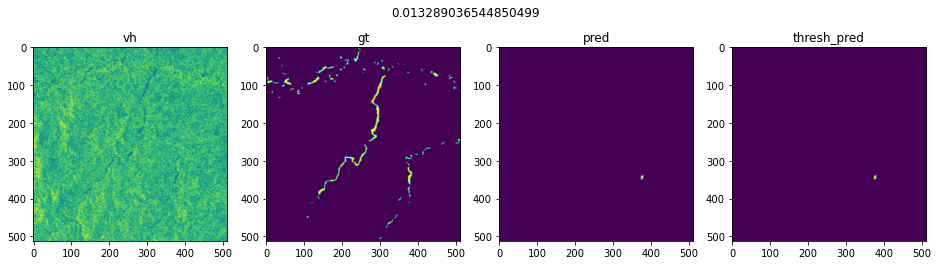

Epoch 00049: early stopping
Epoch 1/70
108/108 [==============================] - 88s 704ms/step - loss: 1.3324 - mae: 0.3308 - accuracy: 0.7803 - val_loss: 1.0696 - val_mae: 0.1289 - val_accuracy: 0.9219

Epoch 00001: val_loss improved from inf to 1.06963, saving model to unet_models/EfficientB4Unet_512_3_4.h5


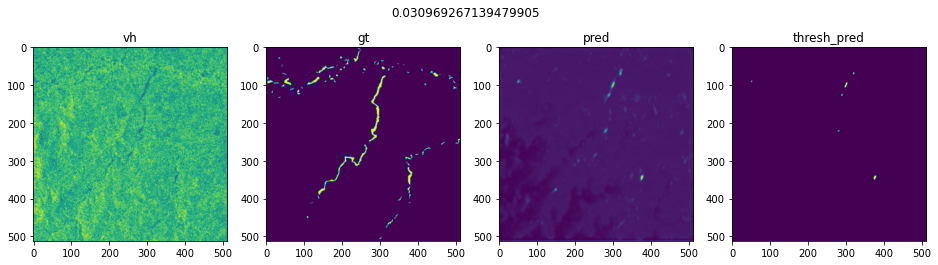

Epoch 2/70
108/108 [==============================] - 75s 690ms/step - loss: 0.9545 - mae: 0.1066 - accuracy: 0.9272 - val_loss: 0.7211 - val_mae: 0.0790 - val_accuracy: 0.9425

Epoch 00002: val_loss improved from 1.06963 to 0.72113, saving model to unet_models/EfficientB4Unet_512_3_4.h5


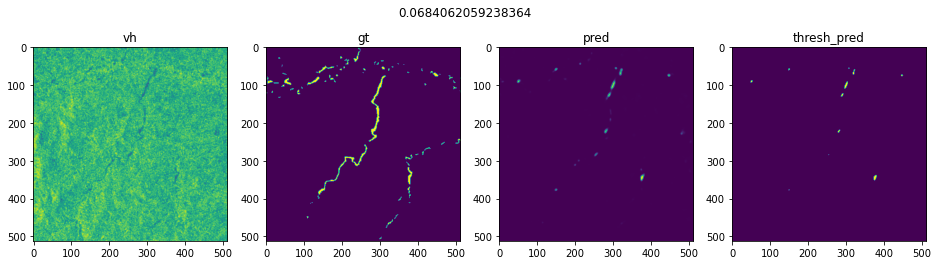

Epoch 3/70
108/108 [==============================] - 75s 690ms/step - loss: 0.8393 - mae: 0.0928 - accuracy: 0.9256 - val_loss: 1.0655 - val_mae: 0.1105 - val_accuracy: 0.9051

Epoch 00003: val_loss did not improve from 0.72113


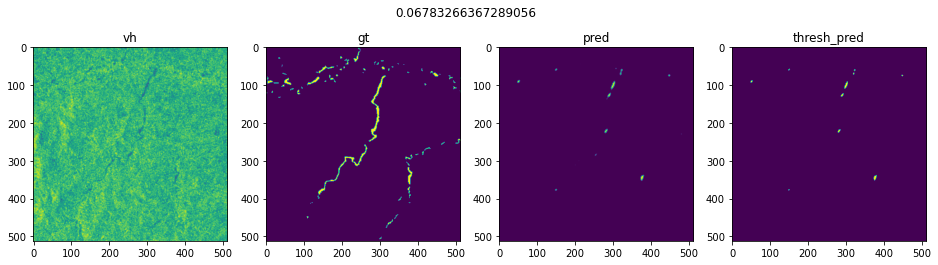

Epoch 4/70
108/108 [==============================] - 75s 690ms/step - loss: 0.6993 - mae: 0.0721 - accuracy: 0.9395 - val_loss: 3.2909 - val_mae: 0.1761 - val_accuracy: 0.8240

Epoch 00004: val_loss did not improve from 0.72113


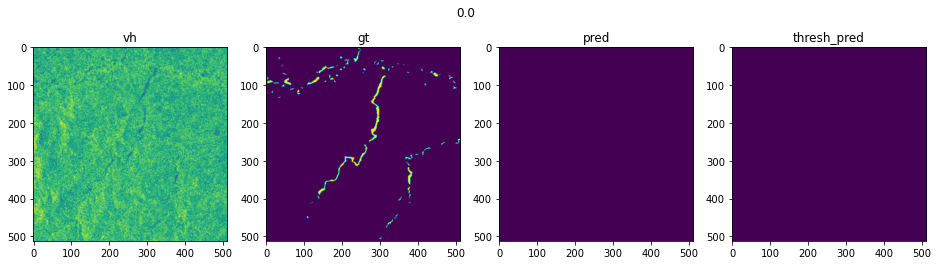

Epoch 5/70
108/108 [==============================] - 75s 693ms/step - loss: 0.7565 - mae: 0.0790 - accuracy: 0.9313 - val_loss: 0.7366 - val_mae: 0.0714 - val_accuracy: 0.9376

Epoch 00005: val_loss did not improve from 0.72113


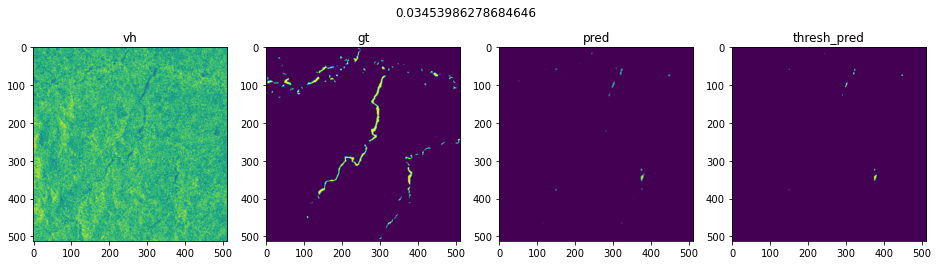

Epoch 6/70
108/108 [==============================] - 75s 692ms/step - loss: 0.7347 - mae: 0.0783 - accuracy: 0.9346 - val_loss: 3.0024 - val_mae: 0.1745 - val_accuracy: 0.8290

Epoch 00006: val_loss did not improve from 0.72113


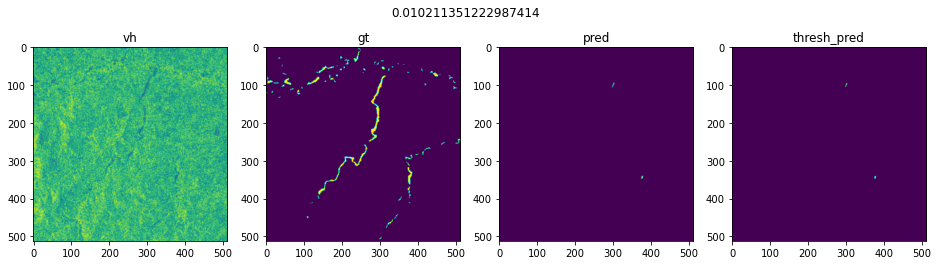

Epoch 7/70
108/108 [==============================] - 75s 691ms/step - loss: 0.6305 - mae: 0.0623 - accuracy: 0.9502 - val_loss: 2.2077 - val_mae: 0.1504 - val_accuracy: 0.8559

Epoch 00007: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00007: val_loss did not improve from 0.72113


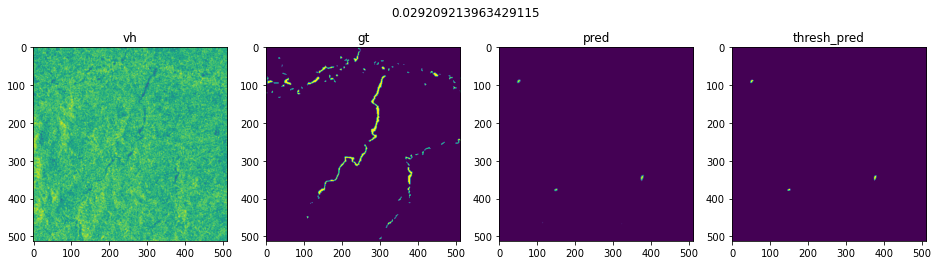

Epoch 8/70
108/108 [==============================] - 75s 693ms/step - loss: 0.7063 - mae: 0.0709 - accuracy: 0.9384 - val_loss: 0.8543 - val_mae: 0.0832 - val_accuracy: 0.9266

Epoch 00008: val_loss did not improve from 0.72113


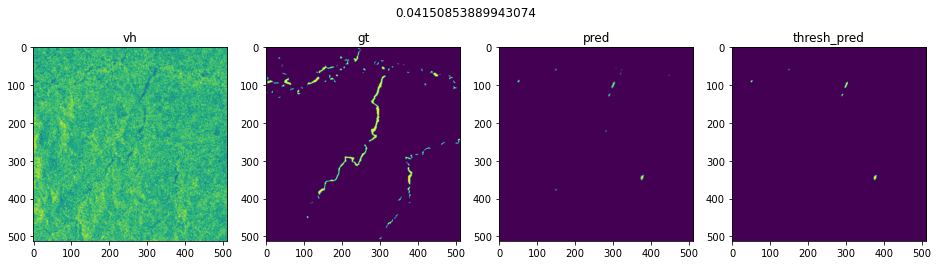

Epoch 9/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6580 - mae: 0.0638 - accuracy: 0.9450 - val_loss: 0.8032 - val_mae: 0.0780 - val_accuracy: 0.9302

Epoch 00009: val_loss did not improve from 0.72113


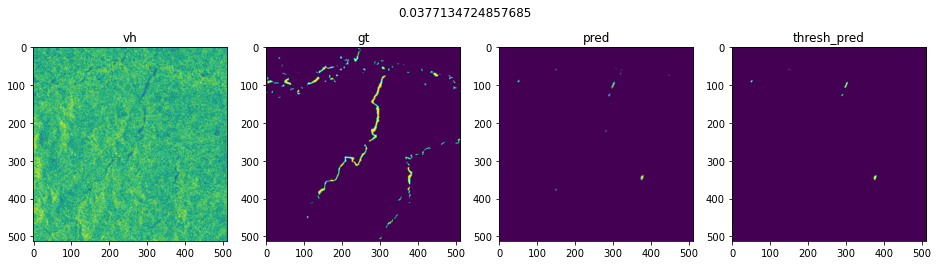

Epoch 10/70
108/108 [==============================] - 75s 694ms/step - loss: 0.5791 - mae: 0.0558 - accuracy: 0.9525 - val_loss: 0.7237 - val_mae: 0.0765 - val_accuracy: 0.9318

Epoch 00010: val_loss did not improve from 0.72113


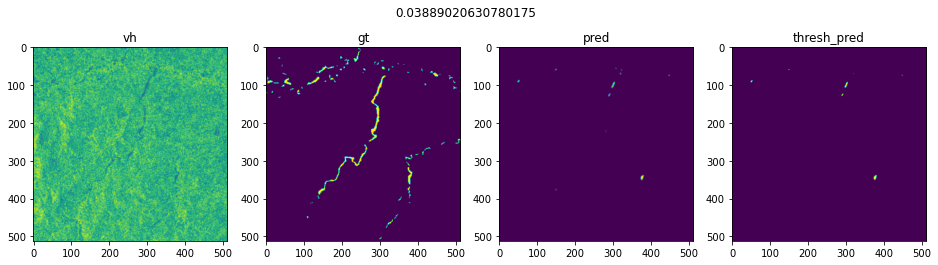

Epoch 11/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6114 - mae: 0.0591 - accuracy: 0.9502 - val_loss: 0.7268 - val_mae: 0.0781 - val_accuracy: 0.9300

Epoch 00012: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00012: val_loss did not improve from 0.72113


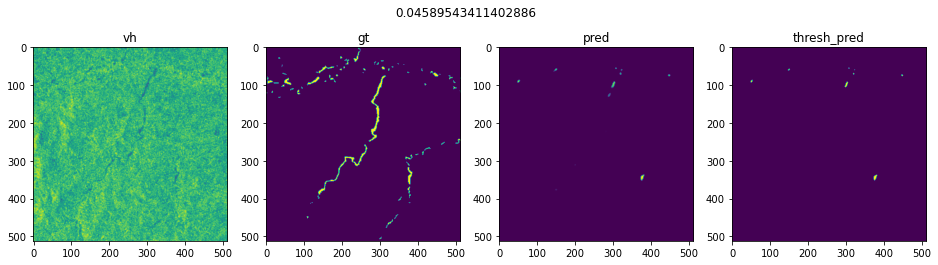

Epoch 13/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6207 - mae: 0.0606 - accuracy: 0.9482 - val_loss: 0.7381 - val_mae: 0.0783 - val_accuracy: 0.9300

Epoch 00013: val_loss did not improve from 0.72113


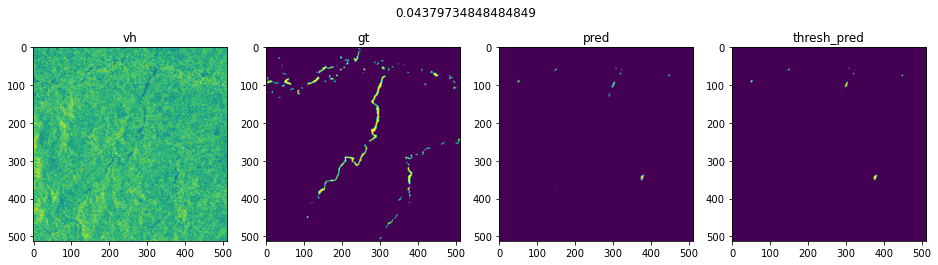

Epoch 14/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6194 - mae: 0.0591 - accuracy: 0.9473 - val_loss: 0.7401 - val_mae: 0.0782 - val_accuracy: 0.9298

Epoch 00014: val_loss did not improve from 0.72113


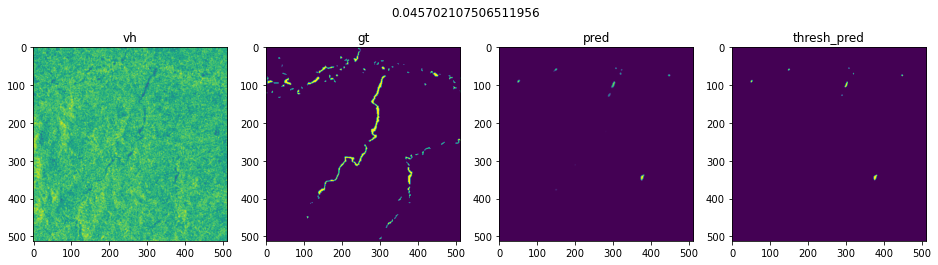

Epoch 15/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6251 - mae: 0.0565 - accuracy: 0.9510 - val_loss: 0.7352 - val_mae: 0.0781 - val_accuracy: 0.9298

Epoch 00015: val_loss did not improve from 0.72113


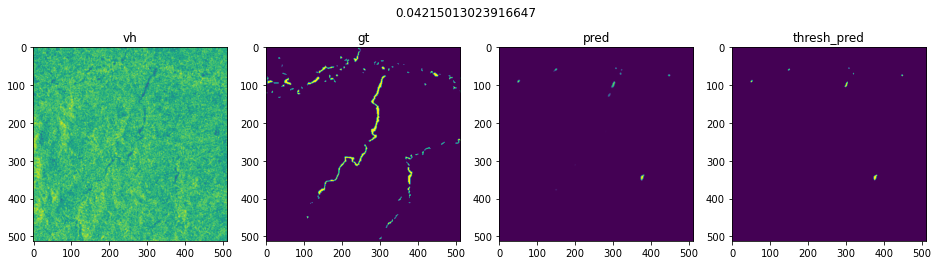

Epoch 16/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6564 - mae: 0.0707 - accuracy: 0.9404 - val_loss: 0.7122 - val_mae: 0.0763 - val_accuracy: 0.9319

Epoch 00016: val_loss improved from 0.72113 to 0.71215, saving model to unet_models/EfficientB4Unet_512_3_4.h5


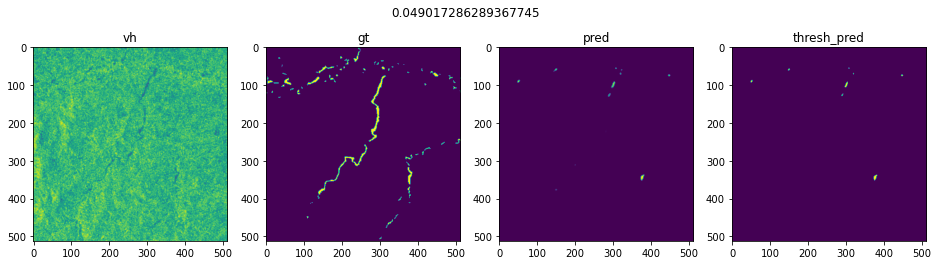

Epoch 17/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6268 - mae: 0.0650 - accuracy: 0.9427 - val_loss: 0.7271 - val_mae: 0.0773 - val_accuracy: 0.9307

Epoch 00017: val_loss did not improve from 0.71215


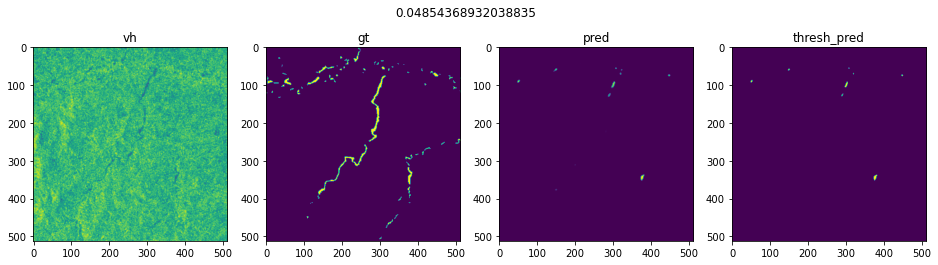

Epoch 18/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6662 - mae: 0.0611 - accuracy: 0.9469 - val_loss: 0.7516 - val_mae: 0.0783 - val_accuracy: 0.9294

Epoch 00018: val_loss did not improve from 0.71215


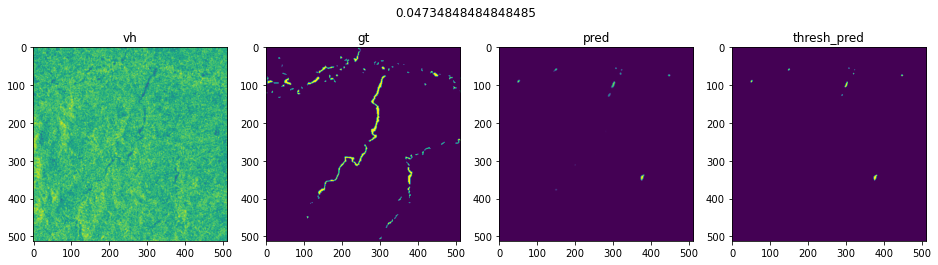

Epoch 19/70
108/108 [==============================] - 75s 691ms/step - loss: 0.6254 - mae: 0.0663 - accuracy: 0.9405 - val_loss: 0.7662 - val_mae: 0.0800 - val_accuracy: 0.9280

Epoch 00019: val_loss did not improve from 0.71215


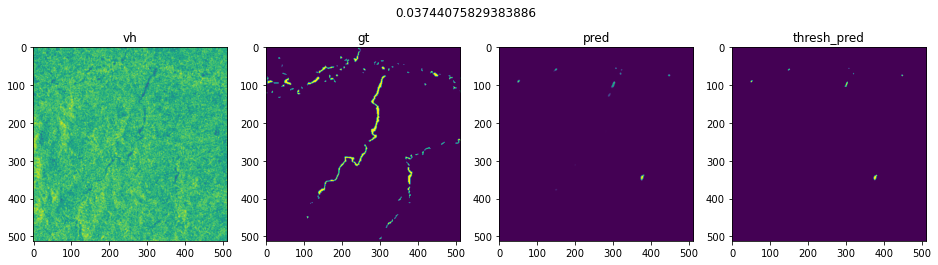

Epoch 20/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6225 - mae: 0.0626 - accuracy: 0.9444 - val_loss: 0.7491 - val_mae: 0.0783 - val_accuracy: 0.9295

Epoch 00020: val_loss did not improve from 0.71215


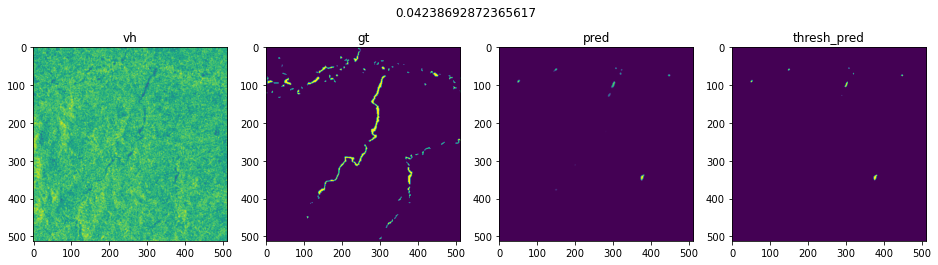

Epoch 21/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6399 - mae: 0.0701 - accuracy: 0.9385 - val_loss: 0.7517 - val_mae: 0.0785 - val_accuracy: 0.9296

Epoch 00021: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00021: val_loss did not improve from 0.71215


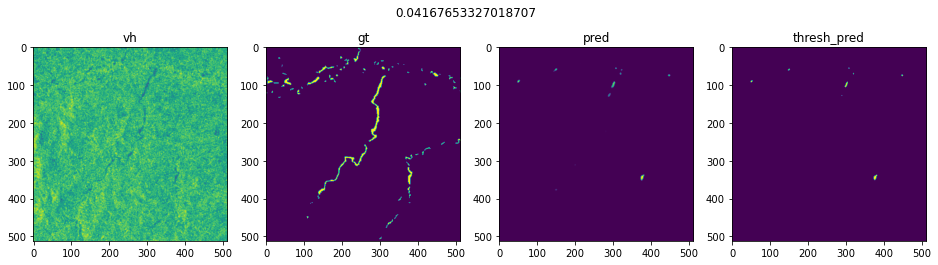

Epoch 22/70
108/108 [==============================] - 75s 691ms/step - loss: 0.6267 - mae: 0.0616 - accuracy: 0.9466 - val_loss: 0.7362 - val_mae: 0.0783 - val_accuracy: 0.9299

Epoch 00022: val_loss did not improve from 0.71215


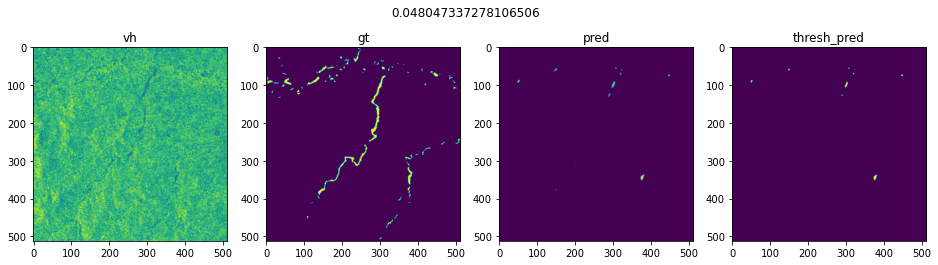

Epoch 23/70
108/108 [==============================] - 75s 693ms/step - loss: 0.5928 - mae: 0.0565 - accuracy: 0.9529 - val_loss: 0.7341 - val_mae: 0.0781 - val_accuracy: 0.9300

Epoch 00023: val_loss did not improve from 0.71215


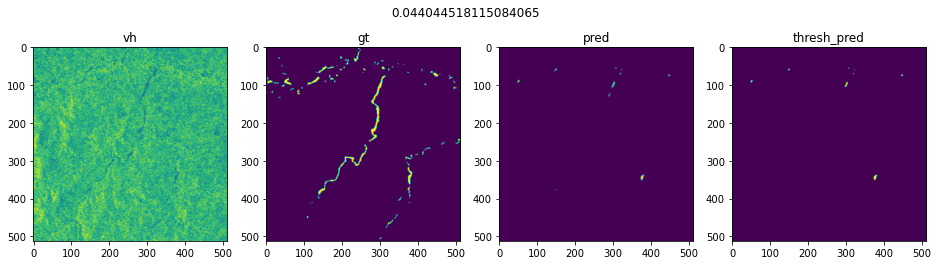

Epoch 24/70
108/108 [==============================] - 75s 692ms/step - loss: 0.6659 - mae: 0.0668 - accuracy: 0.9403 - val_loss: 0.7206 - val_mae: 0.0774 - val_accuracy: 0.9307

Epoch 00024: val_loss did not improve from 0.71215


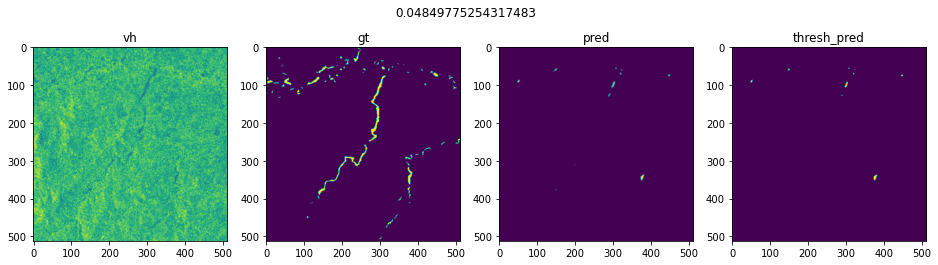

Epoch 25/70
108/108 [==============================] - 75s 689ms/step - loss: 0.6406 - mae: 0.0656 - accuracy: 0.9411 - val_loss: 0.7273 - val_mae: 0.0778 - val_accuracy: 0.9304

Epoch 00025: val_loss did not improve from 0.71215


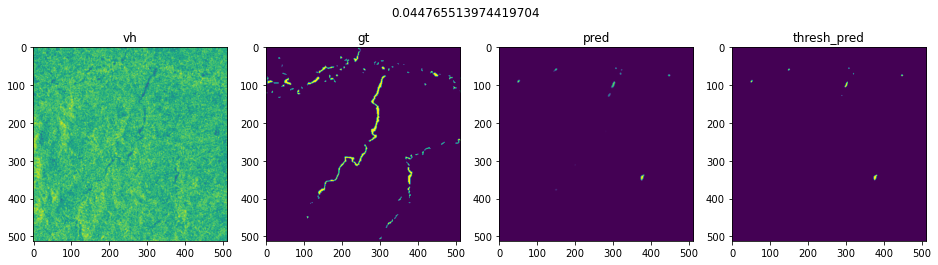

Epoch 26/70
108/108 [==============================] - 74s 687ms/step - loss: 0.5612 - mae: 0.0533 - accuracy: 0.9543 - val_loss: 0.7270 - val_mae: 0.0782 - val_accuracy: 0.9300

Epoch 00026: ReduceLROnPlateau reducing learning rate to 1e-06.

Epoch 00026: val_loss did not improve from 0.71215


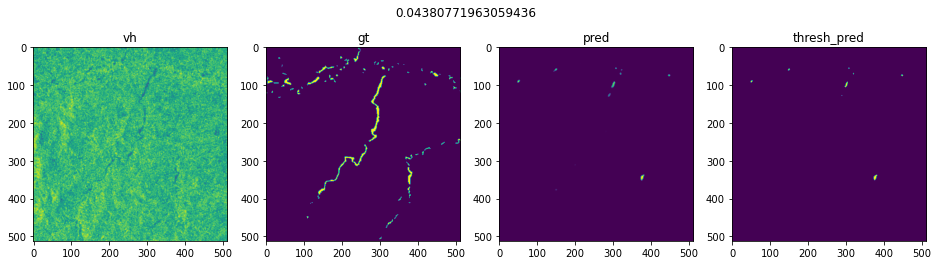

Epoch 27/70
108/108 [==============================] - 75s 690ms/step - loss: 0.5705 - mae: 0.0568 - accuracy: 0.9523 - val_loss: 0.7294 - val_mae: 0.0783 - val_accuracy: 0.9300

Epoch 00027: val_loss did not improve from 0.71215


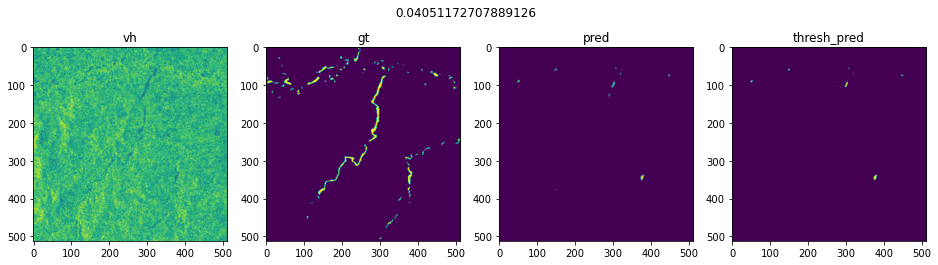

Epoch 28/70
108/108 [==============================] - 74s 689ms/step - loss: 0.6148 - mae: 0.0600 - accuracy: 0.9472 - val_loss: 0.7303 - val_mae: 0.0778 - val_accuracy: 0.9302

Epoch 00028: val_loss did not improve from 0.71215


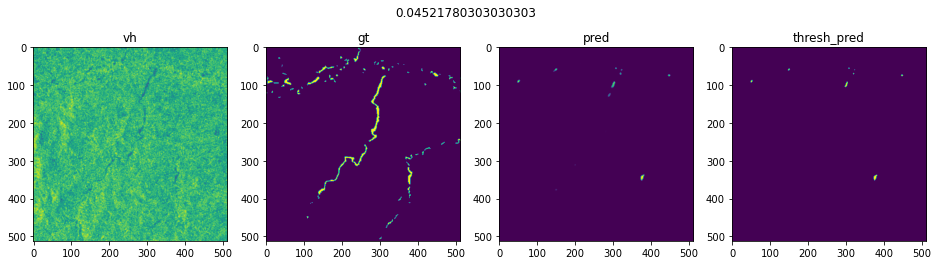

Epoch 29/70
108/108 [==============================] - 75s 689ms/step - loss: 0.5944 - mae: 0.0578 - accuracy: 0.9487 - val_loss: 0.7317 - val_mae: 0.0783 - val_accuracy: 0.9299

Epoch 00029: val_loss did not improve from 0.71215


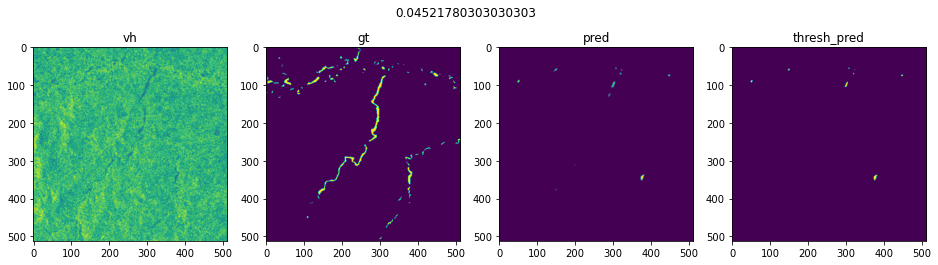

Epoch 30/70
108/108 [==============================] - 75s 693ms/step - loss: 0.6546 - mae: 0.0635 - accuracy: 0.9432 - val_loss: 0.7477 - val_mae: 0.0794 - val_accuracy: 0.9290

Epoch 00030: val_loss did not improve from 0.71215


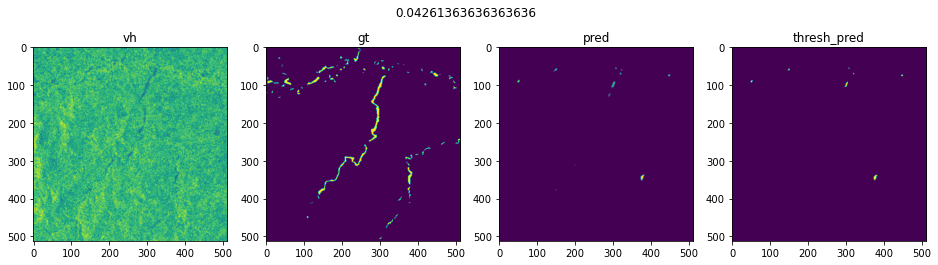

Epoch 31/70
108/108 [==============================] - 75s 691ms/step - loss: 0.5524 - mae: 0.0524 - accuracy: 0.9535 - val_loss: 0.7406 - val_mae: 0.0793 - val_accuracy: 0.9288

Epoch 00031: val_loss did not improve from 0.71215


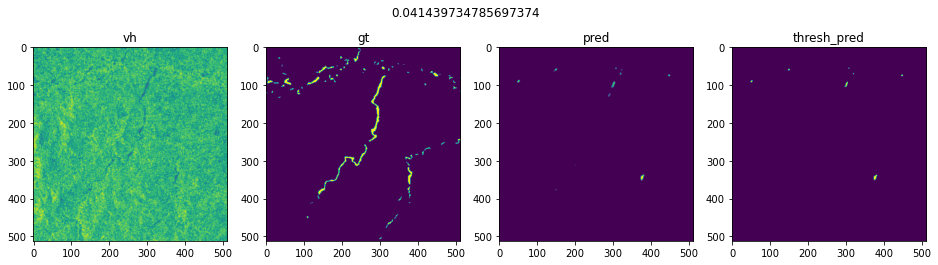

Epoch 00031: early stopping


In [61]:
k = 0

for train_x, val_x in StratifiedKFold(n_splits=5).split(meta.chip_id.values, meta.location):
    
    train_files = meta.chip_id.iloc[train_x].values
    val_files = meta.chip_id.iloc[val_x].values
    
    K.clear_session()

    model = sm.Unet('efficientnetb4', input_shape=(INP_SHAPE, INP_SHAPE, N_CHANNELS), 
                    encoder_weights=None, weights=None)
    
    metrics = ['mae', 'accuracy']
    model.compile(optimizer=Adam(), loss=bce_jaccard_loss, metrics=metrics)
    
    checkpoint_path = 'unet_models/EfficientB4Unet_{}_{}_{}.h5'.format(INP_SHAPE, N_CHANNELS, k)
    k += 1
    
    callbacks = [
        EarlyStopping(patience=15, verbose=1),
        ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.000001, verbose=1),
        ModelCheckpoint(filepath=checkpoint_path, verbose=1, save_best_only=True, save_weights_only=False),
        LambdaCallback(on_epoch_end=plot_preds)
    ]
    
    train_datagen = CustomDataGen(train_files, channels=N_CHANNELS, 
                                  input_shape=INP_SHAPE, batch_size=BATCH_SIZE)
    val_datagen = CustomDataGen(val_files, channels=N_CHANNELS, 
                                input_shape=INP_SHAPE, batch_size=BATCH_SIZE, augment=False)
    
    results = model.fit(train_datagen, validation_data=val_datagen,
                        epochs=70, callbacks=callbacks)

# Testing

## Functions

In [62]:
def plot_val(path, models, plot=True):
    
    with rasterio.open(train_features / '{}_vv.tif'.format(path)) as fvv:
        vv = fvv.read(1)
    with rasterio.open(train_features / '{}_vh.tif'.format(path)) as fvh:
        vh = fvh.read(1)
    with rasterio.open(train_features / '{}_nasadem.tif'.format(path)) as nasadem_:
        nasadem = nasadem_.read(1)
                        
    X = np.zeros((INP_SHAPE, INP_SHAPE, 3))
    X[:, :, 0] = (vh - (-17.54)) / 5.15
    X[:, :, 1] = (vv - (-10.68)) / 4.62
    X[:, :, 2] = (nasadem - (166.47)) / 178.47
        
    mask = process_mask(gdal.Open(str(train_labels / '{}.tif'.format(path))).ReadAsArray())
    
    preds = []
    
    for model in models:
        pred = model.predict(X[np.newaxis, :, :, :])[0, :, :, 0]
        preds.append(pred)
        
    pred = np.mean(preds, axis=0)
        
    pred_thresh = pred.copy()
    pred_thresh[pred_thresh > 0.5] = 1
    pred_thresh[pred_thresh <= 0.5] = 0
    pred_thresh = pred_thresh.astype(int)
    
    if plot:
        _, ax = plt.subplots(1, 4, figsize=(16, 4))
    
        ax[0].imshow(X[:, :, 0])
        ax[0].set_title('vh')
        ax[1].imshow(mask)
        ax[1].set_title('gt')
        ax[2].imshow(pred)
        ax[2].set_title('pred')
        ax[3].imshow(pred_thresh)
        ax[3].set_title('thresh_pred')
        if mask.sum() == 0 and pred_thresh.sum() == 0:
            iou = 1
        else:
            intersection = np.logical_and(mask, pred_thresh).sum()
            union = np.logical_or(mask, pred_thresh).sum()
            iou = intersection / union
        plt.suptitle(iou)
        plt.show()
    
    return pred, mask

## Let's test it

In [63]:
models_simple = []

models_simple.append(load_model('unet_models/EffUnetB0_512_3.h5', 
                                custom_objects={'FixedDropout': Dropout,
                                                'bce_jaccard_loss': bce_jaccard_loss}))
                     
models_simple.append(load_model('unet_models/EffUnetB0_512_3_weak_1.h5', 
                                custom_objects={'FixedDropout': Dropout,
                                                'bce_jaccard_loss': bce_jaccard_loss}))

In [64]:
models_skf = []

for i in range(5):
    models_skf.append(load_model('unet_models/EfficientB4Unet_512_3_{}.h5'.format(i), 
                                 custom_objects={'FixedDropout': Dropout,
                                                 'bce_jaccard_loss': bce_jaccard_loss}))

In [ ]:
for f in pd.Series(filenames).sample(10).values:
    
    print('first models')
    pred_1, _ = plot_val(f, models_simple)
    
    print('skf models')
    pred_2, mask  = plot_val(f, models_skf)
    
    pred_all = np.mean([pred_1, pred_2], axis=0)
    pred_thresh = pred_all.copy()
    pred_thresh[pred_thresh > 0.5] = 1
    pred_thresh[pred_thresh <= 0.5] = 0
    pred_thresh = pred_thresh.astype(int)
    
    print('all models')
    _, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].imshow(mask)
    ax[0].set_title('gt')
    ax[1].imshow(pred_thresh)
    ax[1].set_title('thresh_pred_all')
    if mask.sum() == 0 and pred_thresh.sum() == 0:
        iou = 1
    else:
        intersection = np.logical_and(mask, pred_thresh).sum()
        union = np.logical_or(mask, pred_thresh).sum()
        iou = intersection / union
    plt.suptitle(iou)
    plt.show()
    
    print('\n<–––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––>\n')

In [66]:
intersection = 0
union = 0
ious = []

for f in tqdm(filenames):
    
    pred_1, _ = plot_val(f, models_simple, plot=False)
    pred_2, mask  = plot_val(f, models_skf, plot=False)
    
    pred_all = np.mean([pred_1, pred_2], axis=0)
    
    pred_thresh = pred_all.copy()
    pred_thresh[pred_thresh > 0.5] = 1
    pred_thresh[pred_thresh <= 0.5] = 0
    pred_thresh = pred_thresh.astype(int)

    intersection += np.logical_and(mask, pred_thresh).sum()
    union += np.logical_or(mask, pred_thresh).sum()

    ious.append(intersection / union)

100%|██████████| 542/542 [03:54<00:00,  2.31it/s]


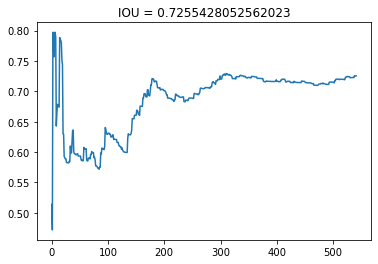

In [67]:
plt.plot(ious)
plt.title('IOU = ' + str(ious[-1]))
plt.show()

# Save some predictions to compare and combine them with CatBoost predictions

In [ ]:
Path("result_for_compare").mkdir(parents=True, exist_ok=True)

In [68]:
compare_files = []
compare_paths = []

for f in tqdm(pd.Series(filenames).sample(20).values):
    
    pred_1, _ = plot_val(f, models_simple, plot=False)
    pred_2, mask  = plot_val(f, models_skf, plot=False)
    
    pred_all = np.mean([pred_1, pred_2], axis=0)
    
    compare_files.append(f)
    compare_paths.append('result_for_compare/unet_'+f)
    np.save('result_for_compare/unet_'+f, pred_all)

100%|██████████| 20/20 [00:08<00:00,  2.34it/s]


In [69]:
compare_df = pd.DataFrame()
compare_df['files'] = compare_files
compare_df['unet_path'] = compare_paths
compare_df.to_csv('compare_df.csv', index=False)